# COVID-19 risk factors using TF-IDF

Approach:
1. Take title, abstract and text to cteate documnet
2. Simple preprocessing of documents
3. Find key words for each document. 
4. Calculate key words for each query sentence.
5. Calculate distance between query sentence and each document and select closest match as result


# Load libraries

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import json
import math
import glob

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from nltk.stem.snowball import SnowballStemmer
from scipy.spatial import distance
from matplotlib import pyplot as plt
from wordcloud import WordCloud
import ipywidgets as widgets

from IPython.display import Image
from IPython.display import display, HTML

# Load data into DF
In this part we will load data from both summary csv file and all availiable text / abstracts from additional .json files

In [2]:
root_dir = '/kaggle/input/CORD-19-research-challenge'
#root_dir = 'CORD-19-research-challenge/2020-03-13'

In [3]:
df = pd.read_csv(f'{root_dir}/metadata.csv')
doc_paths = glob.glob(f'{root_dir}/*/*/*.json')
df.sha.fillna("", inplace=True)

#get text for articles that are available
def get_text(sha):
    if sha == "":
        return ""
    document_path = [x for x in doc_paths if sha in x]
    if not document_path:
        return ""
    with open(document_path[0]) as f:
        file = json.load(f)
        full_text = []
        #iterate over abstract and body part
        for part in ['abstract', 'body_text']:
            # iterate over each paragraph
            for text_part in file[part]:
                text = text_part['text']
                # remove citations from each paragraph
                for citation in text_part['cite_spans']:
                    text = text.replace(citation['text'], "")
                full_text.append(text)
            
        return str.join(' ', full_text)
%time df['text'] = df.apply(lambda x: get_text(x.sha), axis=1)

CPU times: user 2min 53s, sys: 7.15 s, total: 3min
Wall time: 3min 55s


# Preprocessing data

preprocess text. First change all letters to lower case, then we apply stemming and remove stopwords afterwards. 

(note) Lemmatization is also valid approach, and might increase accuracy later on, but it could also reduce accuracy. 

In [4]:
analyzer = CountVectorizer().build_analyzer()
stemmer = SnowballStemmer("english")

def preprocess(doc):
    doc=doc.lower()
    return str.join(" ", [stemmer.stem(w) for w in analyzer(doc)])

def preprocess_row(row):
    text = str.join(' ', [str(row.title), str(row.abstract), str(row.text)])
    return preprocess(text)

%time df['preprocessed'] = df.apply(lambda x: preprocess_row(x), axis=1)

CPU times: user 48min 12s, sys: 10.1 s, total: 48min 22s
Wall time: 48min 21s


# Apply TF-IDF
Calculate number of words then use TF_IDF approach.
- TF(w) = (Number of times term w appears in a document) / (Total number of terms in the document)
- IDF(w) = log_e(Total number of documents / Number of documents with term w in it)

In [5]:
cv = CountVectorizer(max_df=0.95, stop_words='english')
%time word_count = cv.fit_transform(df.preprocessed)
tfidf_tr = TfidfTransformer(smooth_idf=True, use_idf=True)
%time tfidf_tr.fit(word_count)

CPU times: user 2min 36s, sys: 657 ms, total: 2min 37s
Wall time: 2min 37s
CPU times: user 181 ms, sys: 38 ms, total: 219 ms
Wall time: 219 ms


TfidfTransformer(norm='l2', smooth_idf=True, sublinear_tf=False, use_idf=True)

create word vector for all documents

In [6]:
def get_word_vector(document):
    w_vector = tfidf_tr.transform(cv.transform([document]))
    return w_vector 

%time df['word_vector'] = df.preprocessed.apply(get_word_vector)

CPU times: user 8min 23s, sys: 1.06 s, total: 8min 24s
Wall time: 8min 24s


calcululate distance between each document and the searching document(phrase) using only words that were in query documnet(phrase)

# Calculate distance between searching phrase and each document

In [7]:
def show_word_cloud(word_vector):
    cloud = WordCloud(background_color='white',
        width=500,
        height=500,
        max_words=20,
        colormap='tab10',
        prefer_horizontal=1.0)
    word_frequency = dict(get_words_with_value(word_vector))
    cloud.generate_from_frequencies(word_frequency)
    plt.gca().imshow(cloud)
    plt.gca().axis('off')

feature_names = cv.get_feature_names()
def get_words_with_value(w_vector):
    return sorted([(feature_names[ind], val) for ind, val in zip(w_vector.indices, w_vector.data)], key=lambda x: x[1], reverse=True)

In [8]:
def calculate_distance_between_words_vectors(search_words_indices, search_vec, document_vector):
    document_vec = document_vector[0, search_words_indices].toarray()
    return distance.euclidean(search_vec, document_vec)

def get_related_documents(text, number_of_documents):    
    search_vector = get_word_vector(preprocess(text))
    search_words_indices = search_vector.indices
    search_vec = search_vector[0, search_words_indices].toarray()
    distance_idx = df.apply(lambda x: calculate_distance_between_words_vectors(search_words_indices, search_vec, x.word_vector), axis=1)
    relevant_indexes = distance_idx.sort_values().head(number_of_documents).index 
    result_columns = ["title", "doi", "pmcid", "pubmed_id", "license", "authors", "word_vector"]
    result = df[result_columns].iloc[relevant_indexes].fillna("")
    return result

# Results

In [9]:
tasks = {
    "What is known about transmission, incubation, and environmental stability?" :
    [
        "Range of incubation periods for the disease in humans (and how this varies across age and health status) and how long individuals are contagious, even after recovery.",
        "Prevalence of asymptomatic shedding and transmission (e.g., particularly children).",
        "Seasonality of transmission.",
        "Physical science of the coronavirus (e.g., charge distribution, adhesion to hydrophilic/phobic surfaces, environmental survival to inform decontamination efforts for affected areas and provide information about viral shedding).",
        "Persistence and stability on a multitude of substrates and sources (e.g., nasal discharge, sputum, urine, fecal matter, blood).",
        "Persistence of virus on surfaces of different materials (e,g., copper, stainless steel, plastic).",
        "Natural history of the virus and shedding of it from an infected person",
        "Implementation of diagnostics and products to improve clinical processes",
        "Disease models, including animal models for infection, disease and transmission",
        "Tools and studies to monitor phenotypic change and potential adaptation of the virus",
        "Immune response and immunity",
        "Effectiveness of movement control strategies to prevent secondary transmission in health care and community settings",
        "Effectiveness of personal protective equipment (PPE) and its usefulness to reduce risk of transmission in health care and community settings",
        "Role of the environment in transmission"
    ],
    "What do we know about COVID-19 risk factors?":
    [
        "Data on potential risks factors",
        "Smoking, pre-existing pulmonary disease",
        "Co-infections (determine whether co-existing respiratory/viral infections make the virus more transmissible or virulent) and other co-morbidities",
        "Neonates and pregnant women",
        "Socio-economic and behavioral factors to understand the economic impact of the virus and whether there were differences.",
        "Transmission dynamics of the virus, including the basic reproductive number, incubation period, serial interval, modes of transmission and environmental factors",
        "Severity of disease, including risk of fatality among symptomatic hospitalized patients, and high-risk patient groups",
        "Susceptibility of populations",
        "Public health mitigation measures that could be effective for control"
    ],
    "What do we know about virus genetics, origin, and evolution?":
    [
        "Real-time tracking of whole genomes and a mechanism for coordinating the rapid dissemination of that information to inform the development of diagnostics and therapeutics and to track variations of the virus over time.",
        "Access to geographic and temporal diverse sample sets to understand geographic distribution and genomic differences, and determine whether there is more than one strain in circulation. Multi-lateral agreements such as the Nagoya Protocol could be leveraged.",
        "Evidence that livestock could be infected (e.g., field surveillance, genetic sequencing, receptor binding) and serve as a reservoir after the epidemic appears to be over.",
        "Evidence of whether farmers are infected, and whether farmers could have played a role in the origin.",
        "Surveillance of mixed wildlife- livestock farms for SARS-CoV-2 and other coronaviruses in Southeast Asia.",
        "Experimental infections to test host range for this pathogen.",
        "Animal host(s) and any evidence of continued spill-over to humans",
        "Socioeconomic and behavioral risk factors for this spill-over",
        "Sustainable risk reduction strategies"
    ],
    "What do we know about vaccines and therapeutics?":
    [
        "Effectiveness of drugs being developed and tried to treat COVID-19 patients.",
        "Clinical and bench trials to investigate less common viral inhibitors against COVID-19 such as naproxen, clarithromycin, and minocyclinethat that may exert effects on viral replication.",
        "Methods evaluating potential complication of Antibody-Dependent Enhancement (ADE) in vaccine recipients.",
        "Exploration of use of best animal models and their predictive value for a human vaccine.",
        "Capabilities to discover a therapeutic (not vaccine) for the disease, and clinical effectiveness studies to discover therapeutics, to include antiviral agents.",
        "Alternative models to aid decision makers in determining how to prioritize and distribute scarce, newly proven therapeutics as production ramps up. This could include identifying approaches for expanding production capacity to ensure equitable and timely distribution to populations in need.",
        "Efforts targeted at a universal coronavirus vaccine.",
        "Efforts to develop animal models and standardize challenge studies",
        "Efforts to develop prophylaxis clinical studies and prioritize in healthcare workers",
        "Approaches to evaluate risk for enhanced disease after vaccination",
        "Assays to evaluate vaccine immune response and process development for vaccines, alongside suitable animal models [in conjunction with therapeutics],",
    ],
    "What do we know about diagnostics and surveillance?":
    [
        "How widespread current exposure is to be able to make immediate policy recommendations on mitigation measures. Denominators for testing and a mechanism for rapidly sharing that information, including demographics, to the extent possible. Sampling methods to determine asymptomatic disease (e.g., use of serosurveys (such as convalescent samples) and early detection of disease (e.g., use of screening of neutralizing antibodies such as ELISAs).",
        "Efforts to increase capacity on existing diagnostic platforms and tap into existing surveillance platforms.",
        "Recruitment, support, and coordination of local expertise and capacity (public, private—commercial, and non-profit, including academic), including legal, ethical, communications, and operational issues.",
        "National guidance and guidelines about best practices to states (e.g., how states might leverage universities and private laboratories for testing purposes, communications to public health officials and the public).",
        "Development of a point-of-care test (like a rapid influenza test) and rapid bed-side tests, recognizing the tradeoffs between speed, accessibility, and accuracy.",
        "Rapid design and execution of targeted surveillance experiments calling for all potential testers using PCR in a defined area to start testing and report to a specific entity. These experiments could aid in collecting longitudinal samples, which are critical to understanding the impact of ad hoc local interventions (which also need to be recorded).",
        "Separation of assay development issues from instruments, and the role of the private sector to help quickly migrate assays onto those devices.",
        "Efforts to track the evolution of the virus (i.e., genetic drift or mutations) and avoid locking into specific reagents and surveillance/detection schemes.",
        "Latency issues and when there is sufficient viral load to detect the pathogen, and understanding of what is needed in terms of biological and environmental sampling.",
        "Use of diagnostics such as host response markers (e.g., cytokines) to detect early disease or predict severe disease progression, which would be important to understanding best clinical practice and efficacy of therapeutic interventions.",
        "Policies and protocols for screening and testing.",
        "Policies to mitigate the effects on supplies associated with mass testing, including swabs and reagents.",
        "Technology roadmap for diagnostics.",
        "Barriers to developing and scaling up new diagnostic tests (e.g., market forces), how future coalition and accelerator models (e.g., Coalition for Epidemic Preparedness Innovations) could provide critical funding for diagnostics, and opportunities for a streamlined regulatory environment.",
        "New platforms and technology (e.g., CRISPR) to improve response times and employ more holistic approaches to COVID-19 and future diseases.",
        "Coupling genomics and diagnostic testing on a large scale.",
        "Enhance capabilities for rapid sequencing and bioinformatics to target regions of the genome that will allow specificity for a particular variant.",
        "Enhance capacity (people, technology, data) for sequencing with advanced analytics for unknown pathogens, and explore capabilities for distinguishing naturally-occurring pathogens from intentional.",
        "One Health surveillance of humans and potential sources of future spillover or ongoing exposure for this organism and future pathogens, including both evolutionary hosts (e.g., bats) and transmission hosts (e.g., heavily trafficked and farmed wildlife and domestic food and companion species), inclusive of environmental, demographic, and occupational risk factors."
    ],
    "What do we know about non-pharmaceutical interventions?":
    [
        "Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases.",
        "Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.",
        "Rapid assessment of the likely efficacy of school closures, travel bans, bans on mass gatherings of various sizes, and other social distancing approaches.",
        "Methods to control the spread in communities, barriers to compliance and how these vary among different populations.",
        "Models of potential interventions to predict costs and benefits that take account of such factors as race, income, disability, age, geographic location, immigration status, housing status, employment status, and health insurance status.",
        "Policy changes necessary to enable the compliance of individuals with limited resources and the underserved with NPIs.",
        "Research on why people fail to comply with public health advice, even if they want to do so (e.g., social or financial costs may be too high).",
        "Research on the economic impact of this or any pandemic. This would include identifying policy and programmatic alternatives that lessen/mitigate risks to critical government services, food distribution and supplies, access to critical household supplies, and access to health diagnoses, treatment, and needed care, regardless of ability to pay."
    ],
    "What has been published about medical care?":
    [
        "Resources to support skilled nursing facilities and long term care facilities.",
        "Mobilization of surge medical staff to address shortages in overwhelmed communities",
        "Age-adjusted mortality data for Acute Respiratory Distress Syndrome (ARDS) with/without other organ failure – particularly for viral etiologies",
        "Extracorporeal membrane oxygenation (ECMO) outcomes data of COVID-19 patients",
        "Outcomes data for COVID-19 after mechanical ventilation adjusted for age.",
        "Knowledge of the frequency, manifestations, and course of extrapulmonary manifestations of COVID-19, including, but not limited to, possible cardiomyopathy and cardiac arrest.",
        "Application of regulatory standards (e.g., EUA, CLIA) and ability to adapt care to crisis standards of care level.",
        "Approaches for encouraging and facilitating the production of elastomeric respirators, which can save thousands of N95 masks.",
        "Best telemedicine practices, barriers and faciitators, and specific actions to remove/expand them within and across state boundaries.",
        "Guidance on the simple things people can do at home to take care of sick people and manage disease.",
        "Oral medications that might potentially work.",
        "Use of AI in real-time health care delivery to evaluate interventions, risk factors, and outcomes in a way that could not be done manually.",
        "Best practices and critical challenges and innovative solutions and technologies in hospital flow and organization, workforce protection, workforce allocation, community-based support resources, payment, and supply chain management to enhance capacity, efficiency, and outcomes.",
        "Efforts to define the natural history of disease to inform clinical care, public health interventions, infection prevention control, transmission, and clinical trials",
        "Efforts to develop a core clinical outcome set to maximize usability of data across a range of trials",
        "Efforts to determine adjunctive and supportive interventions that can improve the clinical outcomes of infected patients (e.g. steroids, high flow oxygen)"
    ],
    "What has been published about information sharing and inter-sectoral collaboration?":
    [
        "Methods for coordinating data-gathering with standardized nomenclature.",
        "Sharing response information among planners, providers, and others.",
        "Understanding and mitigating barriers to information-sharing.",
        "How to recruit, support, and coordinate local (non-Federal) expertise and capacity relevant to public health emergency response (public, private, commercial and non-profit, including academic).",
        "Integration of federal/state/local public health surveillance systems.",
        "Value of investments in baseline public health response infrastructure preparedness",
        "Modes of communicating with target high-risk populations (elderly, health care workers).",
        "Risk communication and guidelines that are easy to understand and follow (include targeting at risk populations’ families too).",
        "Communication that indicates potential risk of disease to all population groups.",
        "Misunderstanding around containment and mitigation.",
        "Action plan to mitigate gaps and problems of inequity in the Nation’s public health capability, capacity, and funding to ensure all citizens in need are supported and can access information, surveillance, and treatment.",
        "Measures to reach marginalized and disadvantaged populations.",
        "Data systems and research priorities and agendas incorporate attention to the needs and circumstances of disadvantaged populations and underrepresented minorities.",
        "Mitigating threats to incarcerated people from COVID-19, assuring access to information, prevention, diagnosis, and treatment.",
        "Understanding coverage policies (barriers and opportunities) related to testing, treatment, and care"
    ],
    "What has been published about ethical and social science considerations?":
    [
        "Efforts to articulate and translate existing ethical principles and standards to salient issues in COVID-2019",
        "Efforts to embed ethics across all thematic areas, engage with novel ethical issues that arise and coordinate to minimize duplication of oversight",
        "Efforts to support sustained education, access, and capacity building in the area of ethics",
        "Efforts to establish a team at WHO that will be integrated within multidisciplinary research and operational platforms and that will connect with existing and expanded global networks of social sciences.",
        "Efforts to develop qualitative assessment frameworks to systematically collect information related to local barriers and enablers for the uptake and adherence to public health measures for prevention and control. This includes the rapid identification of the secondary impacts of these measures. (e.g. use of surgical masks, modification of health seeking behaviors for SRH, school closures)",
        "Efforts to identify how the burden of responding to the outbreak and implementing public health measures affects the physical and psychological health of those providing care for Covid-19 patients and identify the immediate needs that must be addressed.",
        "Efforts to identify the underlying drivers of fear, anxiety and stigma that fuel misinformation and rumor, particularly through social media.",
    ]
}

Helper functions for displaying everything

In [10]:
def display_friendly_results(df_result):
    display_columns = ["title", "doi", "pmcid", "pubmed_id", "authors"]
    display(df_result[display_columns].reset_index(drop=True))
    rows = math.ceil(len(df_result)/3)
    plt.rcParams["figure.figsize"] = (20,15)
    for i in range(len(df_result)):
        row = df_result.iloc[1]
        plt.subplot(rows, 3, i+1)
        show_word_cloud(row.word_vector)
        plt.title(f'Paper {i}', fontsize=20)
    plt.show()

def display_topics_results(task):
    for topic in tasks[task]:
        display(HTML(f"<h3>{topic}<h3>"))
        topic_result = get_related_documents(topic, 6)
        display_friendly_results(topic_result)

# What is known about transmission, incubation, and environmental stability?

,title,doi,pmcid,pubmed_id,authors
0,The influenza pandemic preparedness planning t...,10.1186/1471-2334-7-17,PMC1832202,1.73556e+07,"Eichner, Martin; Schwehm, Markus; Duerr, Hans-..."
1,Main factors influencing recovery in MERS Co-V...,10.1016/j.jiph.2019.03.020,,3.09797e+07,"John, Maya; Shaiba, Hadil"
2,Acceptability of community quarantine in conte...,10.1017/S0950268819001419,PMC6805739,,"Kpanake, Lonzozou; Leno, Jean-Pierre; Sorum, P..."
3,Model of epidemic control based on quarantine ...,10.1016/j.physa.2016.04.009,,,"Wang, Xingyuan; Zhao, Tianfang; Qin, Xiaomeng"
4,Beware of asymptomatic transmission: Study on ...,10.1101/2020.01.28.923169,,,"Shao, P.; Shan, Y."
5,Adaptive Contact Networks Change Effective Dis...,10.1371/journal.pcbi.1000895,PMC2924249,2.08089e+07,"Van Segbroeck, Sven; Santos, Francisco C.; Pac..."


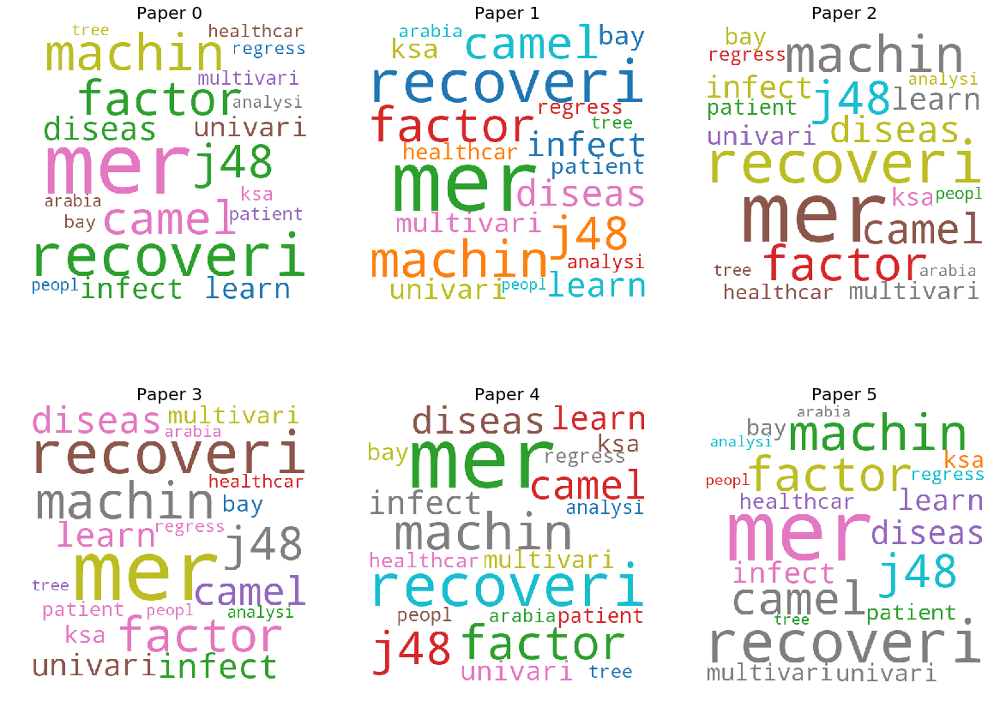

,title,doi,pmcid,pubmed_id,authors
0,Detection of Respiratory Viruses in Asymptomat...,10.1002/pbc.24314,PMC3502722,,"Srinivasan, Ashok; Flynn, Patricia; Gu, Zhengm..."
1,Carriage of Mycoplasma pneumoniae in the Upper...,10.1371/journal.pmed.1001444,PMC3653782,2.36908e+07,"Spuesens, Emiel B. M.; Fraaij, Pieter L. A.; V..."
2,Respiratory Pathogens in Children with and wit...,10.1016/j.jpeds.2008.08.036,,1.88239e+07,"van der Zalm, Marieke M.; van Ewijk, Bart E.; ..."
3,Respiratory syncytial virus evaluation among a...,10.1111/irv.12518,PMC5907818,2.9078e+07,"Moreira, Luciana Peniche; Watanabe, Aripuana S..."
4,Detection of respiratory viruses in gargle spe...,10.1016/j.jcv.2015.01.006,,2.57281e+07,"Morikawa, Saeko; Hiroi, Satoshi; Kase, Tetsuo"
5,Estimating the Asymptomatic Ratio of Norovirus...,10.2188/jea.JE20170040,PMC6111106,2.96079e+07,"Miura, Fuminari; Matsuyama, Ryota; Nishiura, H..."


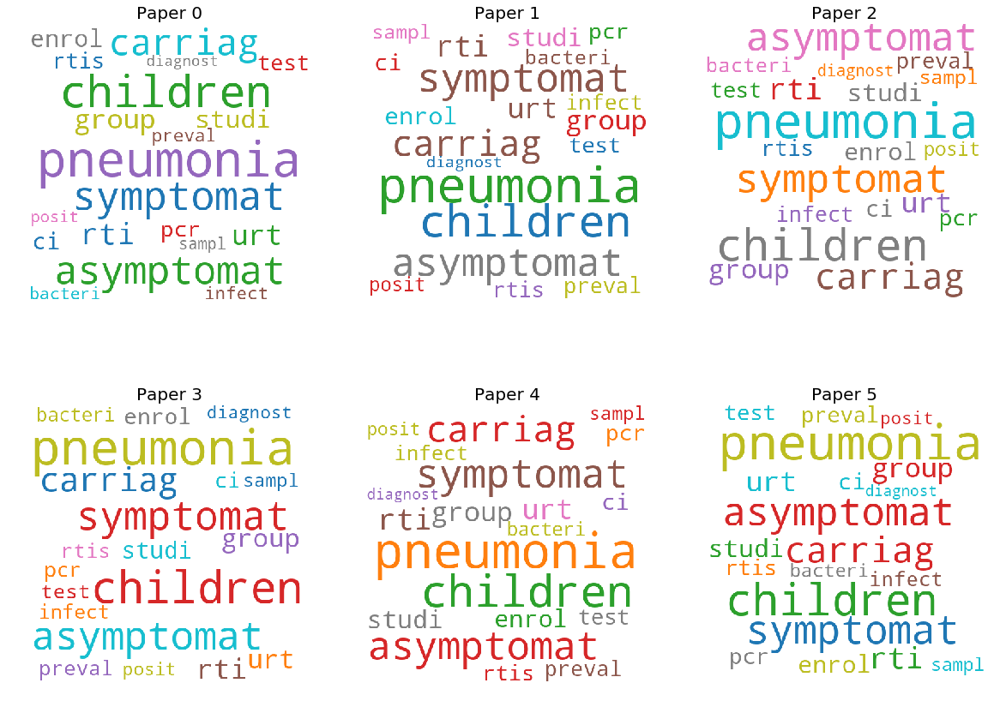

,title,doi,pmcid,pubmed_id,authors
0,The calendar of epidemics: Seasonal cycles of ...,10.1371/journal.ppat.1007327,PMC6224126,3.04081e+07,"Martinez, Micaela Elvira"
1,O.7.5 Human bocavirus infections have seasonal...,10.1016/S1386-6532(08)70060-X,,,"Waris, M.; Ylinen, T.; Ruuskanen, O.; Heikkine..."
2,Potential impact of seasonal forcing on a SARS...,10.1101/2020.02.13.20022806,,,Richard A Neher; Robert Dyrdak; Valentin Druel...
3,Smallpox and Season: Reanalysis of Historical ...,10.1155/2009/591935,PMC2648660,1.92661e+07,"Nishiura, Hiroshi; Kashiwagi, Tomoko"
4,Potential impact of seasonal forcing on a SARS...,10.4414/smw.2020.20224,,,"Neher, Richard A.; Dyrdak, Robert; Druelle, Va..."
5,Lack of seasonal variation of Middle East Resp...,10.1016/j.tmaid.2018.09.002,,3.02187e+07,"Al-Tawfiq, Jaffar A.; Memish, Ziad A."


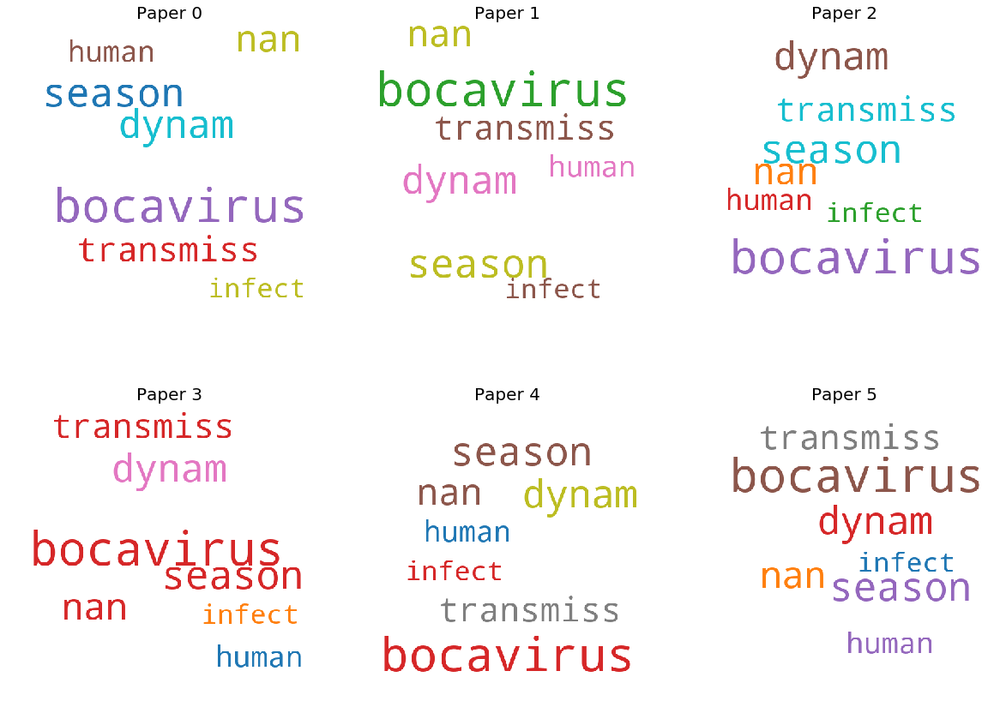

,title,doi,pmcid,pubmed_id,authors
0,Study of the mental health status of medical p...,10.1101/2020.03.04.20030973,,,ning sun; jun xing; jun xu; ling shu geng; qia...
1,Generic aspects of the airborne spread of huma...,10.1016/j.ajic.2016.06.008,,2.75907e+07,"Ijaz, M. Khalid; Zargar, Bahram; Wright, Kathr..."
2,Assessing microbial decontamination of indoor ...,10.1016/j.ajic.2016.06.009,,2.75907e+07,"Duchaine, Caroline"
3,Microbicides and the environmental control of ...,10.1016/j.jhin.2003.12.033,,1.51101e+07,"Sattar, S.A"
4,Elimination of Porcine Epidemic Diarrhea Virus...,10.1371/journal.pone.0169612,PMC5242487,2.80995e+07,"Huss, Anne R.; Schumacher, Loni L.; Cochrane, ..."
5,Chapter 67 Emergency Department Design,10.1016/B978-0-323-03253-7.50074-1,,,"Woolard, Robert H."


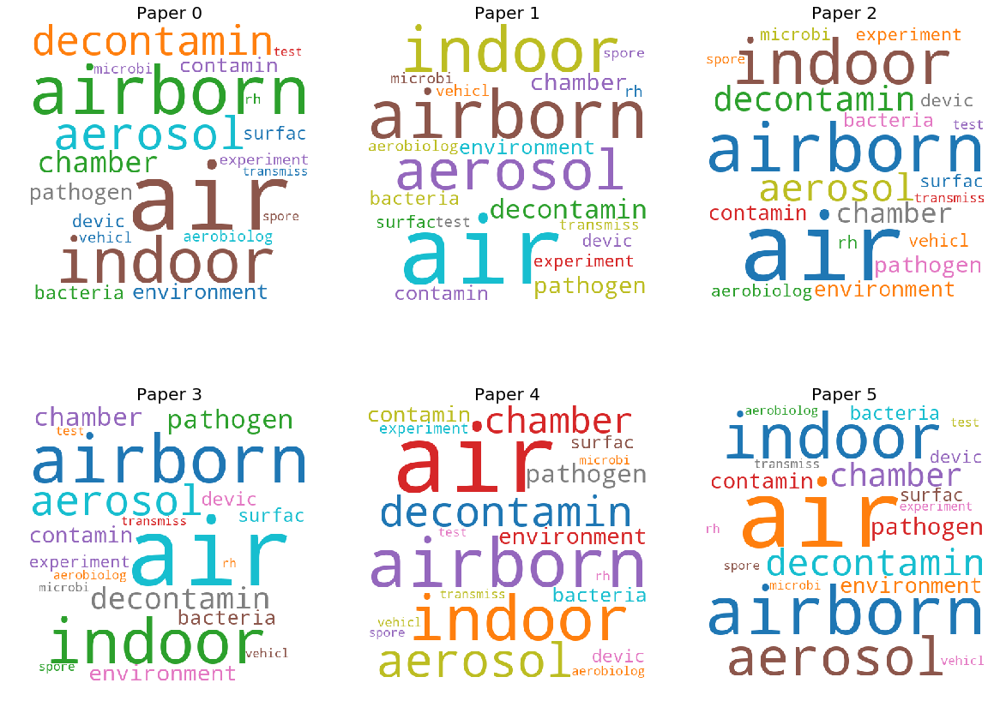

,title,doi,pmcid,pubmed_id,authors
0,Detection of HIV-1 RNA/DNA and CD4 mRNA in fec...,10.1186/1742-6405-6-20,PMC2761414,1.97998e+07,"Chakrabarti, Ayan K; Caruso, Lori; Ding, Ming;..."
1,Section 3 Clinical Signs,10.1016/B978-1-4377-0798-4.00003-7,,,"Ford, Richard B.; Mazzaferro, Elisa M."
2,The clinical impact of the detection of potent...,10.1016/j.diagmicrobio.2015.08.001,,2.63417e+07,"Gelfer, Gita; Leggett, James; Myers, Jillian; ..."
3,The potential of molecular diagnostics and ser...,10.1016/j.diagmicrobio.2016.06.008,,2.73777e+07,"Gilbert, David; Gelfer, Gita; Wang, Lian; Myer..."
4,Section 3 Clinical Signs,10.1016/B0-72-160138-3/50004-7,,,"Ford, Richard B.; Mazzaferro, Elisa M."
5,SARS Coronavirus Detection Methods,10.3201/eid1107.041045,PMC3371792,1.60228e+07,"Lau, Susanna K.P.; Che, Xiao-Yan; Woo, Patrick..."


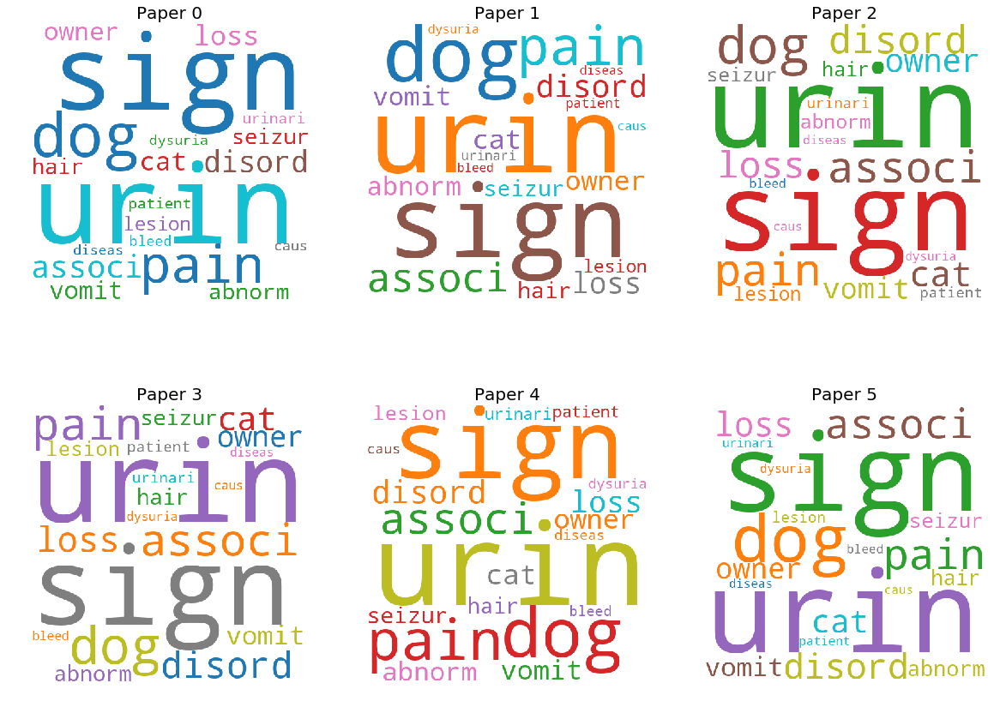

,title,doi,pmcid,pubmed_id,authors
0,Inactivation of Murine Norovirus on a Range of...,10.1128/AEM.03280-14,PMC4292492,,"Warnes, Sarah L.; Summersgill, Emma N.; Keevil..."
1,Human Coronavirus 229E Remains Infectious on C...,10.1128/mBio.01697-15,PMC4659470,2.65563e+07,"Warnes, Sarah L.; Little, Zoë R.; Keevil, C. W..."
2,Survival of porcine epidemic diarrhea virus (P...,10.1186/s40813-017-0064-3,PMC5604292,2.89324e+07,"Trudeau, Michaela P.; Verma, Harsha; Urriola, ..."
3,Sampling methods for recovery of human enteric...,10.1016/j.jviromet.2017.06.008,,2.8634e+07,"Turnage, Nicole L.; Gibson, Kristen E."
4,Inactivation of an enterovirus by airborne dis...,10.1186/1471-2334-13-177,PMC3636024,2.3587e+07,"Thevenin, Thomas; Lobert, Pierre-Emmanuel; Hob..."
5,Copper Alloy Touch Surfaces in Healthcare Faci...,10.3390/ma11122479,PMC6317222,3.05633e+07,"Colin, Marius; Klingelschmitt, Flora; Charpent..."


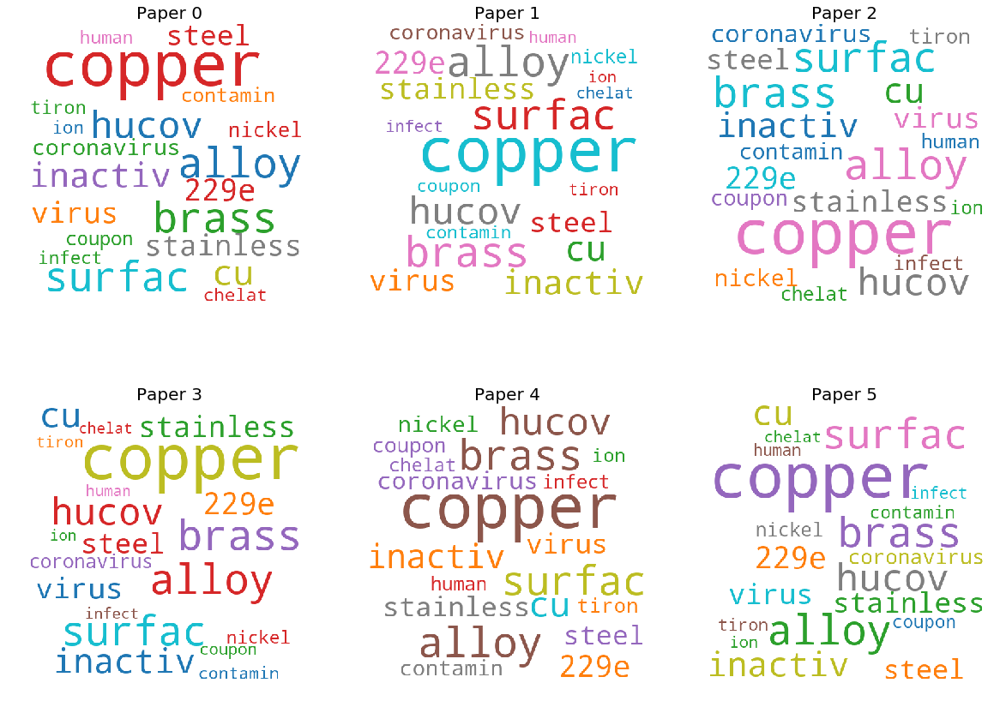

,title,doi,pmcid,pubmed_id,authors
0,Viral shedding and clinical illness in natural...,10.1086/652241,PMC3060408,,"Lau, Lincoln L. H.; Cowling, Benjamin J.; Fang..."
1,Nonpharmaceutical Interventions for Pandemic I...,10.3201/eid1201.051370,PMC3291414,1.64947e+07,
2,Pathogenesis of feline enteric coronavirus inf...,10.1016/j.jfms.2008.02.006,,1.85386e+07,"Pedersen, Niels C.; Allen, Claire E.; Lyons, L..."
3,Some One Health based control strategies for t...,10.1016/j.onehlt.2019.100102,PMC6715958,3.14855e+07,"Hemida, Maged Gomaa; Alnaeem, Abdelmohsen"
4,Comparison of respiratory virus shedding by co...,10.1016/j.cmi.2015.12.012,PMC4994888,2.67114e+07,"Richardson, L.; Brite, J.; Del Castillo, M.; C..."
5,"Influence of age, severity of infection, and c...",10.1017/S0950268814001393,PMC4411640,2.49014e+07,"MUNYWOKI, P. K.; KOECH, D. C.; AGOTI, C. N.; K..."


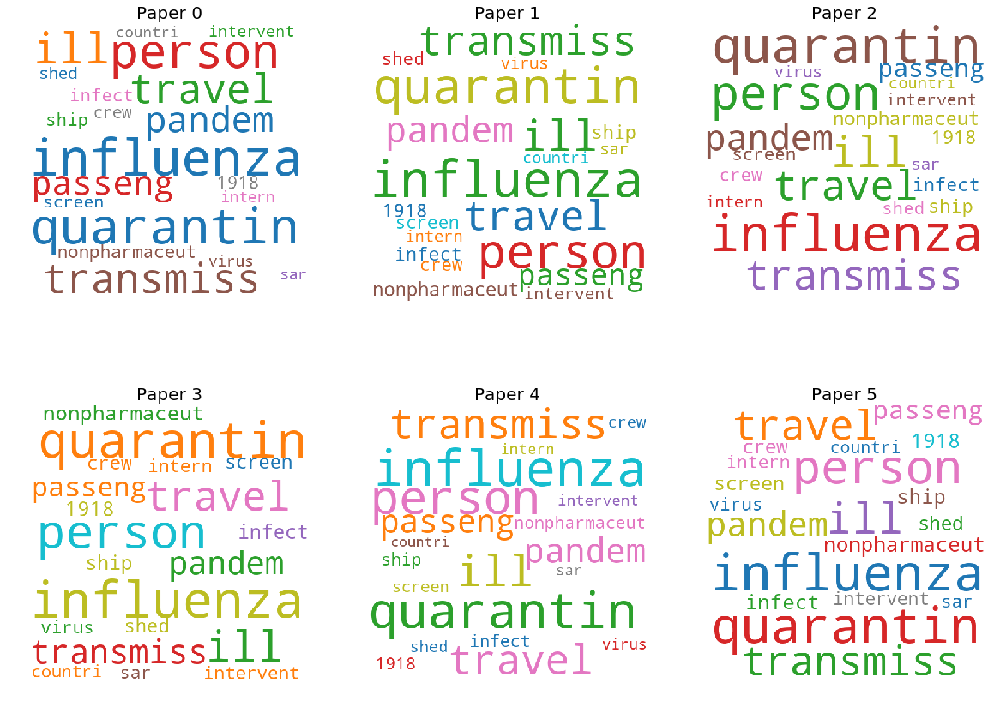

,title,doi,pmcid,pubmed_id,authors
0,"Standardisation and controls, why can’t we ove...",10.1016/j.jcv.2004.06.008,,1.53643e+07,"Niesters, Hubert G.M.; Puchhammer-Stöckl, Elis..."
1,Impact of the implementation of a respiratory ...,10.1016/j.jcv.2015.07.028,,,"De Keukeleire, S.; Descheemaeker, P.; Devinck,..."
2,O486 Implementation of a real-time RT-PCR assa...,10.1016/S0924-8579(07)70330-8,,,"Dumoulin, A.; Marti, H.P.; Panning, M.; Hirsch..."
3,Importance of diagnostics in epidemic and pand...,10.1136/bmjgh-2018-001179,PMC6362765,3.08153e+07,"Kelly-Cirino, Cassandra D; Nkengasong, John; K..."
4,Fading vision: knowledge translation in the im...,10.1186/1748-5908-8-59,PMC3680003,2.37347e+07,"Tomm-Bonde, Laura; Schreiber, Rita S; Allan, D..."
5,"Better Tests, Better Care: Improved Diagnostic...",10.1093/cid/cit578,PMC3820169,,"Caliendo, Angela M.; Gilbert, David N.; Ginocc..."


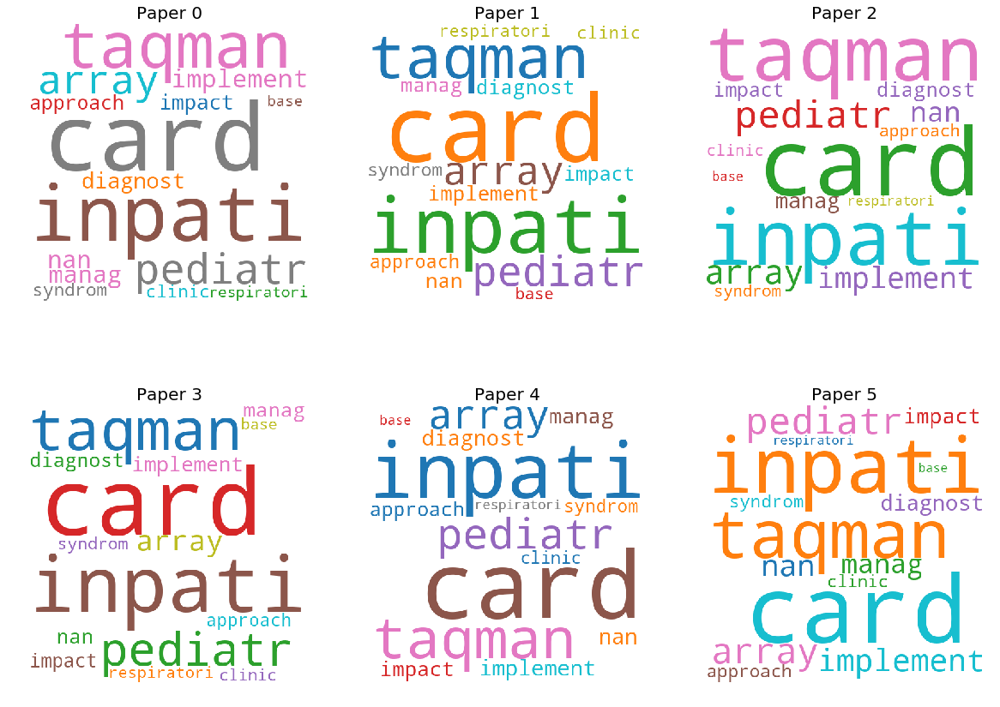

,title,doi,pmcid,pubmed_id,authors
0,The Benefits of Transmission Dynamics Models i...,10.1097/MAJ.0b013e3181e937ca,,2.06973e+07,"Wendelboe, Aaron M.; Grafe, Carl; Carabin, Hélène"
1,Animal models for highly pathogenic emerging v...,10.1016/j.coviro.2013.01.001,PMC3644300,,"Safronetz, David; Geisbert, Thomas W; Feldmann..."
2,Mathematical epidemiology is not an oxymoron,10.1186/1471-2458-9-S1-S2,PMC2779504,1.99227e+07,"Brauer, Fred"
3,Dynamic Transmission Modeling: A Report of the...,10.1016/j.jval.2012.06.011,,2.29991e+07,"Pitman, Richard; Fisman, David; Zaric, Gregory..."
4,The development and application of Laboratory ...,10.1002/ame2.12047,PMC6388048,3.08916e+07,"Vergara, Patri; Morahan, Grant"
5,STEM: An Open Source Tool for Disease Modeling,10.1089/hs.2019.0018,PMC6708268,3.14333e+07,"Douglas, Judith V.; Bianco, Simone; Edlund, St..."


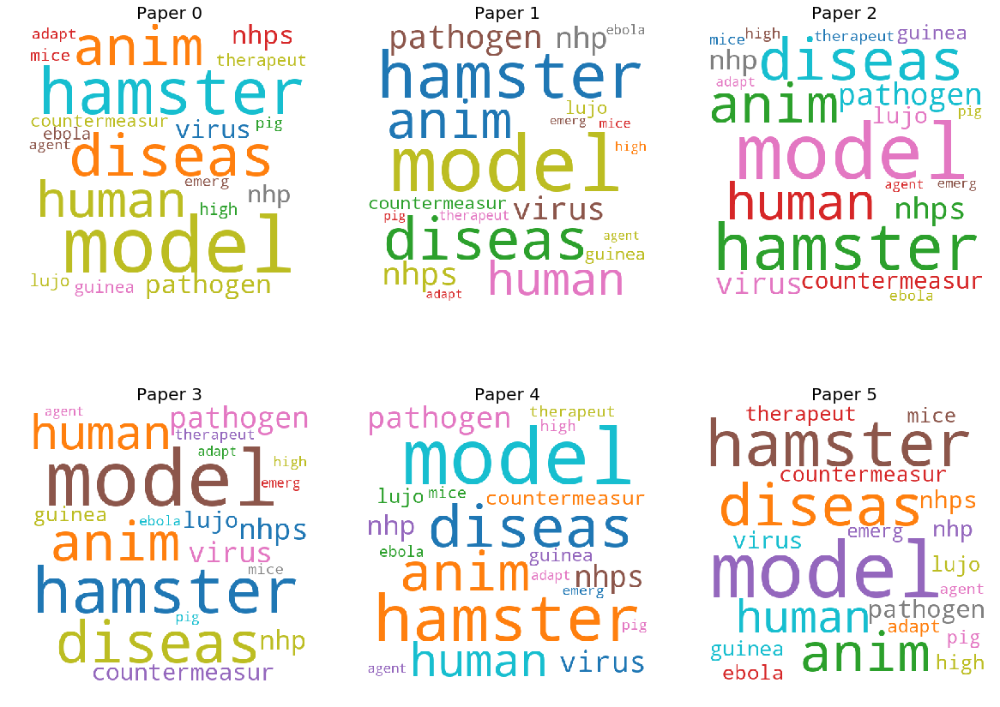

,title,doi,pmcid,pubmed_id,authors
0,Parallel molecular evolution and adaptation in...,10.1016/j.coviro.2018.12.006,,3.07036e+07,"Gutierrez, Bernardo; Escalera-Zamudio, Marina;..."
1,Role of genomic and proteomic tools in the stu...,10.1007/s13337-013-0150-3,PMC3832694,,"Bhattacharjee, Soumen"
2,M-VI Laboratory tools for diagnosis and monito...,10.1016/S1386-6532(09)70033-2,,,"Kessler, H.H."
3,Viral factors in influenza pandemic risk asses...,10.7554/eLife.18491,PMC5156527,2.78346e+07,"Lipsitch, Marc; Barclay, Wendy; Raman, Rahul; ..."
4,Moving beyond hand hygiene monitoring as a mar...,10.1016/j.ajic.2019.06.014,,3.13584e+07,"Jeanes, Annette; Coen, Pietro G.; Drey, Nicola..."
5,From Individuals to Groups and Back: The Evolu...,10.1016/j.tree.2015.07.005,PMC4594155,2.64116e+07,"Farine, Damien R.; Montiglio, Pierre-Olivier; ..."


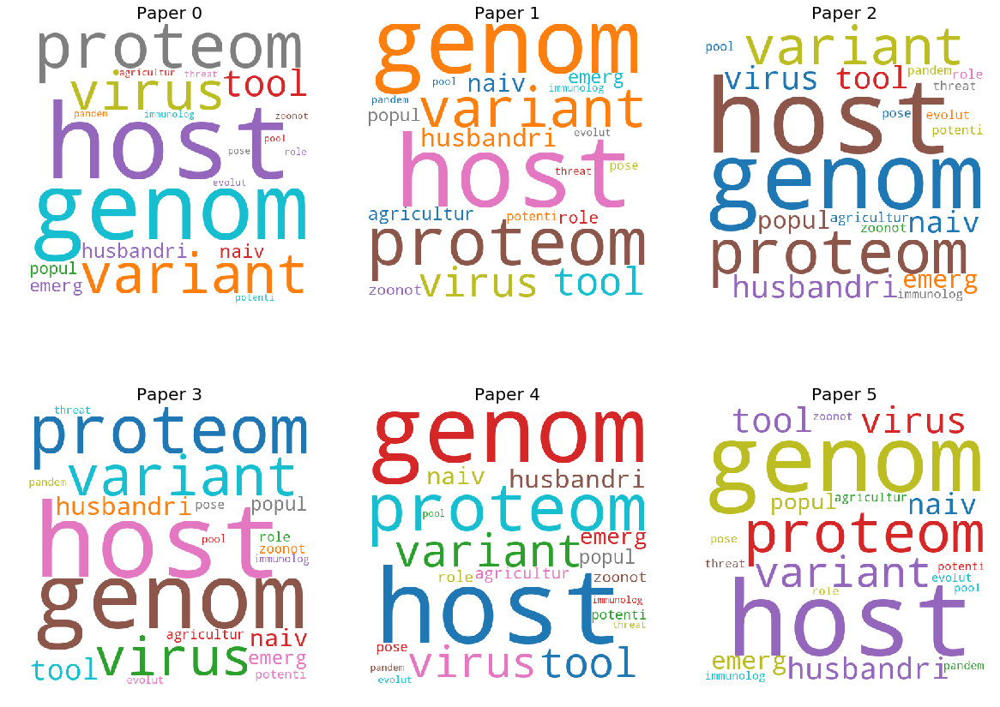

,title,doi,pmcid,pubmed_id,authors
0,Immune response of mice immunized with mouse h...,,,,"Hasony, Hassan J.; Macnaughton, Malcolm R."
1,Understanding immune senescence to improve vac...,10.1038/ni.2588,PMC4183346,,"Goronzy, Jörg J.; Weyand, Cornelia M."
2,Immunity to infection,10.1016/0952-7915(88)90037-4,,2.67971e+06,
3,Immunity to infection,10.1016/0952-7915(91)90023-T,,1.75598e+06,
4,Immunity to infection,10.1016/S0952-7915(96)80049-5,,8.99824e+06,
5,Immunity to viruses,10.1111/imr.12109,PMC3810961,,"Braciale, Thomas J.; Hahn, Young S."


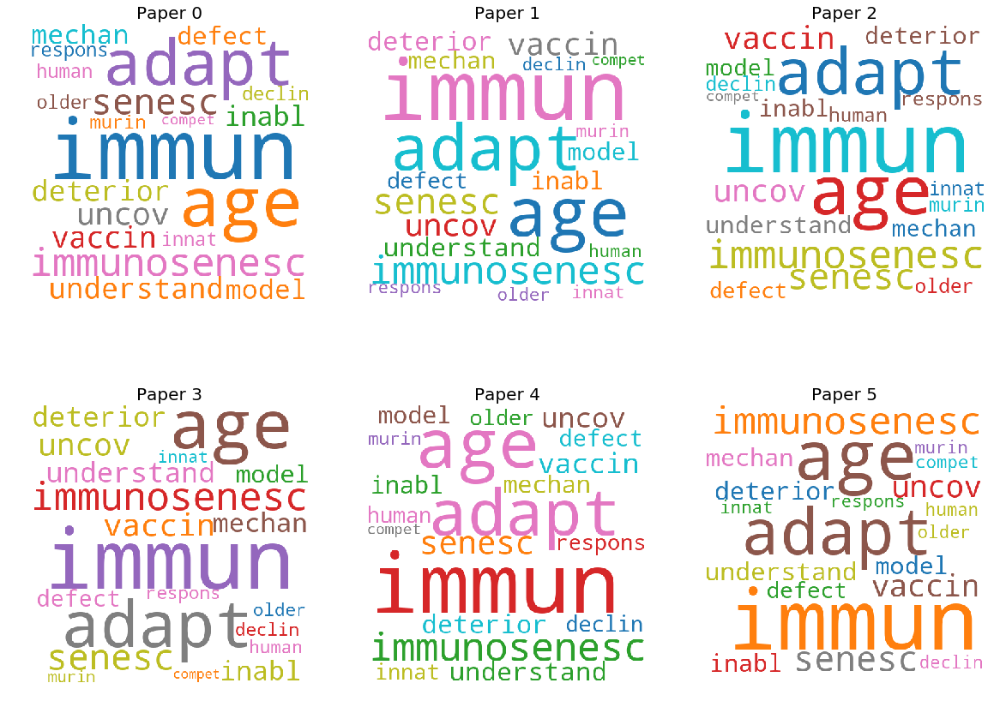

,title,doi,pmcid,pubmed_id,authors
0,"Viral Infections, an Overview with a Focus on ...",10.1016/B978-0-12-803678-5.00514-2,,,"Cheng, Vincent Chi-Chung; Chan, Jasper Fuk-Woo..."
1,2007 Guideline for Isolation Precautions: Prev...,10.1016/j.ajic.2007.10.007,,,"Siegel, Jane D.; Rhinehart, Emily; Jackson, Ma..."
2,SARS transmission in Vietnam outside of the he...,10.1017/S0950268806006996,PMC2870589,,"TUAN, P. A.; HORBY, P.; DINH, P. N.; MAI, L. T..."
3,Characterizing the Transmission Dynamics and C...,10.1371/journal.pbio.1002057,PMC4301953,2.56076e+07,"Chowell, Gerardo; Nishiura, Hiroshi"
4,SELECTED EPIDEMICS & EMERGING PATHOGENS – CONC...,10.1016/j.disamonth.2017.03.023,,2.97373e+07,
5,Transmission dynamics and control of Ebola vir...,10.1186/s12916-014-0196-0,PMC4207625,2.5301e+07,"Chowell, Gerardo; Nishiura, Hiroshi"


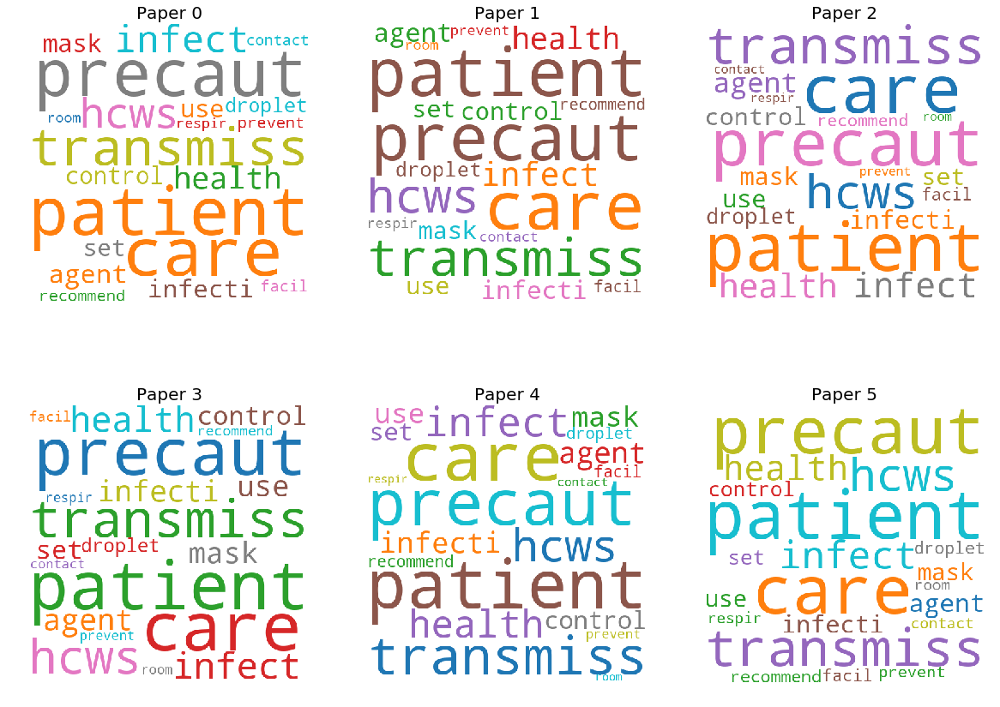

,title,doi,pmcid,pubmed_id,authors
0,Personal Protective Equipment: Protecting Heal...,10.1016/j.clinthera.2015.07.007,PMC4661082,2.64524e+07,"Fischer, William A.; Weber, David J.; Wohl, Da..."
1,Chapter 46 Personal Protective Equipment,10.1016/B978-0-323-28665-7.00046-7,,,"Eyre, Andrew J.; Hick, John L.; Thorne, Craig D."
2,Limiting factors for wearing personal protecti...,10.1371/journal.pone.0210775,PMC6342303,3.06686e+07,"Loibner, Martina; Hagauer, Sandra; Schwantzer,..."
3,More PPE protects better against Ebola,10.1016/j.ajic.2015.12.024,,2.6944e+07,"Verbeek, Jos H.; Mihalache, Raluca Cecilia"
4,Behavioral considerations and impact on person...,10.1016/j.jaad.2020.03.013,,,"Kantor, Jonathan"
5,Are You Covered? Safe Practices for the use of...,10.1016/j.jen.2014.11.011,,2.56125e+07,"Valdez, Anna Maria"


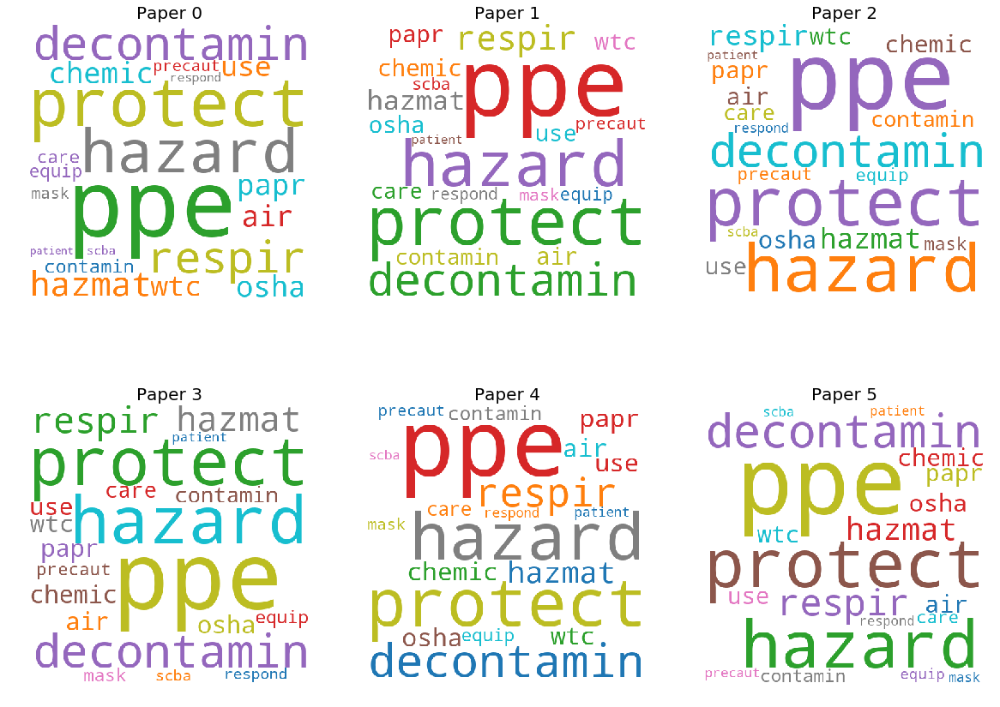

,title,doi,pmcid,pubmed_id,authors
0,Closed environments facilitate secondary trans...,10.1101/2020.02.28.20029272,,,
1,Airborne biological hazards and urban transpor...,10.1007/s11356-016-7064-8,PMC4956722,2.73185e+07,"Nasir, Zaheer Ahmad; Campos, Luiza Cintra; Chr..."
2,The impact of the built environment on health ...,10.1098/rstb.2017.0245,PMC6030577,,"Pinter-Wollman, Noa; Jelić, Andrea; Wells, Nan..."
3,Environmental effects on parasitic disease tra...,10.1073/pnas.0701878104,PMC1852328,,"Liang, Song; Seto, Edmund Y. W.; Remais, Justi..."
4,Host and environment are key factors,10.1136/jech.57.10.770,PMC1732298,,"Lee, A"
5,"One Health: People, Animals, and the Environment",10.3201/eid2204.151887,PMC4806965,,"Behravesh, Casey Barton"


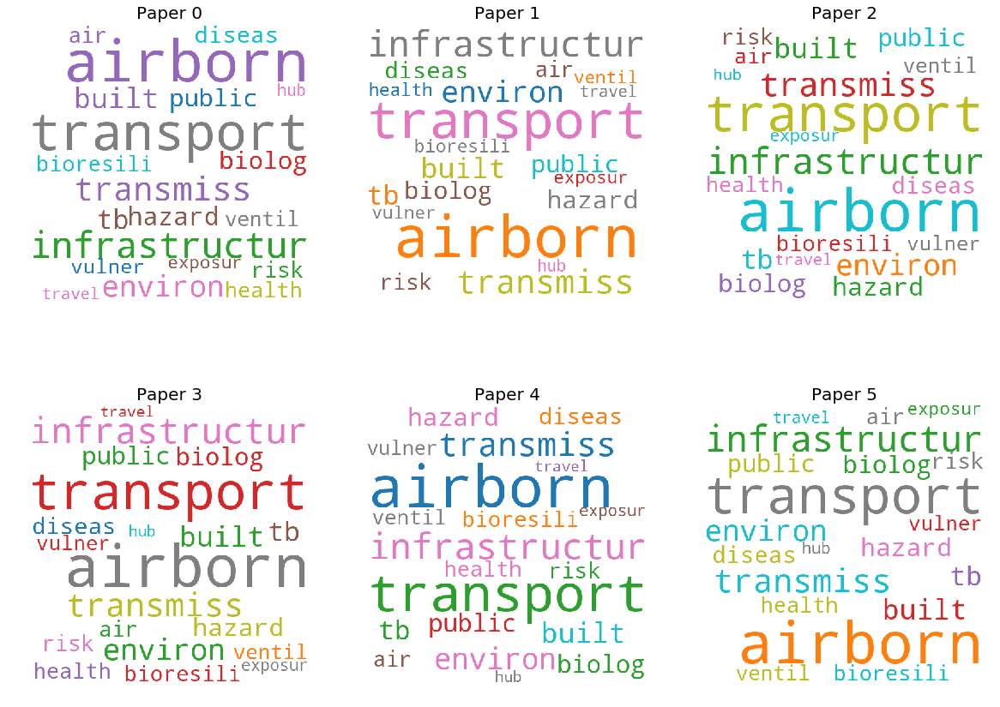

In [11]:
display_topics_results("What is known about transmission, incubation, and environmental stability?")

# What do we know about COVID-19 risk factors?

,title,doi,pmcid,pubmed_id,authors
0,2 Risk Analysis Framework Guidance for Wildlif...,10.1016/B978-0-323-55228-8.00002-3,,,"Travis, Dominic A.; Smith, Kristine"
1,Risks of Death and Severe Disease in Patients ...,10.1093/aje/kww013,PMC5023790,,"Rivers, Caitlin M.; Majumder, Maimuna S.; Lofg..."
2,Selection of critical factors for identifying ...,10.1016/j.foodcont.2009.12.010,,,"van Asselt, E.D.; Meuwissen, M.P.M.; van Assel..."
3,8 Quantitative risk assessment for food- and w...,10.1533/9780857098870.2.159,,,"De Roda Husman, A.M.; Bouwknegt, M."
4,Risk factors associated with superspreading ev...,,PMC2117241,,"Mohammed, Ali A"
5,How to make predictions about future infectiou...,10.1098/rstb.2010.0387,PMC3130384,2.16249e+07,"Woolhouse, Mark"


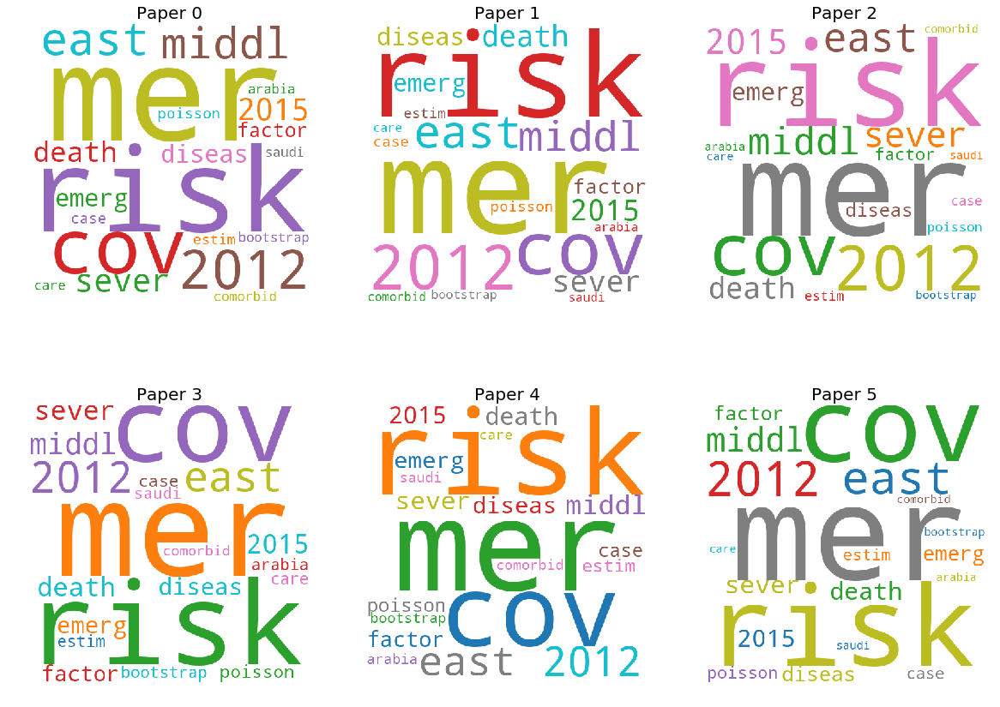

,title,doi,pmcid,pubmed_id,authors
0,Losartan attenuates chronic cigarette smoke ex...,10.1016/j.taap.2010.02.009,,,"Han, Su-Xia; He, Guang-Ming; Wang, Tao; Chen, ..."
1,Legislative smoking bans for reducing harms fr...,10.1002/14651858.CD005992.pub3,PMC6486282,,"Frazer, Kate; Callinan, Joanne E; McHugh, Jack..."
2,Reducing health disparity in Taiwan: quantifyi...,10.1136/tc.2003.005546,PMC1766179,,"Cheng, T; Wen, C; Tsai, S; Chung, W; Hsu, C"
3,Smoking attributable mortality for Taiwan and ...,10.1136/tc.2004.007955,PMC1766186,,"Wen, C; Tsai, S; Chen, C; Cheng, T; Tsai, M; L..."
4,"Effects of smoking and solid-fuel use on COPD,...",10.1016/S0140-6736(08)61345-8,PMC2652750,1.88356e+07,"Lin, Hsien-Ho; Murray, Megan; Cohen, Ted; Coli..."
5,Role of angiotensin-converting enzyme (ACE) an...,10.1016/j.burns.2015.04.010,,2.59813e+07,"Yilin, Zhao; Yandong, Nan; Faguang, Jin"


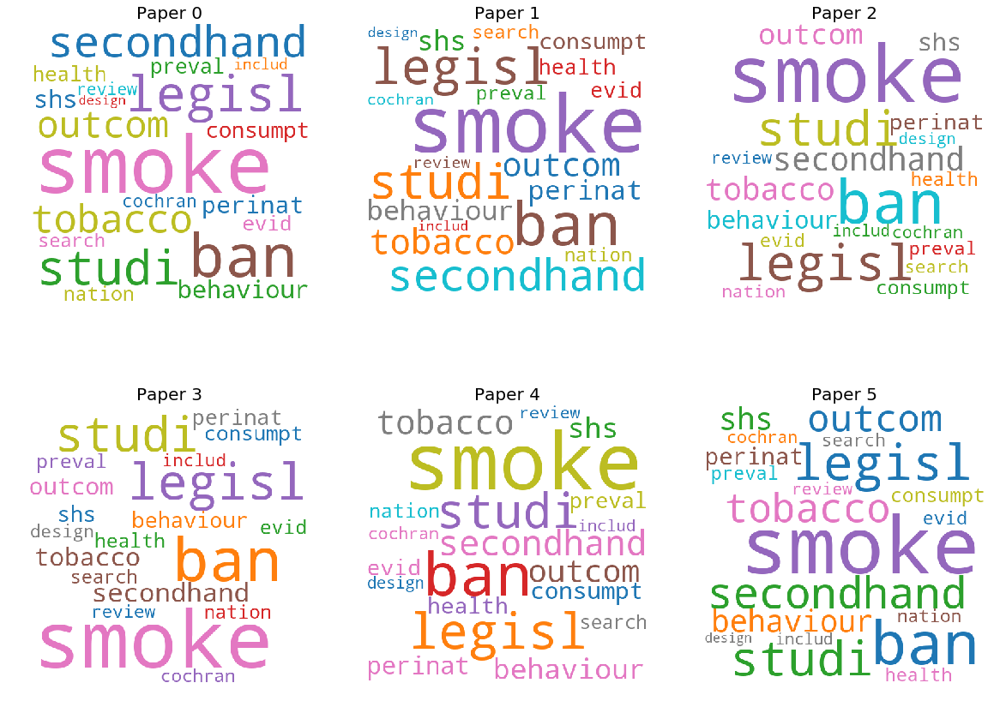

,title,doi,pmcid,pubmed_id,authors
0,Virology and infection control,10.1016/S0196-4399(84)80091-4,,,"Valenti, William M."
1,Chapter 3 Pathogenesis of Viral Infections and...,10.1016/B978-0-12-375158-4.00003-1,,,
2,Tissue tropism and transmission ecology predic...,10.1371/journal.pbio.3000206,PMC6879112,3.17704e+07,"Brierley, Liam; Pedersen, Amy B.; Woolhouse, M..."
3,A60 Revealing the evolution of virulence in RN...,10.1093/ve/vez002.059,PMC6735695,,"Escalera-Zamudio, Marina; Gutiérrez, Bernardo;..."
4,Chapter 7 Patterns of Infection Unwanted Guest...,10.1016/B978-0-12-800964-2.00007-0,,,"Nathanson, Neal; González-Scarano, Francisco"
5,Virology research and virulent human pandemics.,,PMC2271593,,"Mims, C. A."


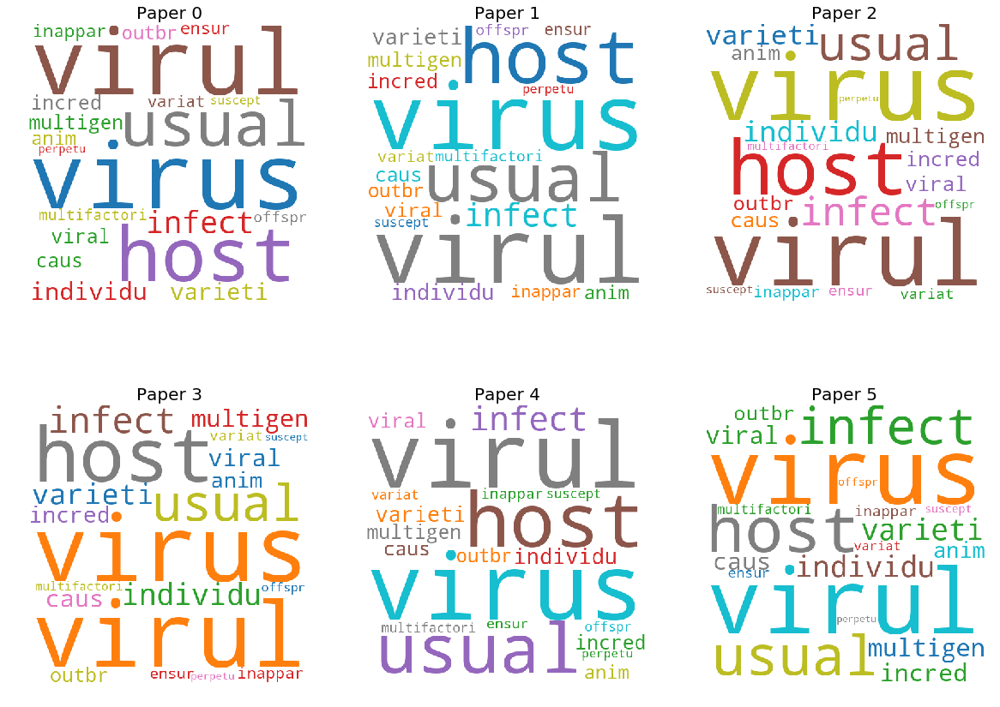

,title,doi,pmcid,pubmed_id,authors
0,Analysis of the pregnancy outcomes in pregnant...,10.3760/cma.j.cn112141-20200218-00111,,3.21457e+07,"Zhang, L.; Jiang, Y.; Wei, M.; Cheng, B. H.; Z..."
1,Severe influenza A(H1N1)pdm09 in pregnant wome...,10.1371/journal.pone.0194392,PMC5868799,2.95791e+07,"Ribeiro, Ana Freitas; Pellini, Alessandra Cris..."
2,Pregnancy and infection: using disease pathoge...,10.1038/s41541-017-0042-4,PMC5794984,2.94233e+07,"Vermillion, Meghan S.; Klein, Sabra L."
3,Emerging Infections and Pregnancy,10.3201/eid1211.060152,PMC3372330,1.72836e+07,"Jamieson, Denise J.; Theiler, Regan N.; Rasmus..."
4,Public Health Approach to Emerging Infections ...,10.2105/AJPH.2004.054957,PMC1449464,,"Rasmussen, Sonja A.; Hayes, Edward B."
5,Pandemic Influenza and Pregnant Women: Summary...,10.2105/AJPH.2008.152900,PMC4504360,,"Rasmussen, Sonja A.; Jamieson, Denise J.; MacF..."


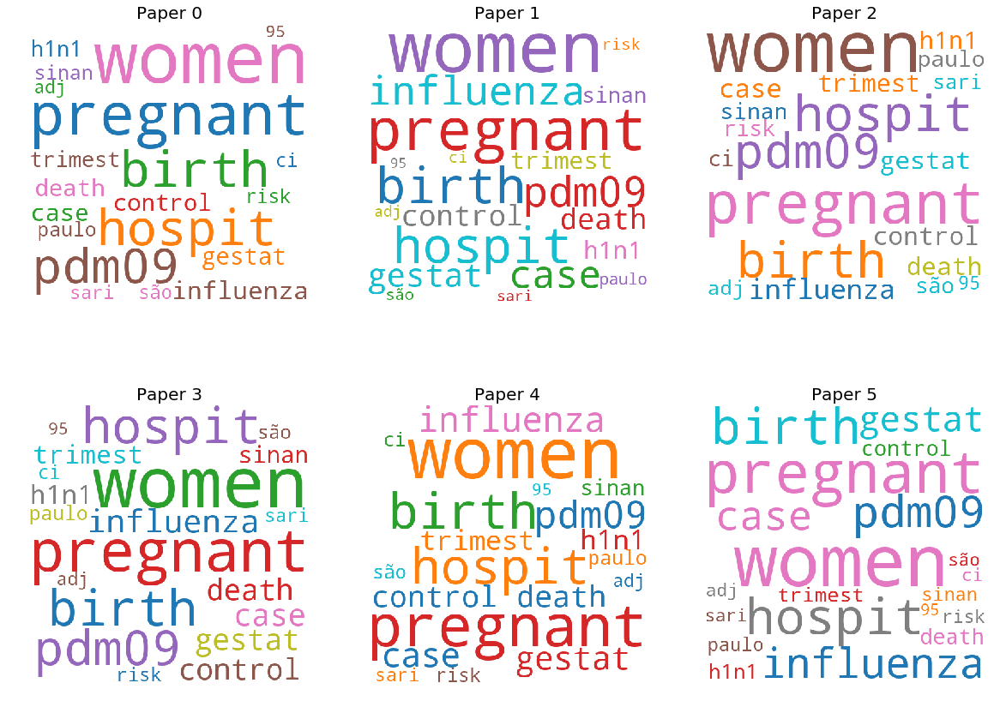

,title,doi,pmcid,pubmed_id,authors
0,The economy-wide impact of pandemic influenza ...,10.1136/bmj.b4571,PMC2779854,1.99267e+07,"Smith, Richard D; Keogh-Brown, Marcus R; Barne..."
1,Macroeconomic Effect of Infectious Disease Out...,10.1016/B978-0-12-375678-7.00608-8,,,"Keogh-Brown, M.R."
2,Assessment of economic vulnerability to infect...,10.1016/S0140-6736(16)30594-3,,2.72124e+07,"Sands, Peter; El Turabi, Anas; Saynisch, Phili..."
3,Modelling the Economic Impact and Ripple Effec...,10.1007/s41660-020-00113-y,,,"Yu, Krista Danielle S.; Aviso, Kathleen B."
4,Chapter 17 Hong Kong Pathway to the Freest Eco...,10.1016/B978-0-12-804181-9.00017-3,,,"Li, Kui-Wai"
5,Associations between media use and health info...,10.1186/s12889-017-4721-x,PMC5594607,2.88932e+07,"Kim, Jiyeon; Jung, Minsoo"


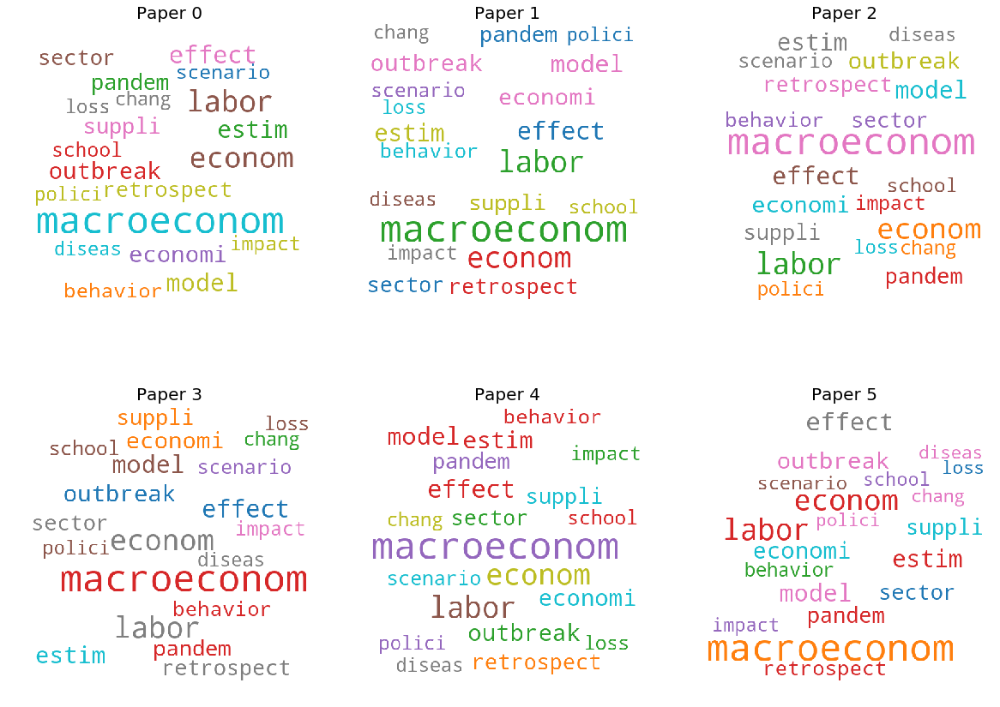

,title,doi,pmcid,pubmed_id,authors
0,Estimating human-to-human transmissibility of ...,10.1371/journal.pone.0204201,PMC6152969,3.02481e+07,"Zhang, Xu-Sheng; Iacono, Giovanni Lo"
1,The Characteristics of Middle Eastern Respirat...,10.1016/j.phrp.2016.01.001,PMC4776270,2.69813e+07,"Kim, Yunhwan; Lee, Sunmi; Chu, Chaeshin; Choe,..."
2,"Transmissibility of swine flu at Fort Dix, 1976",10.1098/rsif.2007.0228,PMC2373398,,"Lessler, Justin; Cummings, Derek A.T; Fishman,..."
3,Time variations in the transmissibility of pan...,10.1186/1742-4682-4-20,PMC1892008,1.75478e+07,"Nishiura, Hiroshi"
4,Strongly heterogeneous transmission of COVID-1...,10.1101/2020.03.10.20033852,,,Yuke Wang; Peter F.M. Teunis
5,Quantifying TB transmission: a systematic revi...,10.1017/S0950268818001760,PMC6092233,,"Ma, Y.; Horsburgh, C. R.; White, L. F.; Jenkin..."


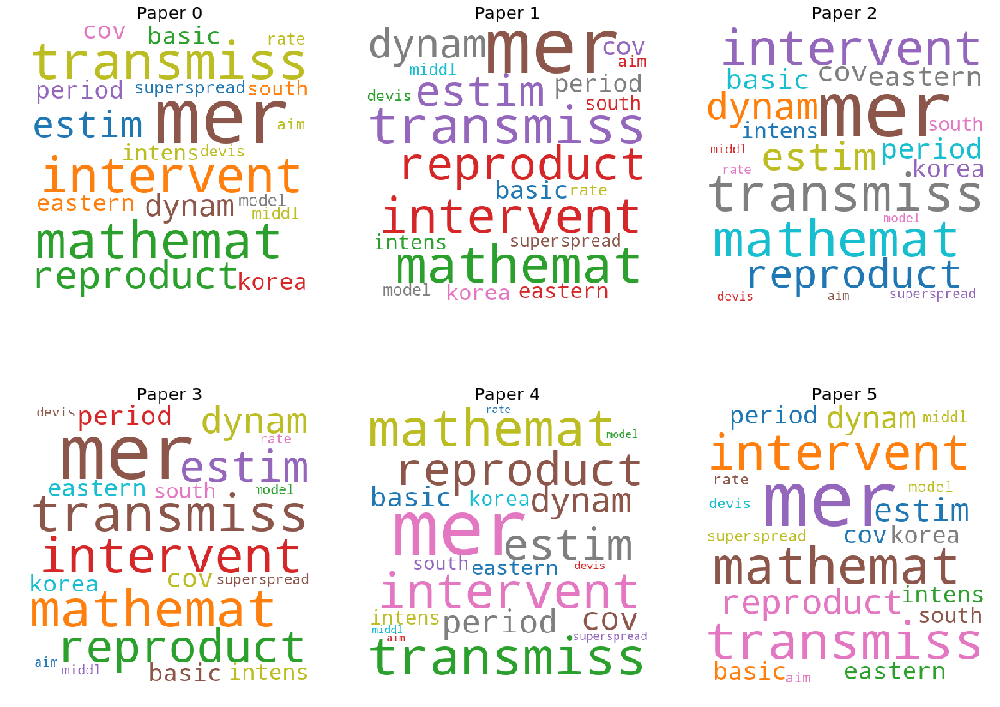

,title,doi,pmcid,pubmed_id,authors
0,Human infection with avian influenza A H7N9 vi...,10.1016/S0140-6736(13)61207-6,PMC3801178,2.38035e+07,"Yu, Hongjie; Cowling, Benjamin J; Feng, Luzhao..."
1,Impact of respiratory virus infection in patie...,,PMC2271374,,"Wiselka, M. J.; Kent, J.; Cookson, J. B.; Nich..."
2,Risk Factors for Death from Influenza A(H1N1)p...,10.1371/journal.pone.0118772,PMC4361171,2.57748e+07,"Ribeiro, Ana Freitas; Pellini, Alessandra Cris..."
3,Real-time estimation of the hospitalization fa...,10.1017/S0950268815003179,PMC5528870,,"Wong, Jessica Y.; Wu, Peng; Lau, Eric H. Y.; T..."
4,Burden of Illness in UK Subjects with Reported...,10.1371/journal.pone.0134928,PMC4546056,2.62875e+07,"Pockett, Rhys D.; Watkins, John; McEwan, Phil;..."
5,Timely estimates of influenza A H7N9 infection...,10.1016/S0140-6736(13)61447-6,,2.38035e+07,"Viboud, Cécile; Simonsen, Lone"


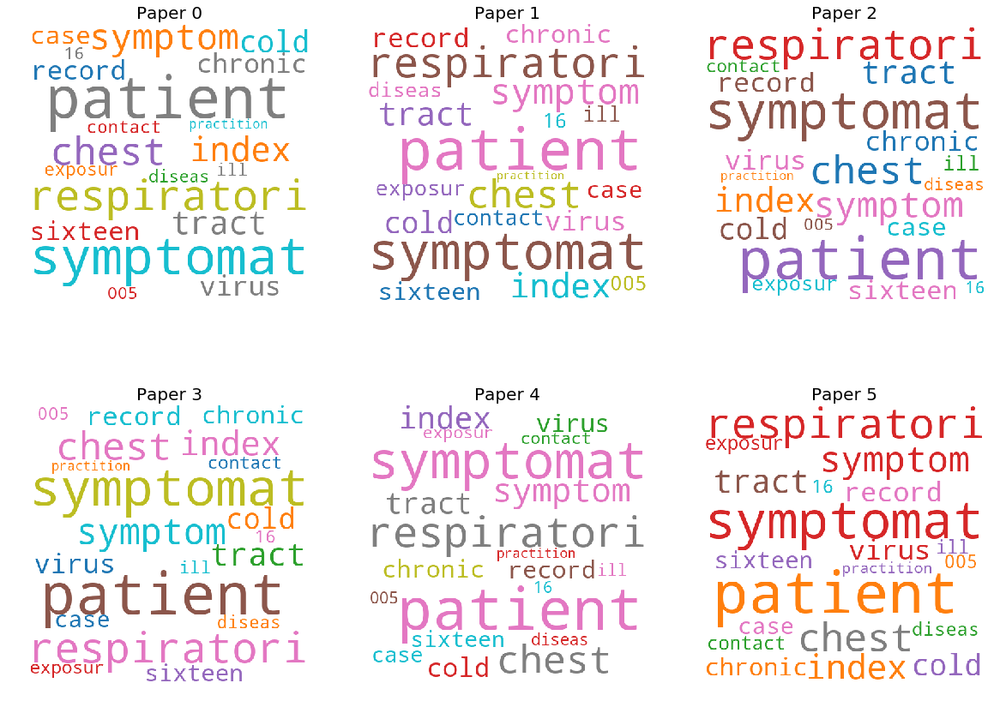

,title,doi,pmcid,pubmed_id,authors
0,Disease control through removal of population ...,10.1016/j.physa.2019.123846,,,"Senapati, Abhishek; Panday, Pijush; Samanta, S..."
1,THE CELLULAR NATURE OF GENETIC SUSCEPTIBILITY ...,,PMC2137639,1.40307e+07,"Kantoch, M.; Warwick, A.; Bang, F. B."
2,Generality of endemic prevalence formulae,10.1016/j.mbs.2015.08.011,,2.63217e+07,"Clancy, Damian"
3,Spread of Infectious Disease Modeling and Anal...,10.3390/ijerph16234683,PMC6926909,3.17752e+07,"Bin, Sheng; Sun, Gengxin; Chen, Chih-Cheng"
4,Directly transmitted viral diseases: modeling ...,10.1016/j.tim.2008.01.007,,1.83561e+07,"Lavine, Jennie S.; Poss, Mary; Grenfell, Bryan T."
5,Mathematical prediction in infection,10.1016/j.mpmed.2009.07.004,,,"Ferguson, Neil M."


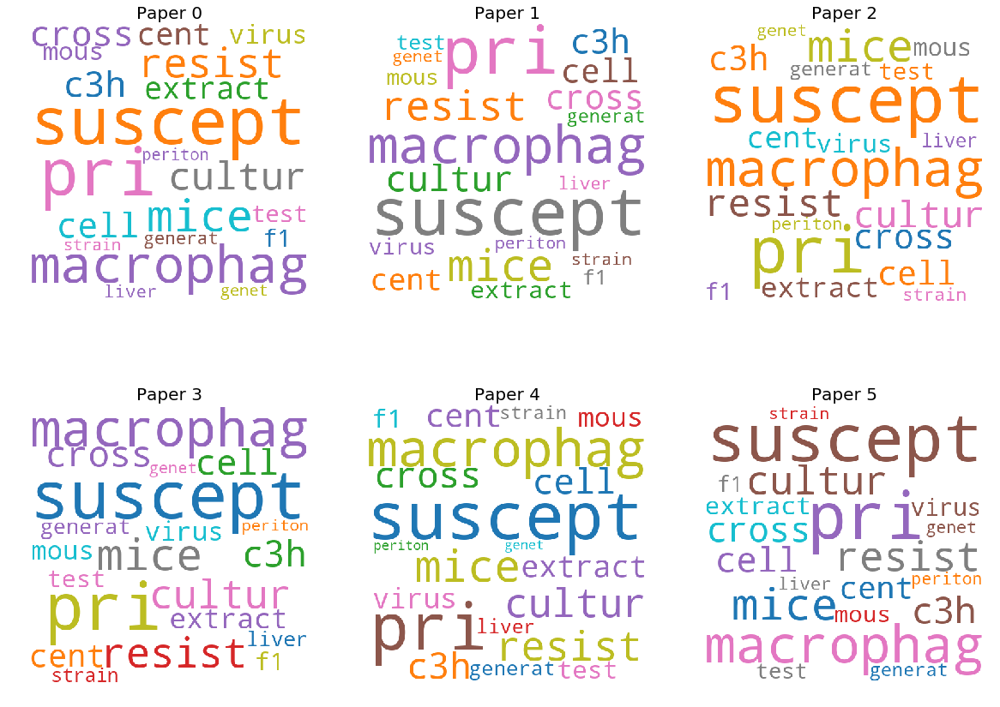

,title,doi,pmcid,pubmed_id,authors
0,Public Response to Community Mitigation Measur...,10.3201/eid1405.071437,PMC2600239,1.84394e+07,"Blendon, Robert J.; Koonin, Lisa M.; Benson, J..."
1,Chapter 21 Disaster Mitigation,10.1016/B978-0-323-03253-7.50028-5,,,"Gougelet, Robert M."
2,Chapter 27 Disaster Mitigation,10.1016/B978-0-323-28665-7.00027-3,,,"Gougelet, Robert M."
3,Conceptualising the technical relationship of ...,10.1186/1472-6963-11-225,PMC3189394,2.19298e+07,"Häsler, Barbara; Howe, Keith S; Stärk, Kathari..."
4,From Containment to Mitigation of COVID-19 in ...,10.1001/jama.2020.3882,,,"Parodi, Stephen M.; Liu, Vincent X."
5,"COVID-19: delay, mitigate, and communicate",10.1016/S2213-2600(20)30128-4,,,"The Lancet Respiratory Medicine,"


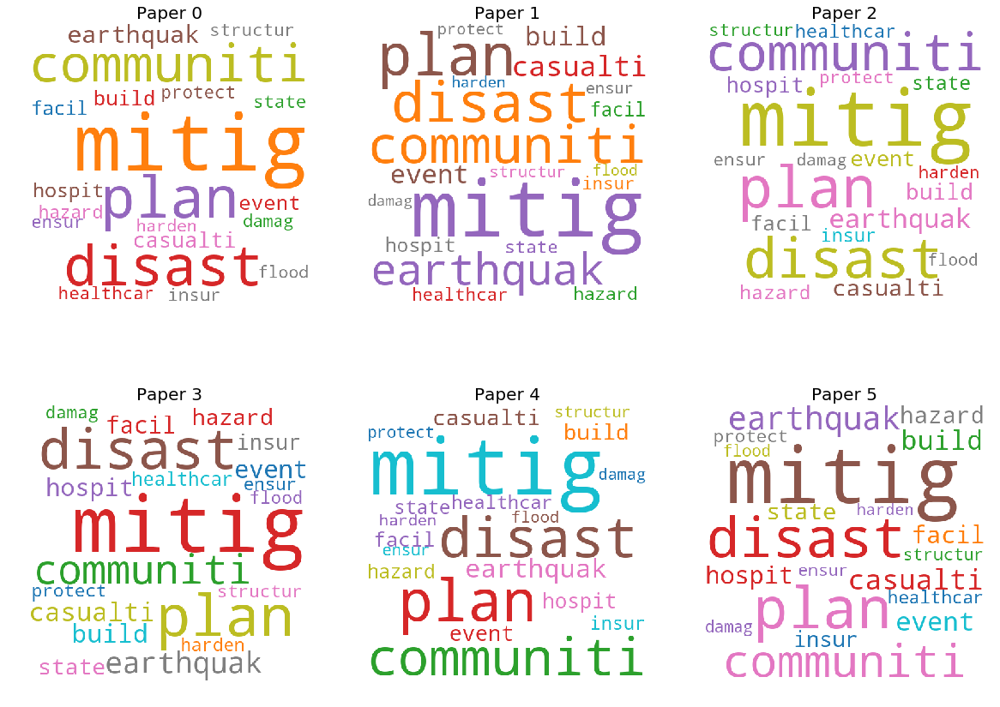

In [12]:
display_topics_results("What do we know about COVID-19 risk factors?")

# What do we know about virus genetics, origin, and evolution?

,title,doi,pmcid,pubmed_id,authors
0,Tracking virus outbreaks in the 21st century,10.1038/s41564-018-0296-2,PMC6345516,,"Grubaugh, Nathan D; Ladner, Jason T; Lemey, Ph..."
1,An interactive web-based dashboard to track CO...,10.1016/S1473-3099(20)30120-1,,,"Dong, Ensheng; Du, Hongru; Gardner, Lauren"
2,Genome analyses help track coronavirus' moves,10.1126/science.367.6483.1176,,,"Kupferschmidt, Kai"
3,Molecular evolution of SARS coronavirus tracked,10.1016/S1473-3099(04)00958-2,,,"Bradbury, Jane"
4,Tracking the spread of infectious disease: Two...,10.1038/sj.embor.7400797,PMC1559678,,"Ross, Karen"
5,Tracking and visualization of space-time activ...,10.1186/1476-072X-12-6,PMC3579692,2.33881e+07,"Qi, Feng; Du, Fei"


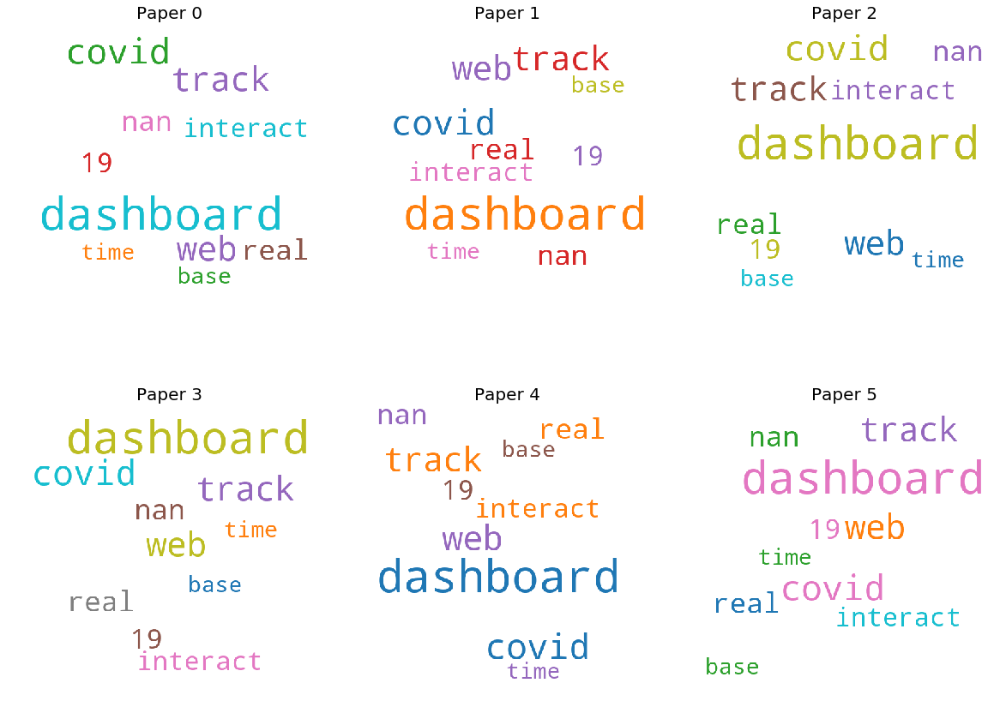

,title,doi,pmcid,pubmed_id,authors
0,Evolution of research in health geographics th...,10.1186/s12942-016-0032-1,PMC4719657,2.67904e+07,"Pérez, Sandra; Laperrière, Vincent; Borderon, ..."
1,Spatio-Temporal Analysis of Infectious Diseases,10.3390/ijerph16040669,PMC6406380,3.08235e+07,"López-Quílez, Antonio"
2,Geographical and Temporal Correlations in the ...,10.1038/jid.2015.93,,2.57568e+07,"Ratushny, Vladimir; Smith, Gideon P."
3,Geographic Access to High Capability Severe Ac...,10.1371/journal.pone.0094057,PMC3976413,2.47054e+07,"Wallace, David J.; Angus, Derek C.; Seymour, C..."
4,Localized spatial clustering of HIV infections...,10.1093/ije/dyp148,PMC2720393,,"Tanser, Frank; Bärnighausen, Till; Cooke, Grah..."
5,Interdisciplinarity,10.1016/B978-0-08-102295-5.10659-6,,,"Raento, Pauliina"


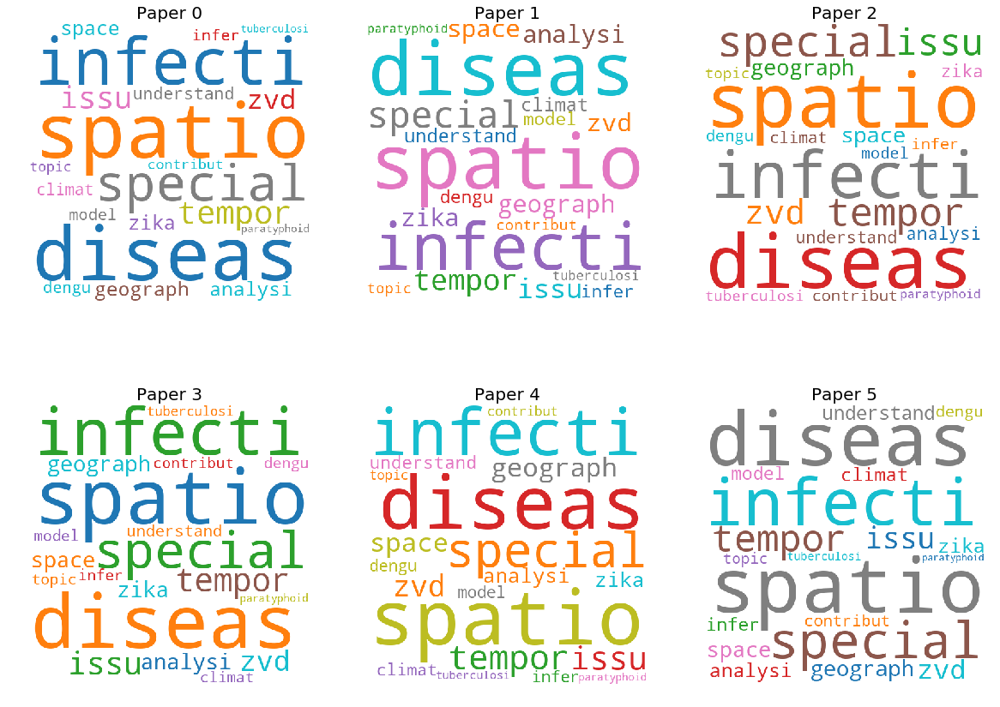

,title,doi,pmcid,pubmed_id,authors
0,Emerging Zoonoses in Domesticated Livestock of...,10.1016/B978-0-444-52512-3.00216-3,,,"Hassan, L."
1,Resistance of livestock to viruses: mechanisms...,10.1186/1297-9686-28-5-385,PMC2708302,,"Gavora, JS"
2,Predicting Reservoir Hosts and Arthropod Vecto...,10.1126/science.aap9072,PMC6536379,,"Babayan, Simon A.; Orton, Richard J.; Streicke..."
3,Impact of genomics on animal agriculture and o...,10.1016/j.tibtech.2007.10.001,,1.80223e+07,"Rothschild, Max F.; Plastow, Graham S."
4,Epidemic predictions in an imperfect world: mo...,10.1098/rspb.2015.0205,PMC4455802,2.59487e+07,"Dawson, Peter M.; Werkman, Marleen; Brooks-Pol..."
5,An Ecological and Conservation Perspective on ...,10.3390/v3040379,PMC3185704,2.19947e+07,"Vandegrift, Kurt J.; Wale, Nina; Epstein, Jona..."


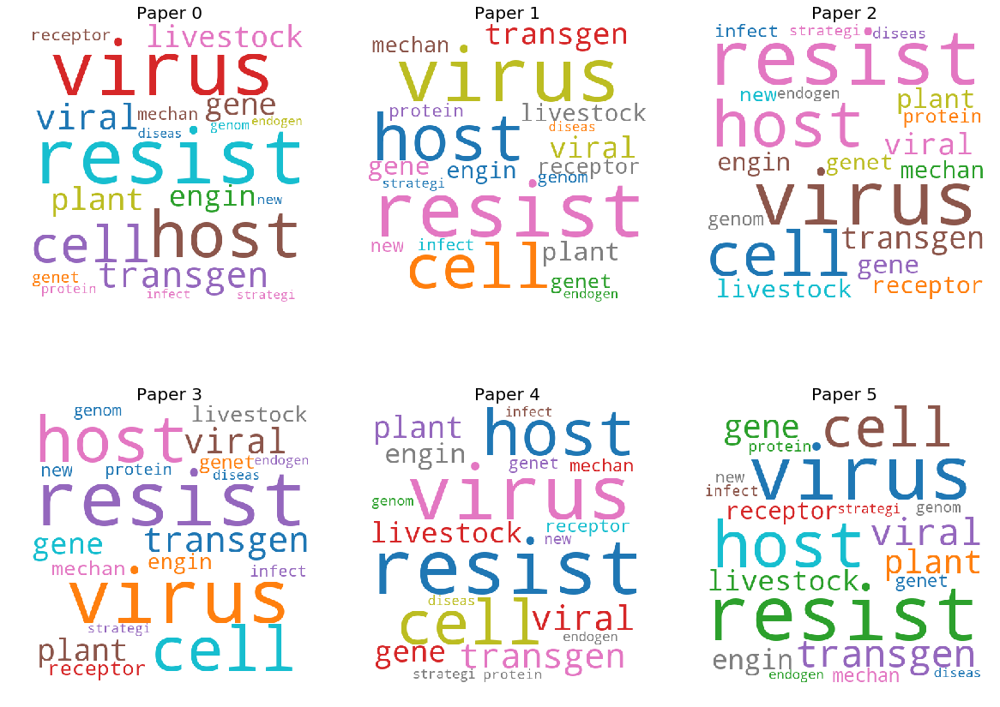

,title,doi,pmcid,pubmed_id,authors
0,Comparison between dairy cow disease incidence...,10.1016/j.prevetmed.2008.12.005,,19178966.0,"Mörk, M.; Lindberg, A.; Alenius, S.; Vågsholm,..."
1,Bioaerosols Play a Major Role in the Nasophary...,10.3390/ijerph16081375,PMC6518280,30995814.0,"Mbareche, Hamza; Veillette, Marc; Pilote, Jona..."
2,A survey of visitors on Swedish livestock farm...,10.1186/1746-6148-9-184,PMC3848732,24040830.0,"Nöremark, Maria; Frössling, Jenny; Lewerin, Su..."
3,The Impact of Farmers’ Strategic Behavior on t...,10.1371/journal.pone.0157450,PMC4907430,27300368.0,"Tago, Damian; Hammitt, James K.; Thomas, Alban..."
4,Biosecurity practices in Belgian veal calf far...,10.1016/j.prevetmed.2019.104768,,31557684.0,"Damiaans, Bert; Renault, Véronique; Sarrazin, ..."
5,A questionnaire-based survey on the uptake and...,10.1136/vropen-2014-000042,PMC4562447,26392877.0,"Cresswell, E.; Brennan, M. L.; Barkema, H. W.;..."


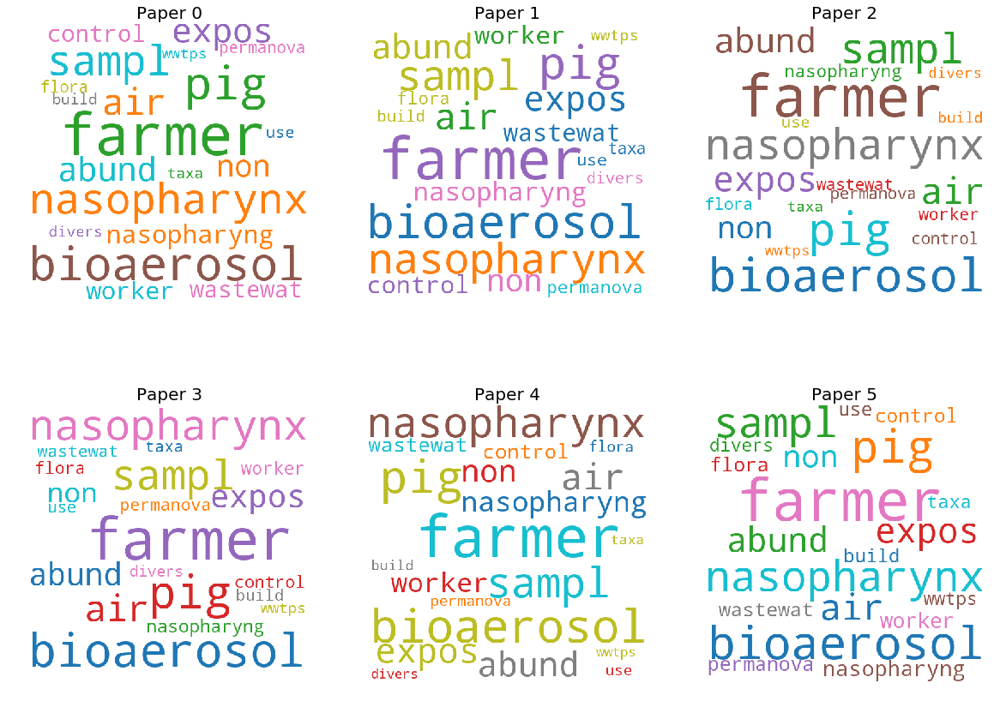

,title,doi,pmcid,pubmed_id,authors
0,Prospects for Emerging Infections in East and ...,10.3201/eid1906.121783,PMC3713834,2.3739e+07,"Horby, Peter W,; Pfeiffer, Dirk; Oshitani, Hit..."
1,A Review of Zoonotic Infection Risks Associate...,10.1007/s10393-017-1229-x,PMC5486459,2.83321e+07,"Cantlay, Jennifer Caroline; Ingram, Daniel J.;..."
2,Emerging infectious diseases in southeast Asia...,10.1016/S0140-6736(10)62004-1,,,"Coker, Richard J; Hunter, Benjamin M; Rudge, J..."
3,Cross-species transmission potential between w...,10.1038/s41598-017-07336-z,PMC5552697,2.87983e+07,"Miller, Ryan S.; Sweeney, Steven J.; Slootmake..."
4,Potential Intermediate Hosts for Coronavirus T...,10.3390/tropicalmed4010034,PMC6473935,3.07442e+07,"El-Duah, Philip; Sylverken, Augustina; Owusu, ..."
5,"Emerging diseases at the interface of people, ...",,PMC2259160,1.71323e+07,"Cook, Robert A."


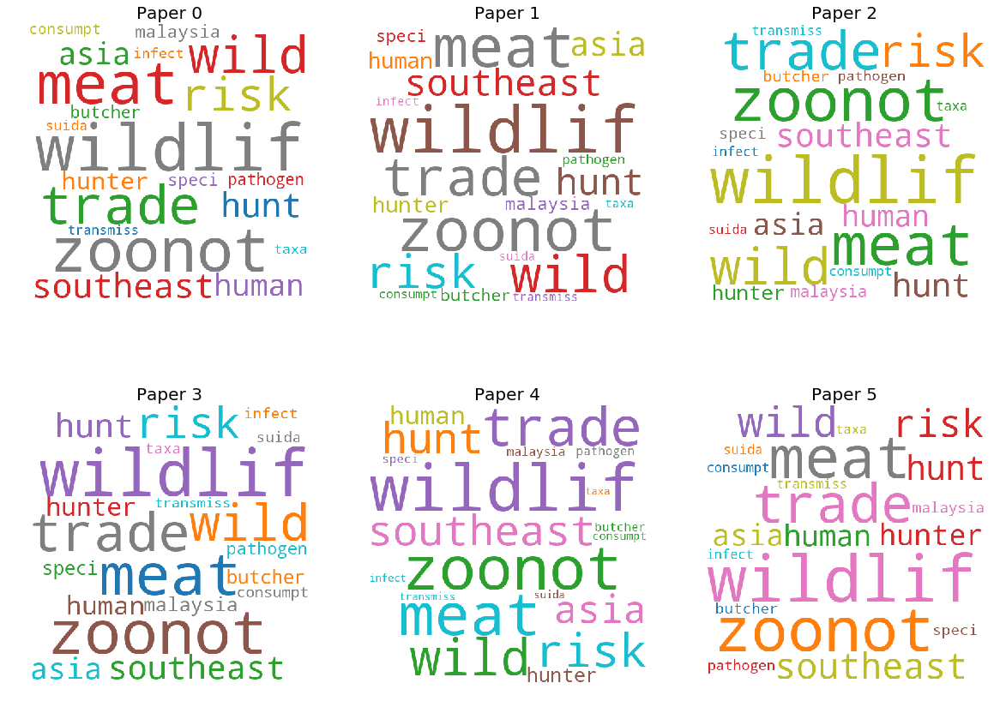

,title,doi,pmcid,pubmed_id,authors
0,Association and Host Selectivity in Multi-Host...,10.1371/journal.pone.0000041,PMC1762347,1.71837e+07,"Malpica, José M.; Sacristán, Soledad; Fraile, ..."
1,Experimental evidence of a pathogen invasion t...,10.1098/rsos.171975,PMC5792953,2.94109e+07,"Dallas, Tad A.; Krkošek, Martin; Drake, John M."
2,Emerging pathogens: the epidemiology and evolu...,10.1016/j.tree.2005.02.009,,,"Woolhouse, Mark E.J.; Haydon, Daniel T.; Antia..."
3,"Q&A: What are pathogens, and what have they do...",10.1186/s12915-017-0433-z,PMC5648414,2.90525e+07,"Balloux, Francois; van Dorp, Lucy"
4,Community Epidemiology Framework for Classifyi...,10.3201/eid1112.050306,PMC3367628,1.64855e+07,"Fenton, Andy; Pedersen, Amy B."
5,Fruits of Virus Discovery: New Pathogens and N...,10.1128/JVI.01194-14,PMC4300757,,"Wang, David"


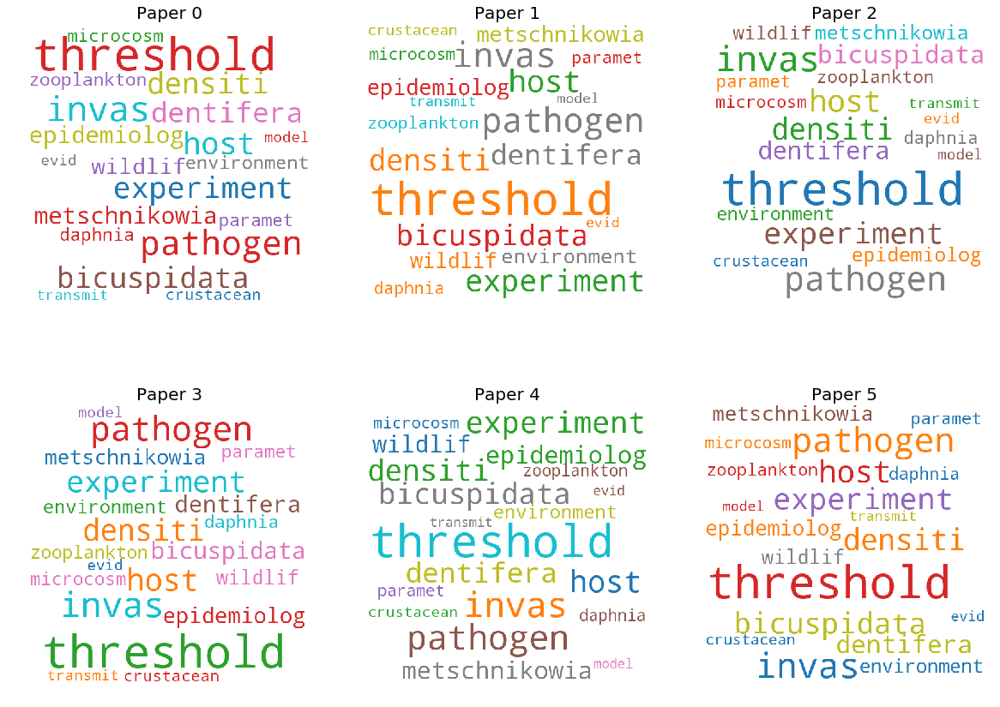

,title,doi,pmcid,pubmed_id,authors
0,Mapping Oil Spills from Dual-Polarized SAR Ima...,10.3390/s18072237,PMC6069476,29997367.0,"Kim, Daeseong; Jung, Hyung-Sup"
1,Are disease reservoirs special? Taxonomic and ...,10.1371/journal.pone.0180716,PMC5509157,28704402.0,"Plourde, Benjamin T.; Burgess, Tristan L.; Esk..."
2,"Spillover of Swine Coronaviruses, United States",10.3201/eid2407.172077,PMC6038755,29912697.0,"Bevins, Sarah N.; Lutman, Mark; Pedersen, Kerr..."
3,Pathogen–host–environment interplay and diseas...,10.1038/emi.2013.5,PMC3630490,26038452.0,"Engering, Anneke; Hogerwerf, Lenny; Slingenber..."
4,One health – an ecological and evolutionary fr...,10.1111/eva.12341,PMC4721077,26834828.0,"Webster, Joanne P.; Gower, Charlotte M.; Knowl..."
5,Overview of the CSIRO Australian Animal Health...,10.1016/j.jiph.2016.04.007,,27118215.0,"Lowenthal, John"


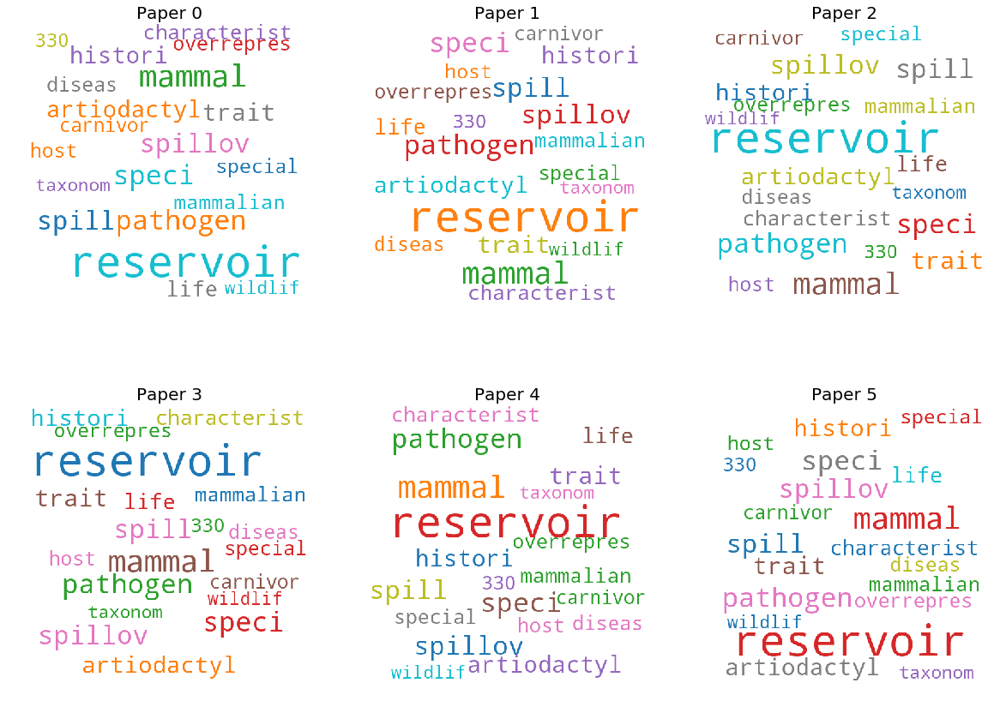

,title,doi,pmcid,pubmed_id,authors
0,Mapping Oil Spills from Dual-Polarized SAR Ima...,10.3390/s18072237,PMC6069476,2.99974e+07,"Kim, Daeseong; Jung, Hyung-Sup"
1,Transformation of the Developing World: Socioe...,10.3201/eid1011.040797_03,PMC3329049,1.60107e+07,"Carroll, Dennis; Gardner, Pierce; Kay, Bradfor..."
2,Do socioeconomic conditions reflect a high exp...,,PMC1732873,,"Filleul, L.; Harrabi, I.; Braga, A.; Martins, ..."
3,Infectious disease and economics: The case for...,10.1016/j.onehlt.2018.100080,PMC6330263,3.06715e+07,"Smith, Kristine M.; Machalaba, Catherine C.; S..."
4,People at Risk of Influenza Pandemics: The Evo...,10.1371/journal.pone.0144868,PMC4682843,2.66584e+07,"Xu, Jianhua; Peng, Zongchao"
5,"Spillover of Swine Coronaviruses, United States",10.3201/eid2407.172077,PMC6038755,2.99127e+07,"Bevins, Sarah N.; Lutman, Mark; Pedersen, Kerr..."


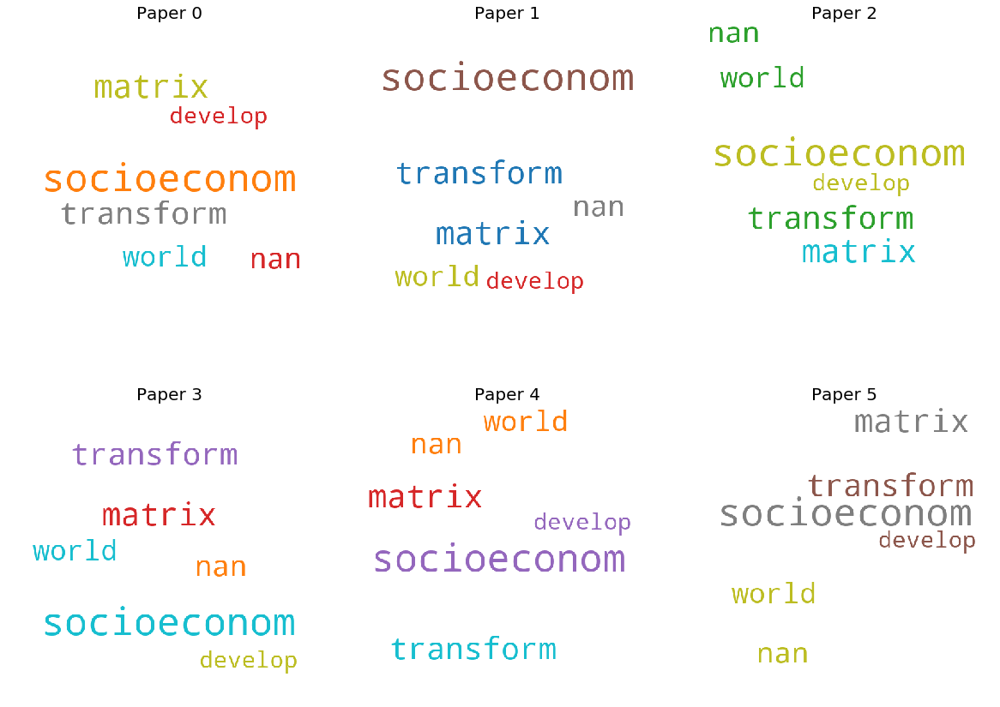

,title,doi,pmcid,pubmed_id,authors
0,Opinion: Sustainable development must account ...,10.1073/pnas.2001655117,PMC7049118,,"Di Marco, Moreno; Baker, Michelle L.; Daszak, ..."
1,Sustainability appraisal in infrastructure pro...,10.1016/j.autcon.2005.05.006,,,"Ugwu, O.O.; Kumaraswamy, M.M.; Wong, A.; Ng, S.T."
2,"Novel Coronavirus Outbreak in Wuhan, China, 20...",10.3390/jcm9020498,,3.20541e+07,"Thompson, Robin N."
3,Cultural shift towards sustainability in the c...,10.1016/j.jenvman.2009.06.017,,1.96435e+07,"Yip Robin, C.P.; Poon, C.S."
4,2019-20 Wuhan coronavirus outbreak: Intense su...,10.1101/2020.01.24.919159,,,"Thompson, R. N."
5,"Air transport globalization, liberalization an...",10.1016/j.jtrangeo.2004.08.007,,,"Goetz, Andrew R.; Graham, Brian"


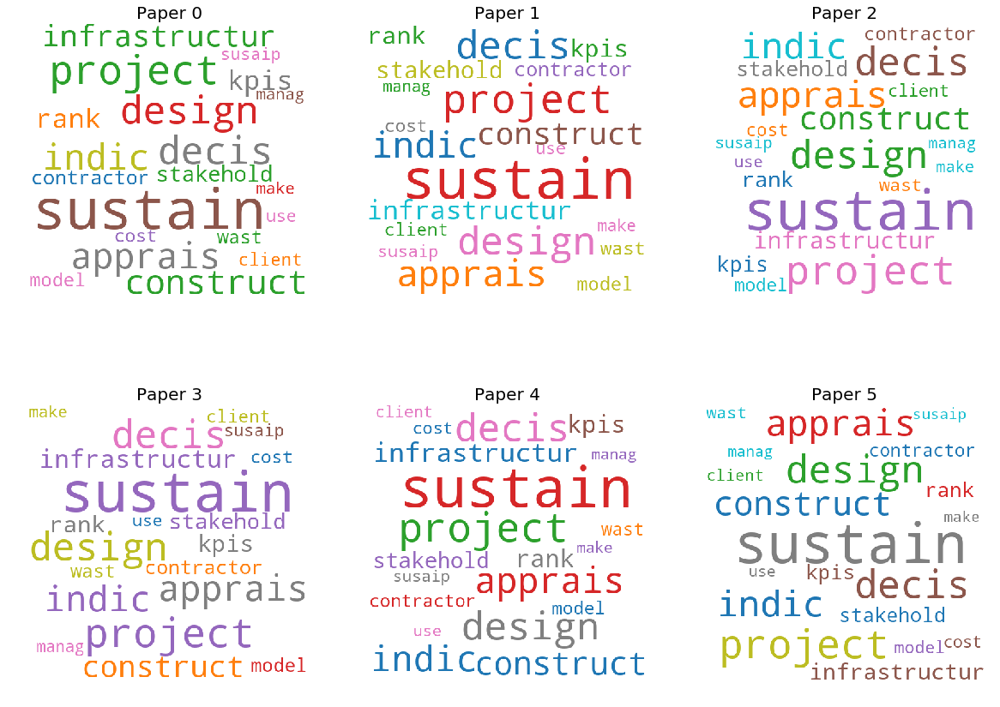

In [13]:
display_topics_results("What do we know about virus genetics, origin, and evolution?")

# What do we know about vaccines and therapeutics?

,title,doi,pmcid,pubmed_id,authors
0,Management and clinical thinking of Coronaviru...,,,,"MA, Ke"
1,Management and clinical thinking of Coronaviru...,10.3760/cma.j.issn.1007-3418.2020.0002,,3.21251e+07,"Ma, K.; Chen, T.; Han, M. F.; Guo, W.; Ning, Q."
2,Taking the right measures to control COVID-19,10.1016/S1473-3099(20)30152-3,,,"Xiao, Yonghong; Torok, Mili Estee"
3,Expert recommendations on the management of pa...,10.3760/cma.j.cn112147-20200221-00138,,3.21251e+07,"Lung Cancer Study Group, Chinese Thoracic Soci..."
4,The Author's Response: Case of the Index Patie...,10.3346/jkms.2020.35.e89,,3.2081e+07,"Lim, Jaegyun; Jeon, Seunghyun; Shin, Hyun Youn..."
5,Letter to the Editor: Case of the Index Patien...,10.3346/jkms.2020.35.e88,PMC7036343,3.2081e+07,"Kim, Jin Yong"


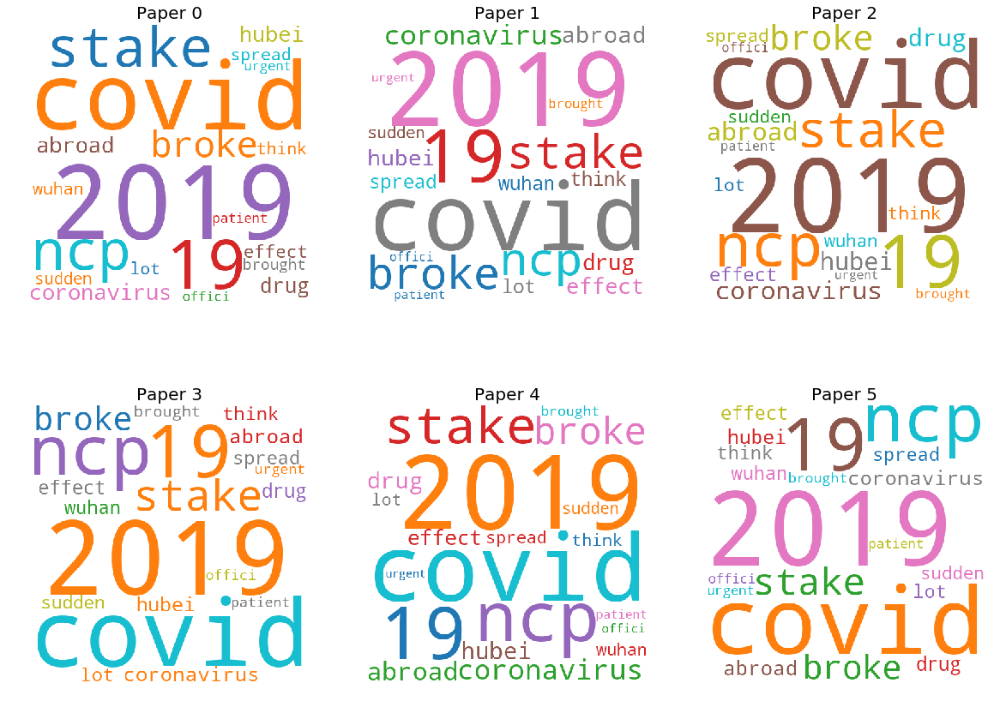

,title,doi,pmcid,pubmed_id,authors
0,Drug Repurposing Approaches for the Treatment ...,10.3389/fimmu.2019.00531,PMC6434107,3.09411e+07,"Pizzorno, Andrés; Padey, Blandine; Terrier, Ol..."
1,Science in the fight against the novel coronav...,10.1097/CM9.0000000000000777,,3.21186e+07,"Wang, Jian-Wei; Cao, Bin; Wang, Chen"
2,A systematic review on the efficacy and safety...,10.1016/j.jcrc.2020.03.005,,,"Cortegiani, Andrea; Ingoglia, Giulia; Ippolito..."
3,Compounds with anti-influenza activity: presen...,,PMC4718316,2.61378e+07,"GASPARINI, R.; AMICIZIA, D.; LAI, P.L.; BRAGAZ..."
4,COVID-19: combining antiviral and anti-inflamm...,10.1016/S1473-3099(20)30132-8,,,"Stebbing, Justin; Phelan, Anne; Griffin, Ivan;..."
5,The role of adjuvant immunomodulatory agents f...,10.1016/j.antiviral.2018.01.002,PMC5801167,2.9326e+07,"Hui, David S.; Lee, Nelson; Chan, Paul K.; Bei..."


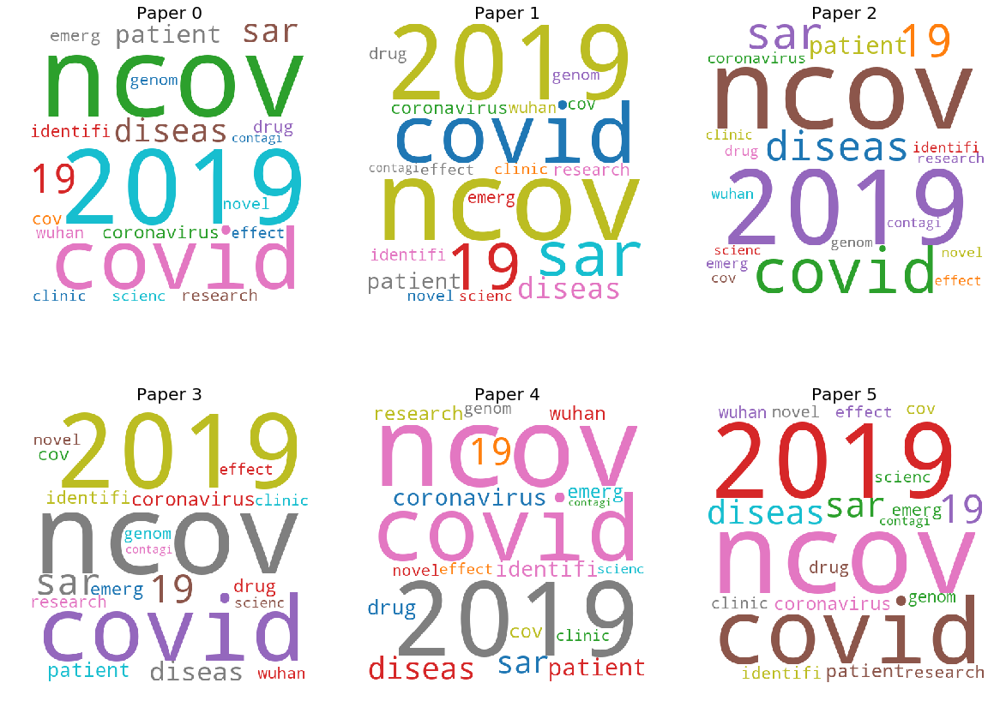

,title,doi,pmcid,pubmed_id,authors
0,Viral-Induced Enhanced Disease Illness,10.3389/fmicb.2018.02991,PMC6290032,3.05686e+07,"Smatti, Maria K.; Al Thani, Asmaa A.; Yassine,..."
1,Traitors of the immune system—Enhancing antibo...,10.1016/j.vaccine.2007.12.028,,1.8242e+07,"Beck, Zoltán; Prohászka, Zoltán; Füst, George"
2,Dynamic effects of antibody-dependent enhancem...,10.1073/pnas.0507320102,PMC1257724,,"Cummings, Derek A. T.; Schwartz, Ira B.; Billi..."
3,Is COVID-19 receiving ADE from other coronavir...,10.1016/j.micinf.2020.02.006,,3.20925e+07,"Tetro, Jason A."
4,Monoclonal antibody analysis of neutralization...,,PMC240165,,"Corapi, W V; Olsen, C W; Scott, F W"
5,Safety of antimicrobial de-escalation for cult...,10.1016/j.jcrc.2019.06.026,,3.13193e+07,"Byoung Soo, Kwon; Sang Ho, Choi; Younsuck, Koh..."


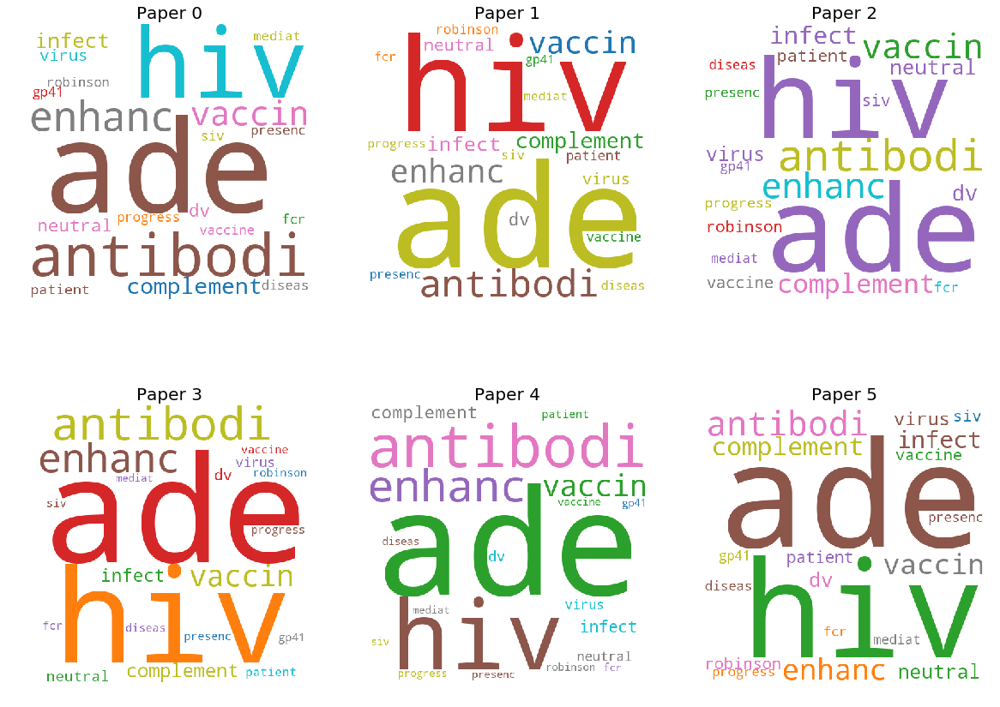

,title,doi,pmcid,pubmed_id,authors
0,Summit proceedings: Biomedical countermeasure ...,10.1016/j.vaccine.2019.08.061,,3.1501e+07,"Blackman, Marcia A.; Marchionni, Mark A.; Gill..."
1,Animal models and antibody assays for evaluati...,10.1016/j.vaccine.2006.07.009,,1.69308e+07,"Roberts, Anjeanette; Wood, John; Subbarao, Kan..."
2,Vaccines for the Elderly: The Quest for the Id...,10.1016/j.jcpa.2009.10.005,,1.98972e+07,"Boudet, F."
3,"Chapter 10 Animal Models No Model Is Perfect, ...",10.1016/B978-0-12-800964-2.00010-0,,,"Baxter, Victoria K.; Griffin, Diane E."
4,The interface of animal and human vaccines,10.1016/j.coviro.2012.04.001,,2.25421e+07,"Schmaljohn, Connie; Mandl, Christian W."
5,Contributions of Farm Animals to Immunology,10.3389/fvets.2018.00307,PMC6292178,3.05745e+07,"Guzman, Efrain; Montoya, Maria"


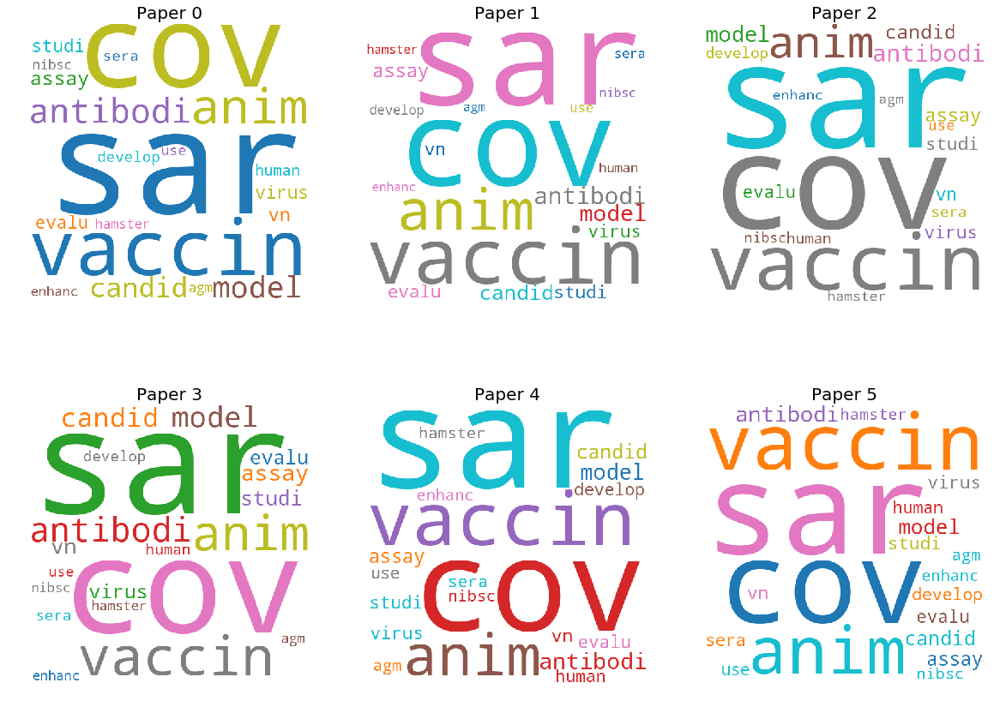

,title,doi,pmcid,pubmed_id,authors
0,Research and Development on Therapeutic Agents...,10.1021/acscentsci.0c00272,,,"Liu, Cynthia; Zhou, Qiongqiong; Li, Yingzhu; G..."
1,Combating emerging viral threats,10.1126/science.aaa3778,PMC4419706,,"Bekerman, Elena; Einav, Shirit"
2,Identification of agents effective against mul...,10.1038/srep13476,PMC4550849,2.63109e+07,"Zilbermintz, Leeor; Leonardi, William; Jeong, ..."
3,Antiviral Targets of Human Noroviruses,10.1016/j.coviro.2016.06.002,PMC4983487,,"Venkataram Prasad, B. V.; Shanker, Sreejesh; M..."
4,Wuhan-like virus discovered seven years ago,10.1016/S0262-4079(20)30281-5,,,"MacKenzie, Debora"
5,DNA Polymerases as Therapeutic Targets,10.1021/bi801179f,PMC2692436,,"Berdis, Anthony J."


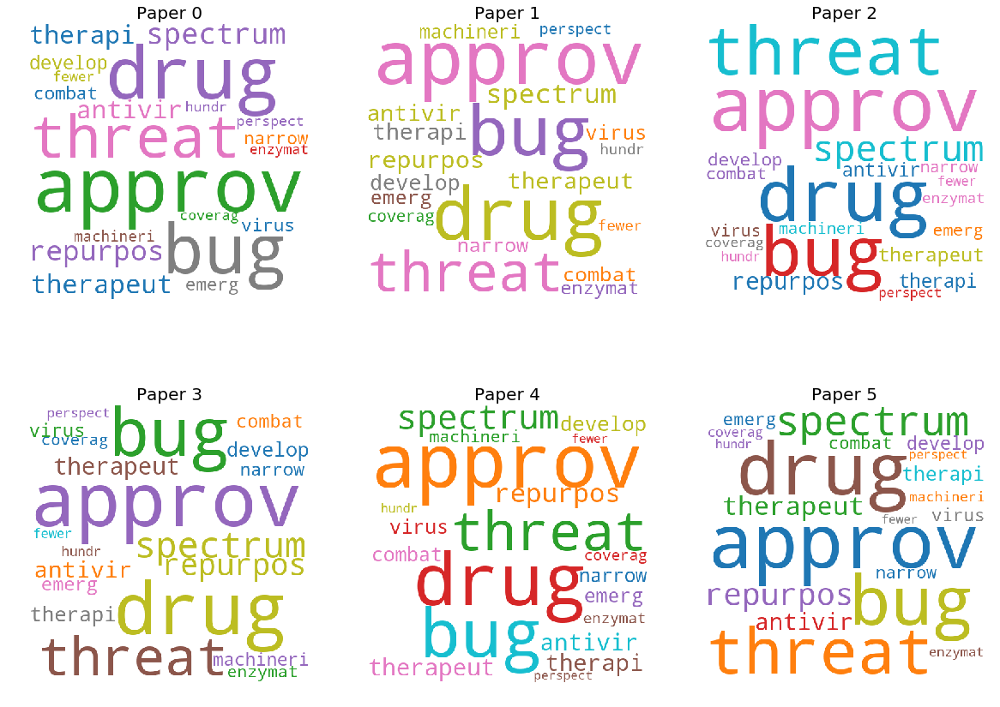

,title,doi,pmcid,pubmed_id,authors
0,A framework for stimulating economic investmen...,10.2471/BLT.17.199547,PMC5791777,2.94031e+07,"Schar, Daniel L; Yamey, Gavin Mark; Machalaba,..."
1,Can free open access resources strengthen know...,10.12688/f1000research.8662.1,PMC4955019,2.75081e+07,"Tambo, Ernest; Madjou, Ghislaine; Khayeka-Wand..."
2,International Biological Reference Preparation...,10.3201/eid2502.180798,PMC6346470,3.06669e+07,"Rampling, Tommy; Page, Mark; Horby, Peter"
3,Approaches to Aggregation and Decision Making—...,10.1016/j.jval.2017.12.010,,2.94774e+07,"Phelps, Charles E.; Lakdawalla, Darius N.; Bas..."
4,Identifying Cost-Effective Dynamic Policies to...,10.1002/sim.7047,PMC5096998,,"Yaesoubi, Reza; Cohen, Ted"
5,"Needs, Gaps and Opportunities for Infectious D...",10.1007/BF03405394,PMC6975993,,"Patrick, David M.; Remple, Valencia P.; Kendal..."


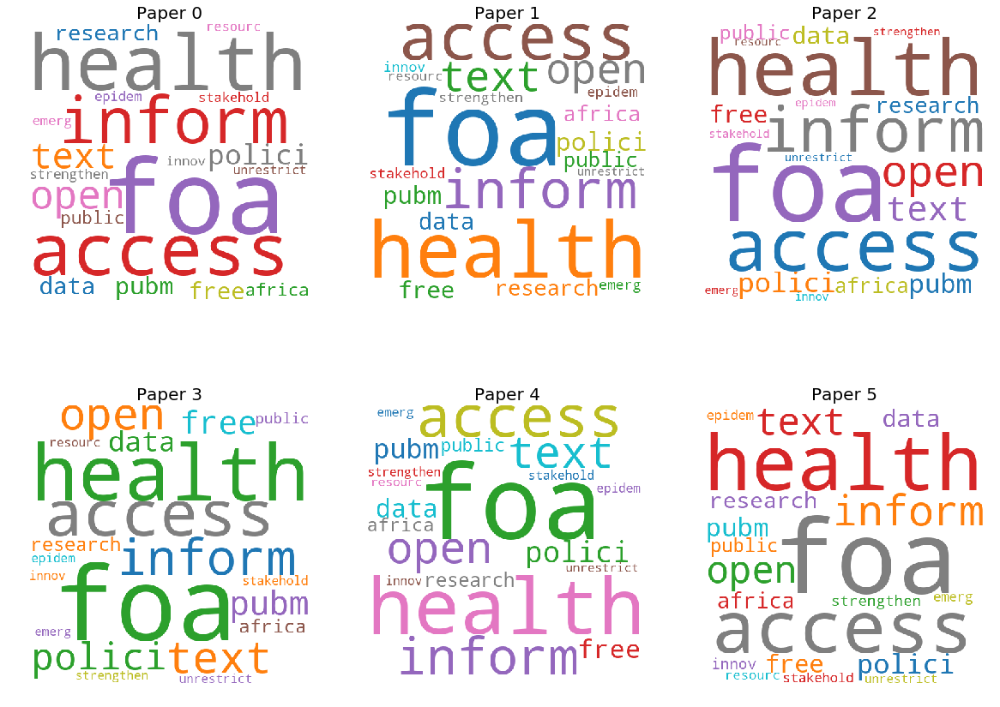

,title,doi,pmcid,pubmed_id,authors
0,Universal coronavirus vaccine; spike protein c...,10.1016/0264-410X(94)90279-8,,,
1,The SARS-CoV-2 Vaccine Pipeline: an Overview,10.1007/s40475-020-00201-6,,,"Chen, Wen-Hsiang; Strych, Ulrich; Hotez, Peter..."
2,Identification of a Receptor-Binding Domain in...,10.1128/JVI.02357-13,PMC3807362,,"Du, Lanying; Zhao, Guangyu; Kou, Zhihua; Ma, C..."
3,Development of next-generation respiratory vir...,10.1586/14760584.2015.1095096,PMC4889331,,"Stobart, Christopher C.; Moore, Martin L."
4,African nations step up efforts to prevent spr...,10.1016/S0262-4079(20)30280-3,,,"MacKenzie, Debora"
5,Research and Development on Therapeutic Agents...,10.1021/acscentsci.0c00272,,,"Liu, Cynthia; Zhou, Qiongqiong; Li, Yingzhu; G..."


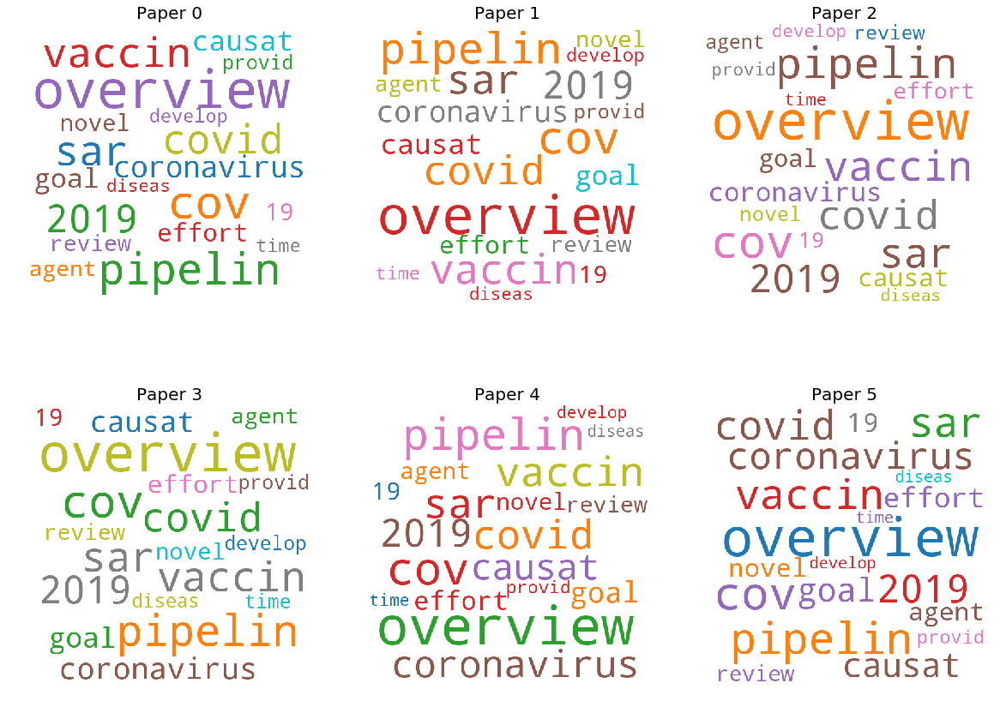

,title,doi,pmcid,pubmed_id,authors
0,Animal models and antibody assays for evaluati...,10.1016/j.vaccine.2006.07.009,,1.69308e+07,"Roberts, Anjeanette; Wood, John; Subbarao, Kan..."
1,Summit proceedings: Biomedical countermeasure ...,10.1016/j.vaccine.2019.08.061,,3.1501e+07,"Blackman, Marcia A.; Marchionni, Mark A.; Gill..."
2,Chapter 38 Animal Models of Human Viral Diseases,10.1016/B978-0-12-415894-8.00038-5,,,"Ruiz, Sara I.; Zumbrun, Elizabeth E.; Nalca, A..."
3,Chapter 33 Animal Models of Human Viral Diseases,10.1016/B978-0-12-809468-6.00033-4,,,"Ruiz, Sara I.; Zumbrun, Elizabeth E.; Nalca, A..."
4,Animal modeling in bone research—Should we fol...,10.1002/ame2.12083,PMC6762042,3.17731e+07,"Schafrum Macedo, Aline; Cezaretti Feitosa, Car..."
5,Monkeypox Virus Infections in Small Animal Mod...,10.3390/v2122763,PMC3185589,2.19946e+07,"Hutson, Christina L.; Damon, Inger K."


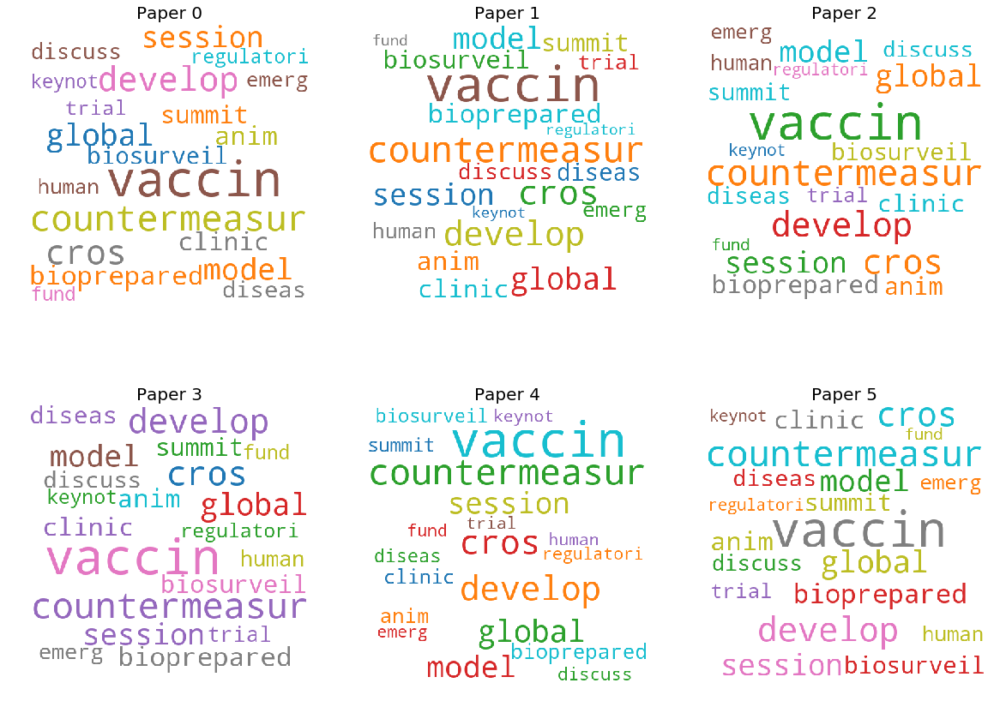

,title,doi,pmcid,pubmed_id,authors
0,Pandethics,10.1016/j.puhe.2008.12.005,,1.92231e+07,"Selgelid, M.J."
1,Respiratory illnesses in Canadian health care ...,10.1111/j.1750-2659.2011.00245.x,PMC5780657,2.16687e+07,"Coleman, Brenda L.; Boggild, Andrea K.; Drews,..."
2,Network Analysis of MERS Coronavirus within Ho...,10.1155/2018/6725284,PMC5964435,2.9854e+07,"Adegboye, Oyelola A.; Elfaki, Faiz"
3,The experience of the 2003 SARS outbreak as a ...,10.1098/rstb.2004.1483,PMC1693388,,"Maunder, Robert"
4,Zanamivir versus trivalent split virus influen...,10.1111/irv.12301,PMC4353320,2.55578e+07,"Coleman, Brenda L; Fadel, Shaza A; Drews, Stev..."
5,World Health Organization Methodology to Prior...,10.3201/eid2409.171427,PMC6106429,3.01244e+07,"Mehand, Massinissa Si; Millett, Piers; Al-Shor..."


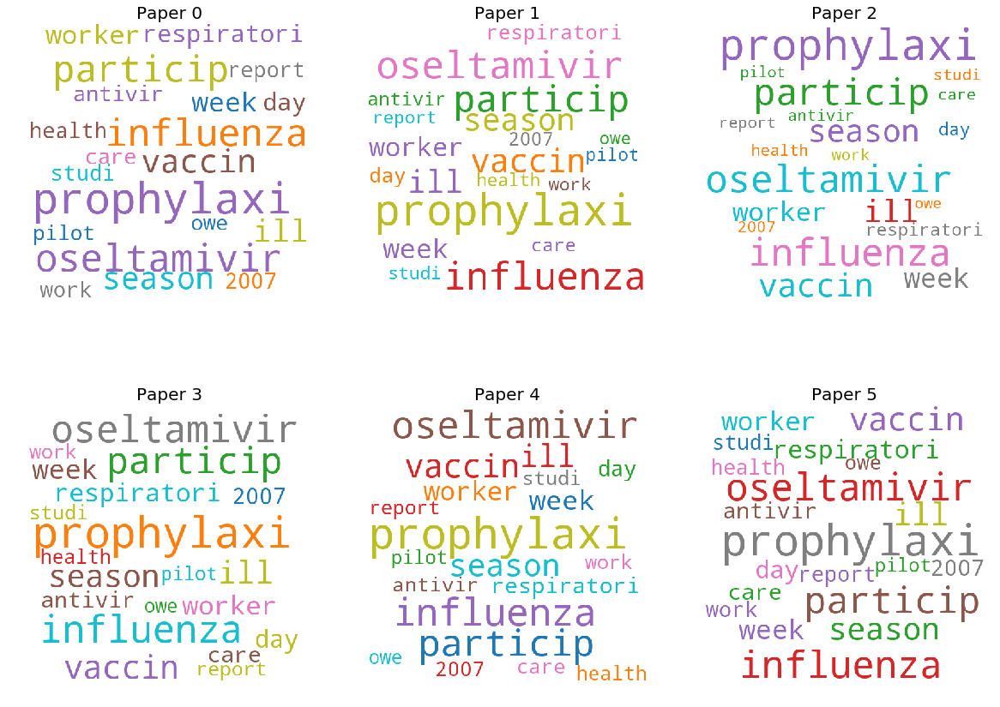

,title,doi,pmcid,pubmed_id,authors
0,Evaluating the Safety of New Vaccines: Summary...,10.2105/AJPH.2004.039438,PMC1449258,,"Ellenberg, Susan S.; Foulkes, Mary A.; Midthun..."
1,Influenza vaccination in children at high risk...,10.1177/2051013613480770,PMC3967668,,"Patria, Maria Francesca; Tagliabue, Claudia; L..."
2,The personal touch: strategies toward personal...,10.1586/14760584.2014.905744,PMC4073206,,"Kennedy, Richard B.; Ovsyannikova, Inna G.; La..."
3,Risk estimation of infectious diseases determi...,10.1016/j.physd.2011.02.001,,,"Zhang, Haifeng; Zhang, Jie; Li, Ping; Small, M..."
4,Prevention of Respiratory Disease in Cow/Calf ...,10.1016/j.cvfa.2010.04.002,,2.06192e+07,"Stokka, Gerald L."
5,"Risk Perception, Preventive Behaviors, and Vac...",10.1371/journal.pone.0064230,PMC3656839,2.36912e+07,"Heo, Jung Yeon; Chang, Soung Hoon; Go, Min Jun..."


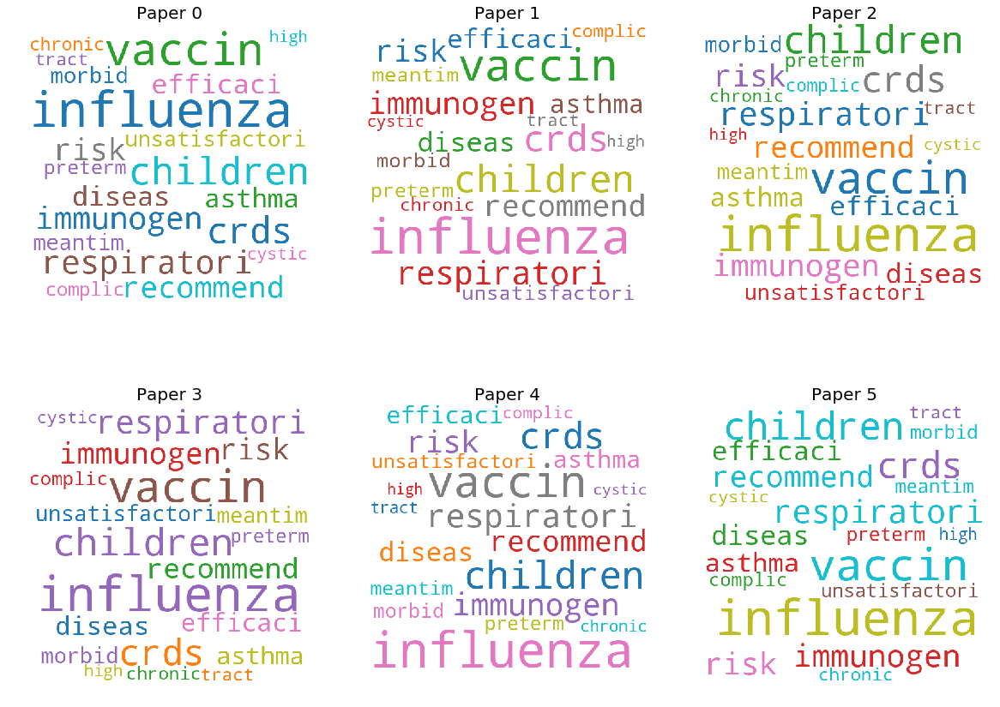

,title,doi,pmcid,pubmed_id,authors
0,Animal models and antibody assays for evaluati...,10.1016/j.vaccine.2006.07.009,,1.69308e+07,"Roberts, Anjeanette; Wood, John; Subbarao, Kan..."
1,Chapter 27 Preclinical Toxicology of Vaccines ...,10.1016/B978-0-12-803620-4.00027-X,,,"Green, M.D.; Al-Humadi, N.H."
2,Chapter 25 Preclinical Toxicology of Vaccines 1,10.1016/B978-0-12-387815-1.00025-3,,,"Green, Martin David; Hussain Al-Humadi, Nabil"
3,Respiratory nanoparticle-based vaccines and ch...,10.1016/j.jconrel.2015.09.047,PMC4760633,2.64108e+07,"Renukaradhya, Gourapura J.; Narasimhan, Balaji..."
4,Current situation in the development of a prev...,10.1016/S0213-005X(05)75157-0,,,"Alcamí, José; Joseph Munné, Joan; Muñoz-Fernán..."
5,Improving influenza vaccine virus selectionRep...,10.1111/j.1750-2659.2011.00277.x,PMC4954460,2.18195e+07,"Ampofo, William K.; Baylor, Norman; Cobey, Sar..."


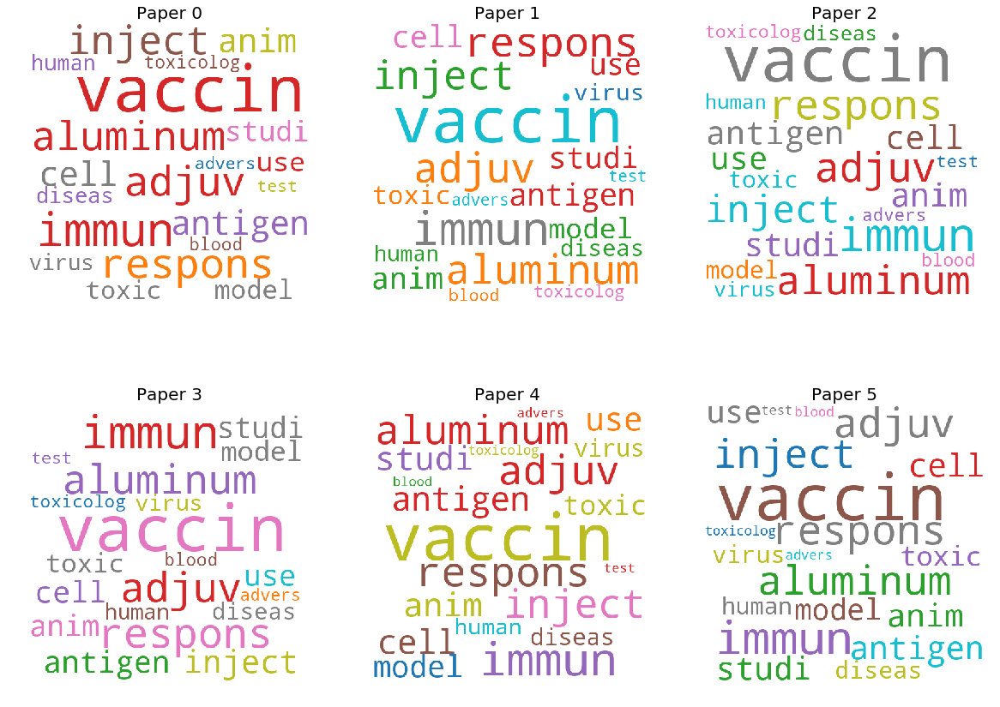

In [14]:
display_topics_results("What do we know about vaccines and therapeutics?")

# What do we know about diagnostics and surveillance?

,title,doi,pmcid,pubmed_id,authors
0,MERS coronavirus: Data gaps for laboratory pre...,10.1016/j.jcv.2013.10.030,,2.42868e+07,"de Sousa, Rita; Reusken, Chantal; Koopmans, Ma..."
1,Integrated biological–behavioural surveillance...,10.2471/BLT.16.175984,PMC5180348,2.80534e+07,"Miller, Maureen; Hagan, Emily"
2,SARS Antibody Test for Serosurveillance,10.3201/eid1009.040101,PMC3320307,1.54982e+07,"Hsueh, Po-Ren; Kao, Chuan-Liang; Lee, Chun-Nan..."
3,Feasibility of Using Convalescent Plasma Immun...,10.3201/eid2209.151164,PMC4994343,2.75328e+07,"Arabi, Yaseen M.; Hajeer, Ali H.; Luke, Thomas..."
4,"Chapter 3 Measuring, Monitoring, and Evaluatin...",10.1016/B978-0-12-415766-8.00003-3,,,"Tulchinsky, Theodore H.; Varavikova, Elena A."
5,Diagnosis of Parasitic Diseases: Old and New A...,10.1155/2009/278246,PMC2804041,2.00691e+07,"Ndao, Momar"


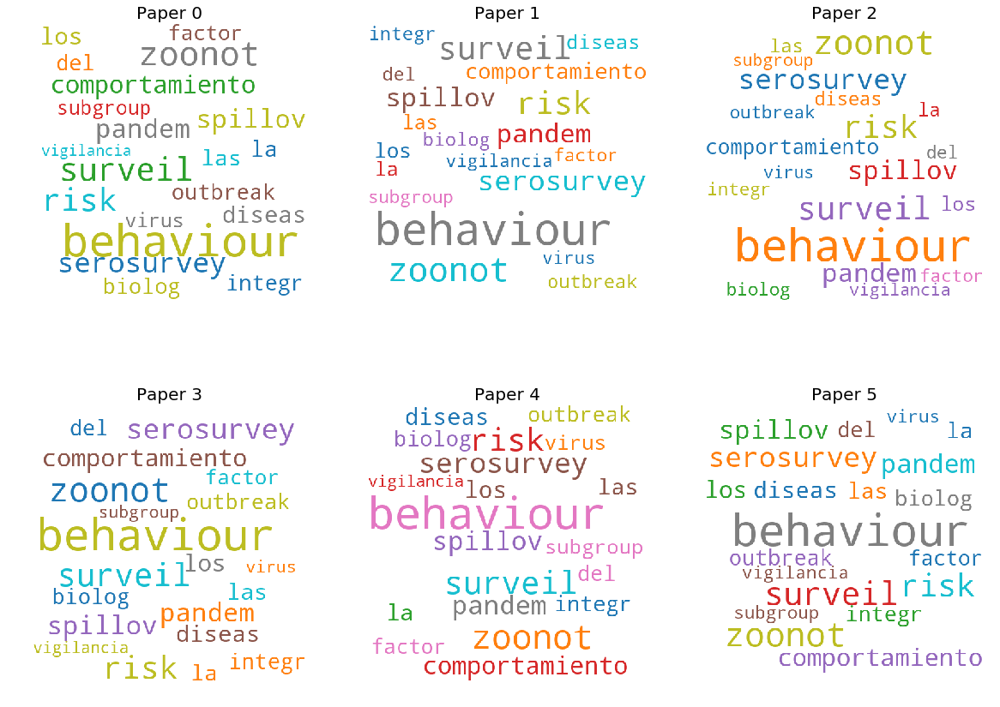

,title,doi,pmcid,pubmed_id,authors
0,Platform technologies for modern vaccine manuf...,10.1016/j.vaccine.2017.02.069,,2.83475e+07,"Charlton Hume, Hayley K.; Lua, Linda H.L."
1,An effective DNA vaccine platform for Middle E...,10.21037/atm.2016.11.40,PMC5233508,,"Cockrell, Adam S.; Baric, Ralph S."
2,The Potential Role of Social Media Platforms i...,10.2196/jmir.3891,PMC4642378,2.64711e+07,"Zowawi, Hosam Mamoon; Abedalthagafi, Malak; Ma..."
3,New frontiers in applied veterinary point‐of‐c...,10.1111/irv.12648,PMC6800308,3.13346e+07,"Schar, Daniel; Padungtod, Pawin; Tung, Nguyen;..."
4,Web-based participatory surveillance of infect...,10.1111/1469-0691.12477,,2.43507e+07,"Paolotti, D.; Carnahan, A.; Colizza, V.; Eames..."
5,No evidence for a superior platform to develop...,10.1073/pnas.1513441112,PMC4577136,,"Dimitrov, Dimiter S.; Jiang, Shibo; Ying, Tian..."


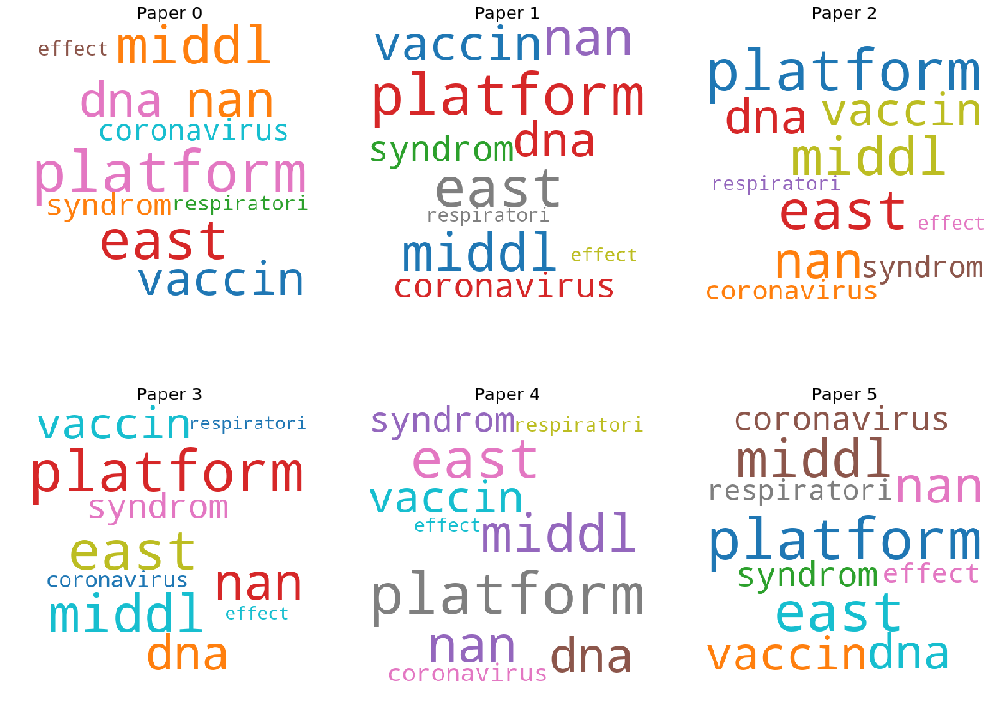

,title,doi,pmcid,pubmed_id,authors
0,"Chapter 2 Recreation, leisure and tourism orga...",10.1016/B978-0-08-089050-0.00002-X,,,"Tribe, John"
1,Perspectives of Australian policy-makers on th...,10.1186/s12961-019-0440-3,PMC6449976,3.09477e+07,"Degeling, Chris; Johnson, Jane; Gilbert, Gwend..."
2,Consortia’s critical role in developing medica...,10.2217/fvl-2015-0011,PMC4912138,,"Everts, Maaike; Suto, Mark J; Painter, George ..."
3,The Next Influenza Pandemic: Will we be Ready ...,10.1016/j.jpeds.2005.04.066,,,"Woods, Charles R.; Abramson, Jon S."
4,The science commons in health research: struct...,10.1007/s10961-006-9016-9,PMC4982884,2.75704e+07,"Cook-Deegan, Robert"
5,Chapter 11 Response at the State and Local Level,10.1016/B978-0-12-802029-6.00011-6,,,"Ryan, Jeffrey R."


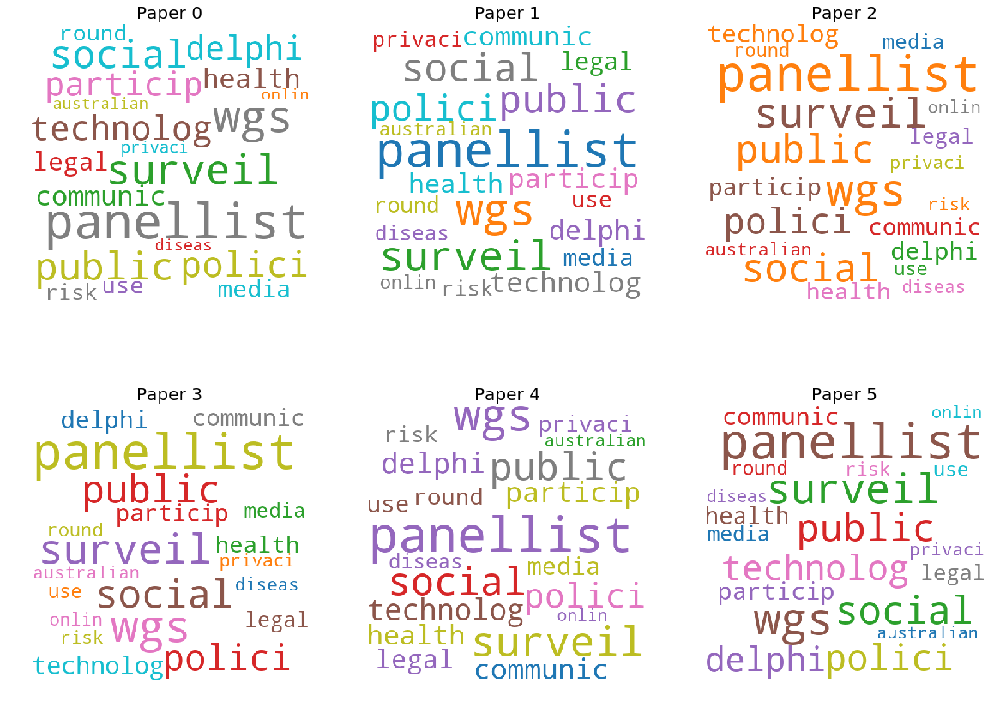

,title,doi,pmcid,pubmed_id,authors
0,Talking to the public about a pandemic: some a...,,PMC2259158,1.71323e+07,"Lanard, Jody"
1,Scales of governance: The role of surveillance...,10.1016/j.healthplace.2012.07.005,,,"Bell, Morag; Warren, Adam; Budd, Lucy"
2,Chapter 10 Legal Aspects of Biosecurity,10.1016/B978-0-12-802029-6.00010-4,,,"Ryan, Jeffrey R."
3,Linkages of acute care and emergency medical s...,10.1016/j.prehos.2004.03.001,,1.52957e+07,"O'Connor, Robert E; Lerner, E.Brooke; Allswede..."
4,Chapter 12 Biosecurity Programs and Assets,10.1016/B978-0-12-802029-6.00012-8,,,"Ryan, Jeffrey R."
5,Pandemic influenza control in Europe and the c...,10.1186/1471-2458-10-532,PMC2945945,2.08159e+07,"Martin, Robyn; Conseil, Alexandra; Longstaff, ..."


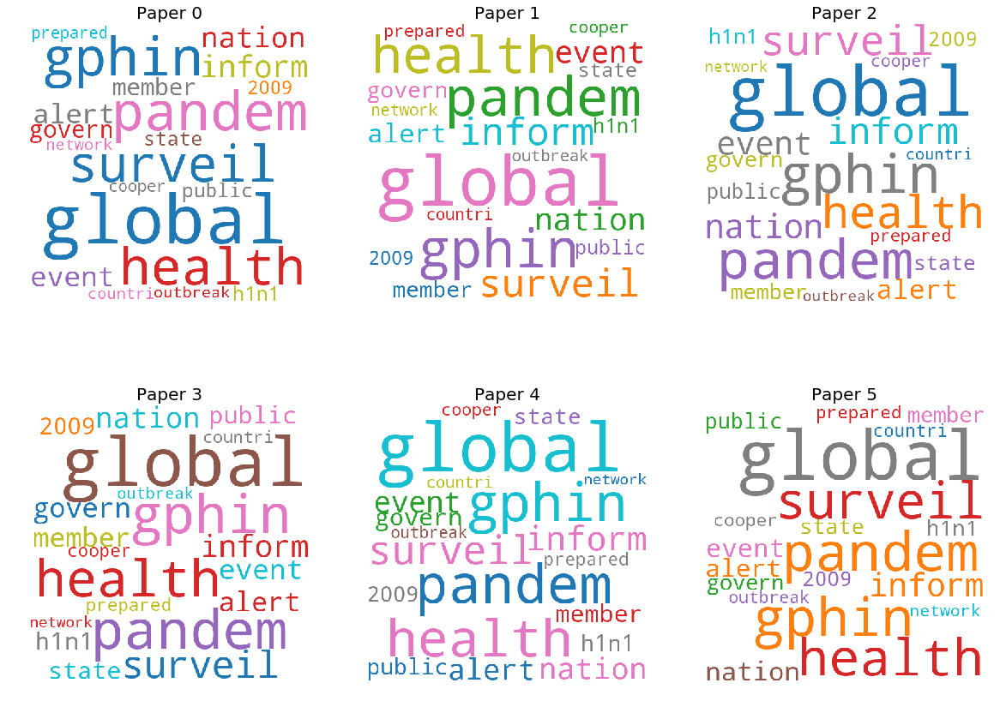

,title,doi,pmcid,pubmed_id,authors
0,The impact of rapid molecular diagnostic testi...,10.5694/mja2.50049,PMC6617970,3.08387e+07,"Wabe, Nasir; Li, Ling; Lindeman, Robert; Yimsu..."
1,New Developments in Rapid Diagnostic Testing f...,10.1016/j.idc.2017.11.006,,2.92692e+07,"Gonzalez, Mark D.; McElvania, Erin"
2,Detection of Influenza A and B Viruses and Res...,10.1128/JCM.00367-18,PMC6018333,,"Azar, Marwan M.; Landry, Marie L."
3,Rapid Multiplex Testing for Upper Respiratory ...,10.1093/ofid/ofz481,PMC7043218,3.21283e+07,"May, Larissa; Tatro, Grant; Poltavskiy, Eduard..."
4,Recombinant Protein-Based Enzyme-Linked Immuno...,10.1128/CDLI.11.2.287-291.2004,PMC371224,,"Guan, Ming; Chen, Hsiao Ying; Yun Foo, Shen; T..."
5,Evaluation of a two-stage testing algorithm fo...,10.1016/j.diagmicrobio.2018.03.007,,2.96362e+07,"Gardiner, B.J.; Parker, C.E.V.; Rabson, A.R.; ..."


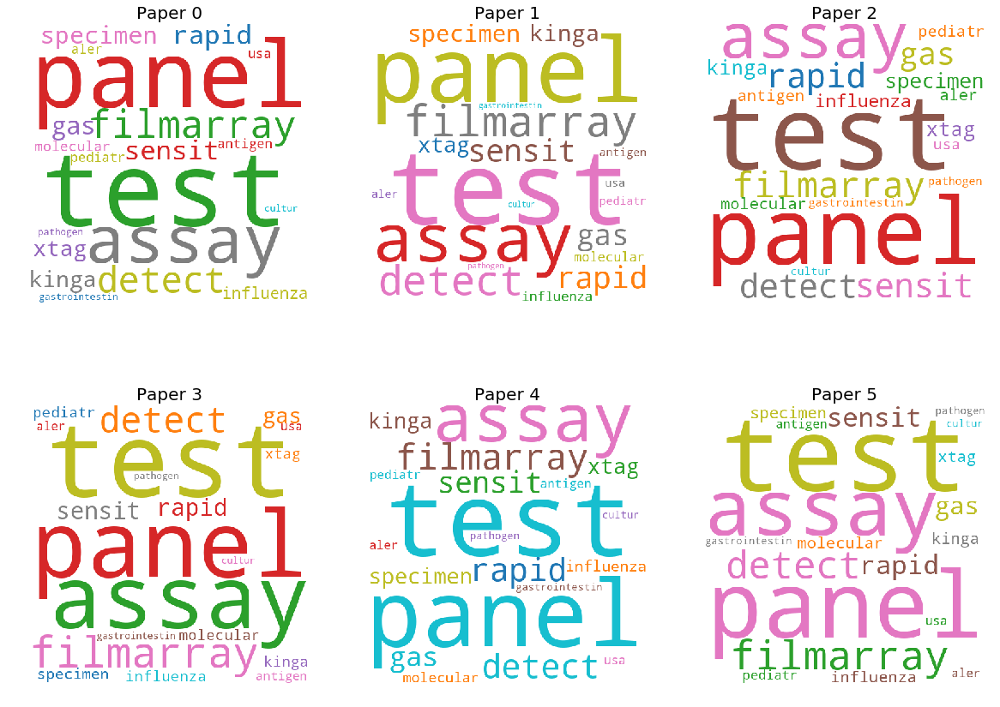

,title,doi,pmcid,pubmed_id,authors
0,Rapid approach to identify an unrecognized vir...,10.1016/j.jviromet.2005.02.016,,,"Hu, Yuan; Hirshfield, Irvin"
1,Chapter 24 Emerging Viruses Their Diseases and...,10.1016/B978-012200741-5/50026-X,,,"Kellam, Paul"
2,Chapter 2 Omics Approaches in Viral Biotechnol...,10.1016/B978-0-12-815870-8.00002-4,,,"Waqar, Kinza; Irfan, Rija; Gul, Alvina"
3,Metagenomics and the molecular identification ...,10.1016/j.tvjl.2010.10.014,,2.11116e+07,"Bexfield, Nicholas; Kellam, Paul"
4,Key data for outbreak evaluation: building on ...,10.1098/rstb.2016.0371,PMC5394647,2.83965e+07,"Cori, Anne; Donnelly, Christl A.; Dorigatti, I..."
5,Chapter 47 Issues and Challenges for Clinical ...,10.1016/B978-0-12-382167-6.00047-3,,,"Olopade, Christopher O.; Olugbile, Sope; Olopa..."


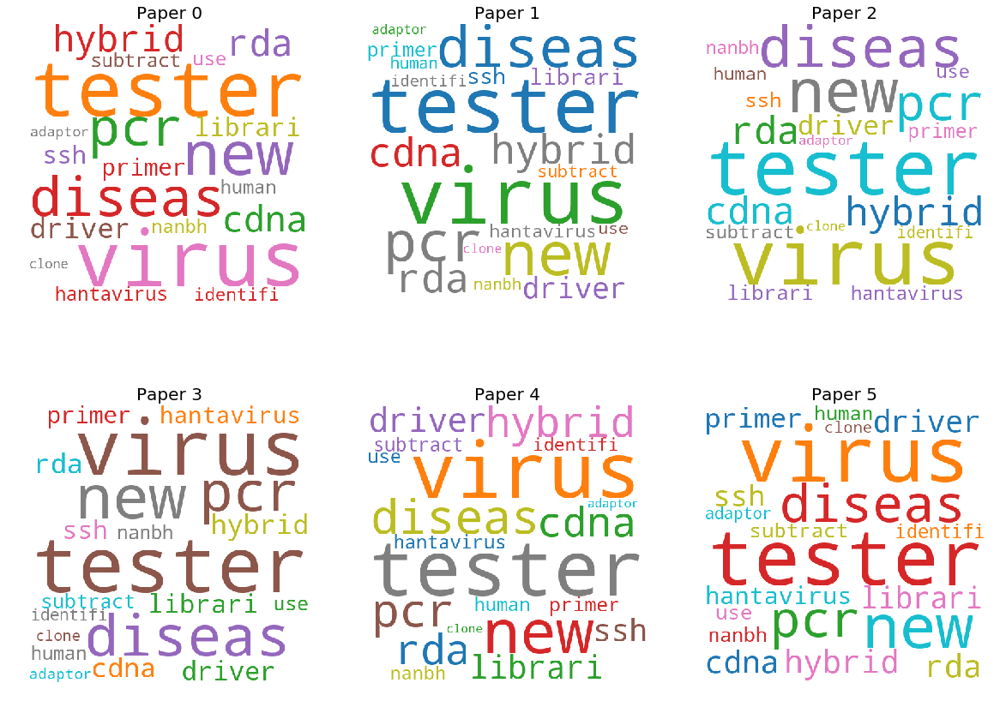

,title,doi,pmcid,pubmed_id,authors
0,Infectious disease and economics: The case for...,10.1016/j.onehlt.2018.100080,PMC6330263,3.06715e+07,"Smith, Kristine M.; Machalaba, Catherine C.; S..."
1,Research and Development of New Vaccines Again...,,PMC1448562,,"Kieny, Marie Paule; Excler, Jean-Louis; Girard..."
2,National inventory of emergency departments in...,10.1186/1865-1380-5-38,PMC3518169,2.31141e+07,"Wen, Leana S; Venkataraman, Anantharaman; Sull..."
3,Inorganic Complexes and Metal-Based Nanomateri...,10.1021/acs.chemrev.8b00136,PMC6348445,3.05118e+07,"Markwalter, Christine\nF.; Kantor, Andrew G.; ..."
4,Development and Preliminary Evaluation of a Ra...,10.1128/JCM.01487-09,PMC2863916,,"Pérez-Ruiz, Mercedes; Navarro-Marí, José-María..."
5,The political economy of healthcare reform in ...,10.1186/2193-1801-2-448,PMC3776089,2.40529e+07,"Daemmrich, Arthur"


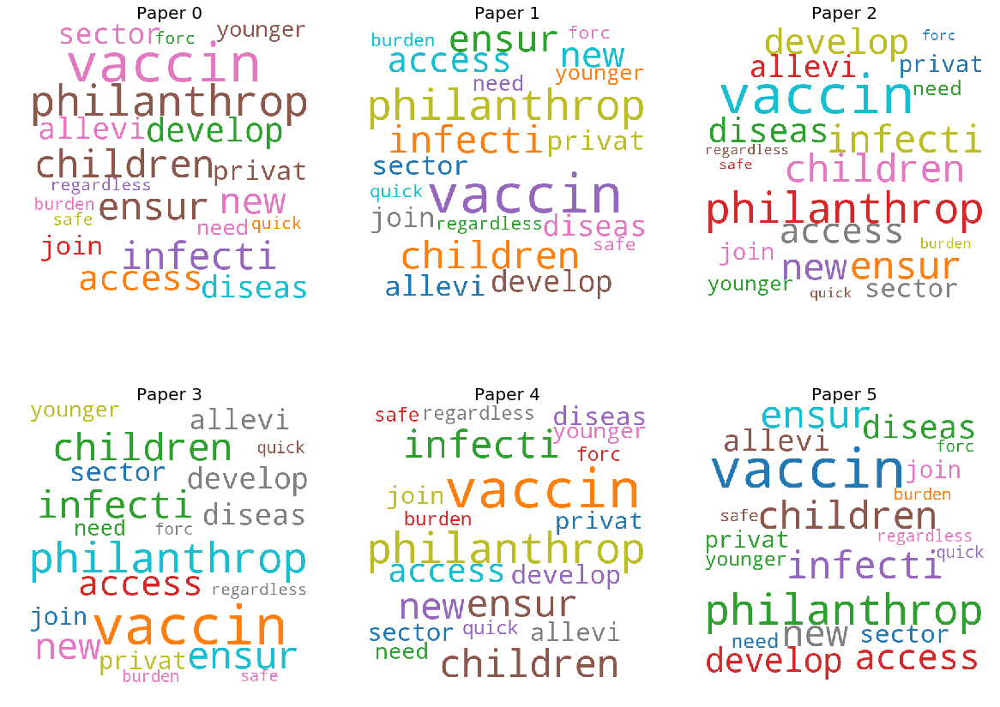

,title,doi,pmcid,pubmed_id,authors
0,Evolution and public health,10.1073/pnas.0906198106,PMC2868289,,"Omenn, Gilbert S."
1,Co-lethality studied as an asset against viral...,10.1186/1745-6150-5-40,PMC2898770,2.05658e+07,"Brouillet, Sophie; Valere, Thomas; Ollivier, E..."
2,Development and Evaluation of Novel Real-Time ...,10.1128/JCM.01224-15,PMC4508434,,"Chan, Jasper Fuk-Woo; Choi, Garnet Kwan-Yue; T..."
3,Genetic Drift of HIV Populations in Culture,10.1371/journal.pgen.1000431,PMC2652835,1.93005e+07,"Voronin, Yegor; Holte, Sarah; Overbaugh, Julie..."
4,Coronavirus crisis hits ice-locked Arctic rese...,10.1038/d41586-020-00724-y,,,"Viglione, Giuliana"
5,The acetone-butanol fermentation and related t...,10.1016/0167-7799(84)90025-8,,,"Woods, D.R."


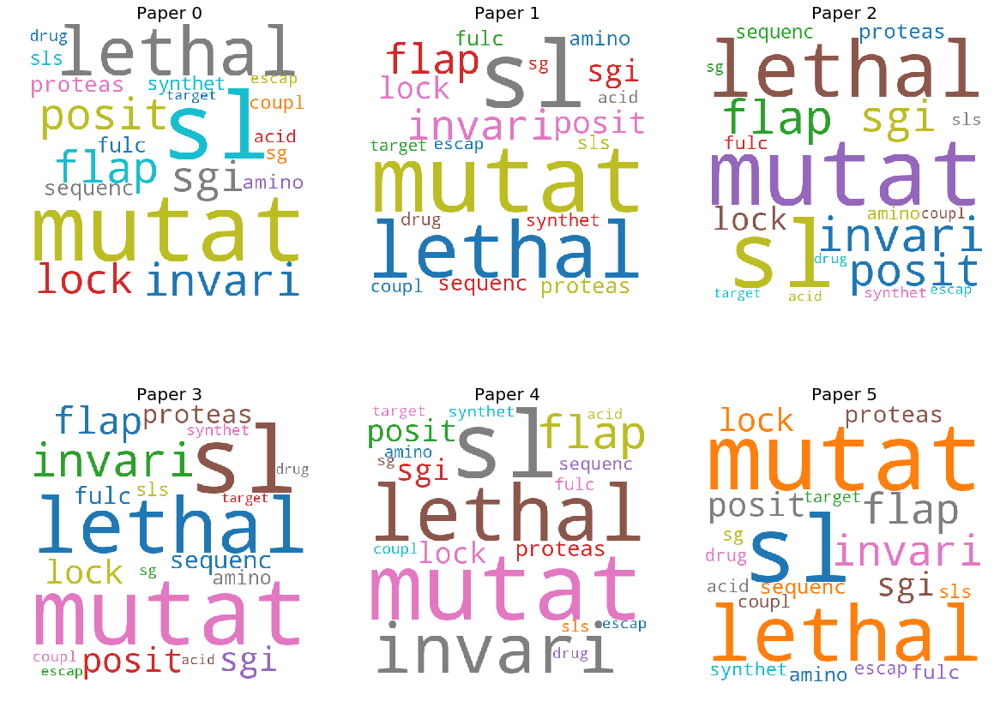

,title,doi,pmcid,pubmed_id,authors
0,Licking latency with licorice,10.1172/JCI200524507,PMC1052015,,"Cohen, Jeffrey I."
1,Alternative promoters drive human cytomegalovi...,10.1073/pnas.1900783116,PMC6717278,,"Collins-McMillen, Donna; Rak, Mike; Buehler, J..."
2,Chapter 13 Recent Advances and Future Needs in...,10.1016/S0168-7069(07)17013-0,,,"Wong, Mark; Xagoraraki, Irene; Rose, Joan B."
3,The abundant latency-associated transcripts of...,,PMC191416,,"Goldenberg, D; Mador, N; Ball, M J; Panet, A; ..."
4,Latent viral infections of the nervous system:...,10.1016/j.neurol.2009.09.010,,1.99064e+07,"Lafon, M."
5,Vaccine Strategies,10.1016/B978-012374410-4.00597-5,,,"Kusters, I.; Almond, J.W."


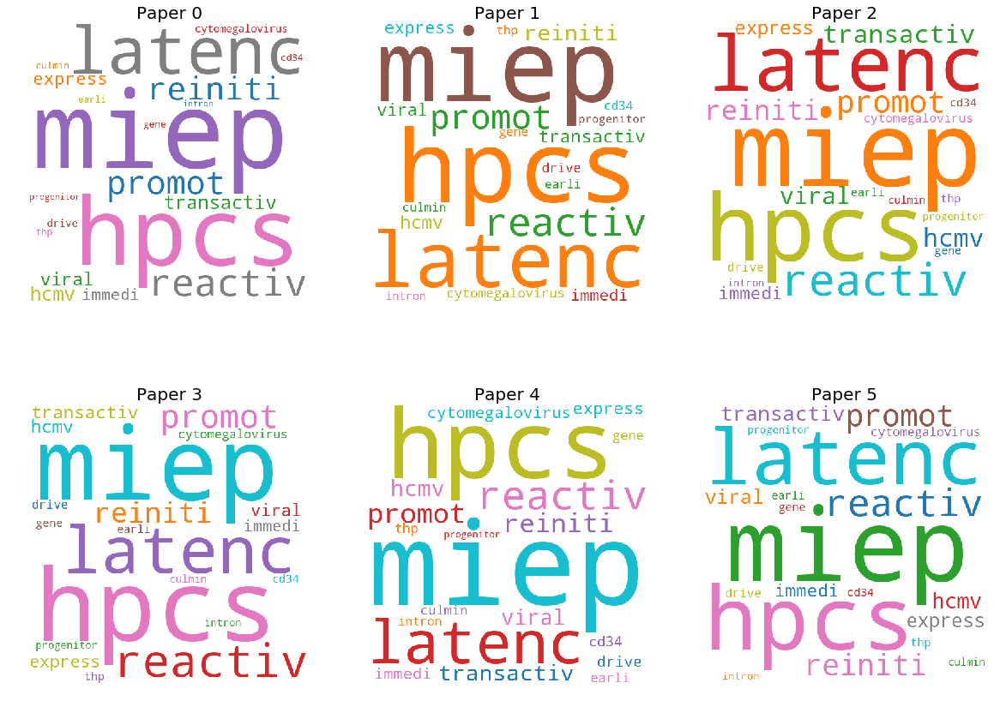

,title,doi,pmcid,pubmed_id,authors
0,Chapter 97 Emerging Viral Infections,10.1016/B978-0-12-382227-7.00097-5,,,"Osterhaus, Albert D.M.E.; Smits, Saskia L."
1,Chapter 22 What Lies Ahead? Scientists Look in...,10.1016/B978-0-12-800964-2.00022-7,,,
2,Treatable traits and therapeutic targets: Goal...,10.1016/j.coisb.2017.04.003,,,"Russell, Clark D.; Baillie, J. Kenneth"
3,Genomics and infectious disease: a call to ide...,10.1186/s13073-014-0106-2,PMC4295297,2.55936e+07,"Geller, Gail; Dvoskin, Rachel; Thio, Chloe L; ..."
4,CHAPTER 31 Translating Innovation in Diagnosti...,10.1016/B978-0-12-369420-1.00031-7,,,"Brown, Matthew P.; Lai-Goldman, Myla; Billings..."
5,A Systems Biology Approach to Infectious Disea...,10.1128/mBio.00325-10,PMC3034460,2.12854e+07,"Aderem, Alan; Adkins, Joshua N.; Ansong, Charl..."


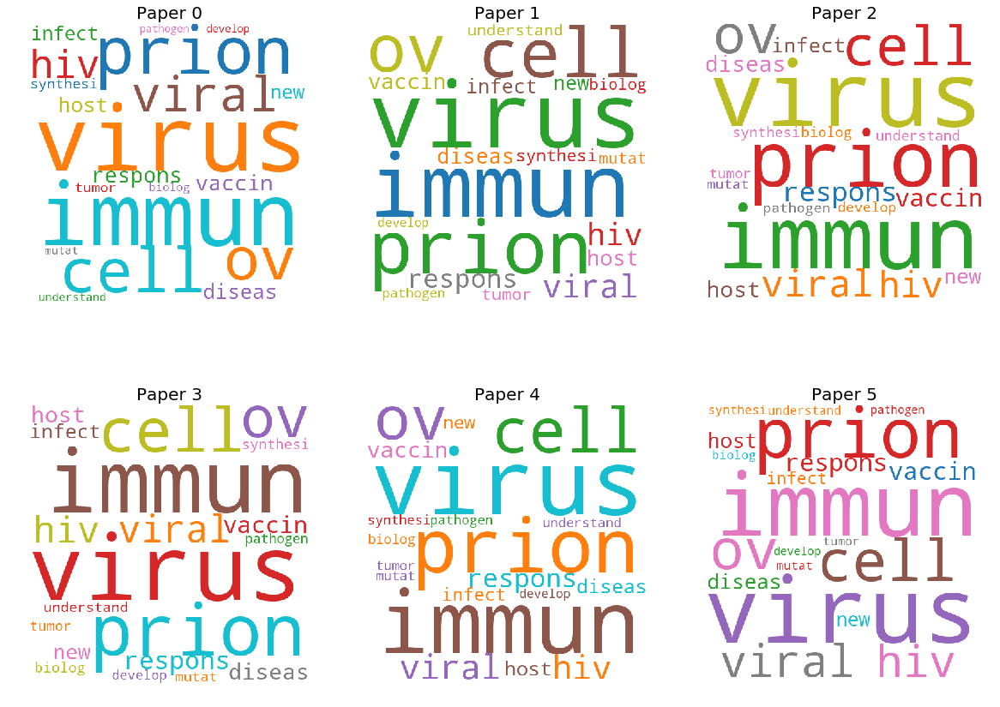

,title,doi,pmcid,pubmed_id,authors
0,Entry screening for severe acute respiratory s...,10.1136/bmj.38573.696100.3A,PMC1289362,,"Pitman, R J; Cooper, B S; Trotter, C L; Gay, N..."
1,Harm reduction policy in Taiwan: toward a comp...,10.1186/s12954-016-0101-6,PMC4819272,2.70444e+07,"Chen, Jia-shin"
2,The determinants of the 1999 and 2007 Chinese ...,10.1016/j.tourman.2009.10.003,,,"York, Qi Yan; Zhang, Hanqin Qiu"
3,Policy Address(),,PMC4716959,,"YOKOKURA, Yoshitake"
4,Identifying Cost-Effective Dynamic Policies to...,10.1002/sim.7047,PMC5096998,,"Yaesoubi, Reza; Cohen, Ted"
5,Uncertain Benefit: The Public Policy of Approv...,,PMC1448369,,"Quigley, Rosemary B"


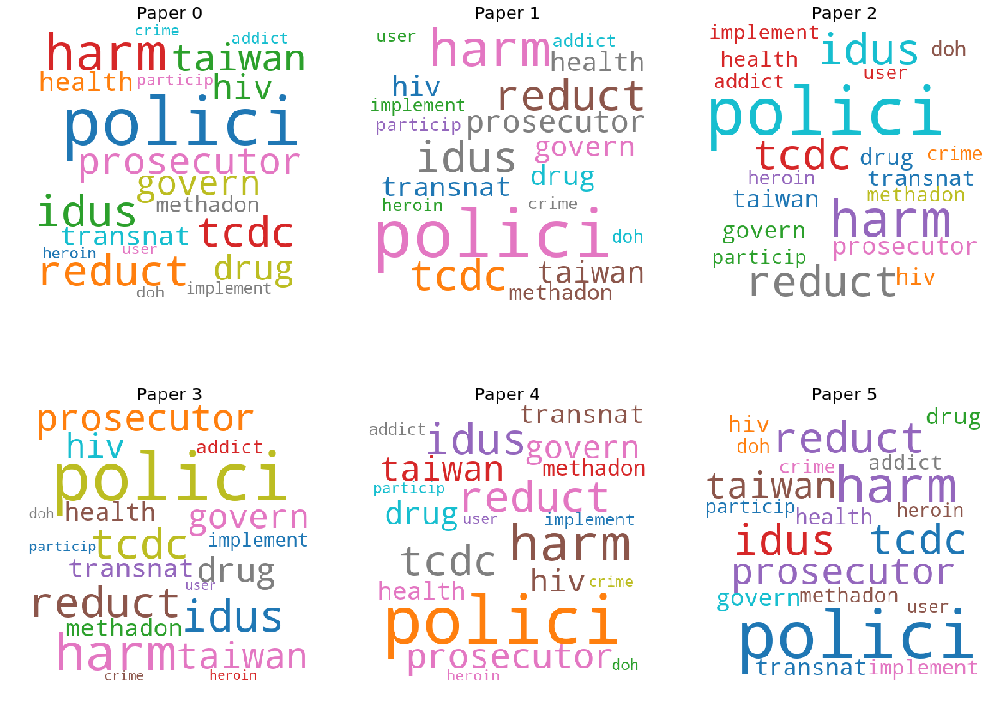

,title,doi,pmcid,pubmed_id,authors
0,Chapter 27 Disaster Mitigation,10.1016/B978-0-323-28665-7.00027-3,,,"Gougelet, Robert M."
1,Chapter 21 Disaster Mitigation,10.1016/B978-0-323-03253-7.50028-5,,,"Gougelet, Robert M."
2,Economic optimization of a global strategy to ...,10.1073/pnas.1412661112,PMC4284561,,"Pike, Jamison; Bogich, Tiffany; Elwood, Sarah;..."
3,Conceptualising the technical relationship of ...,10.1186/1472-6963-11-225,PMC3189394,2.19298e+07,"Häsler, Barbara; Howe, Keith S; Stärk, Kathari..."
4,Predictive and Reactive Distribution of Vaccin...,10.1155/2011/579597,PMC3447295,2.30747e+07,"Uribe-Sánchez, Andrés; Savachkin, Alex"
5,National and international policies to mitigat...,10.1098/rstb.2011.0373,PMC3427563,,"Dye, Christopher"


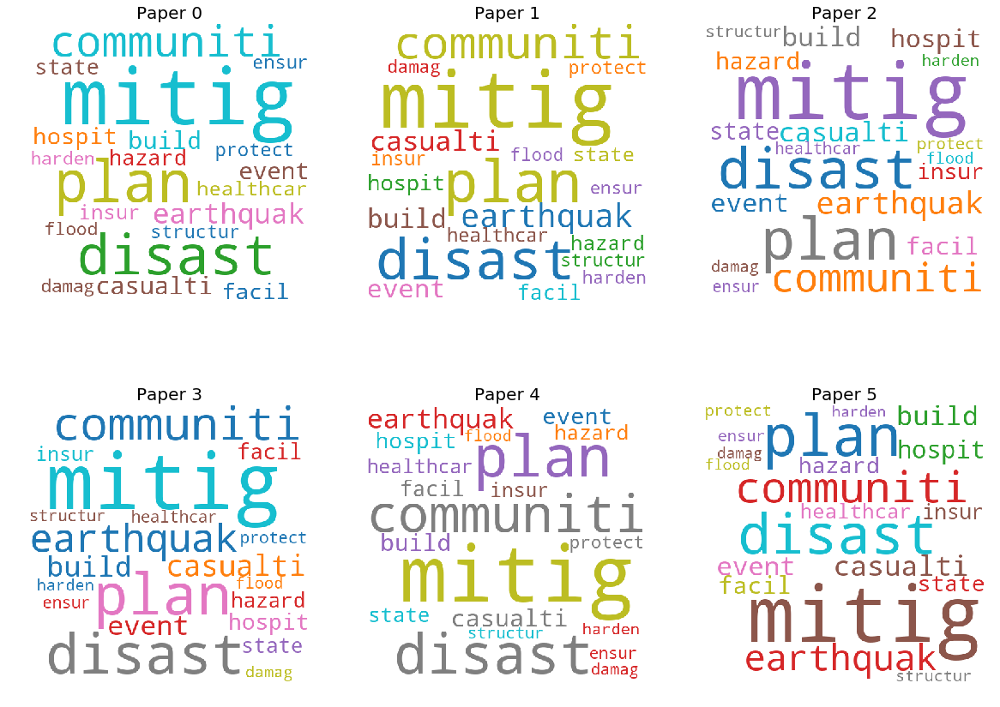

,title,doi,pmcid,pubmed_id,authors
0,Roadmap to developing a recombinant coronaviru...,10.1586/erv.12.126,PMC3586247,,"Jiang, Shibo; Bottazzi, Maria Elena; Du, Lanyi..."
1,Modelling the Economic Impact and Ripple Effec...,10.1007/s41660-020-00113-y,,,"Yu, Krista Danielle S.; Aviso, Kathleen B."
2,Improving vaccine trials in infectious disease...,10.1126/science.aam8334,PMC5568786,,"Lipsitch, Marc; Eyal, Nir"
3,Outbreak response as an essential component of...,10.1016/S1473-3099(19)30305-6,,3.1257e+07,"Hatchett, Richard; Lurie, Nicole"
4,Building a Multi-Institutional and Interdiscip...,10.3389/fpubh.2018.00167,PMC6008525,2.99515e+07,"Olea-Popelka, Francisco; Fujiwara, Paula I."
5,International Biological Reference Preparation...,10.3201/eid2502.180798,PMC6346470,3.06669e+07,"Rampling, Tommy; Page, Mark; Horby, Peter"


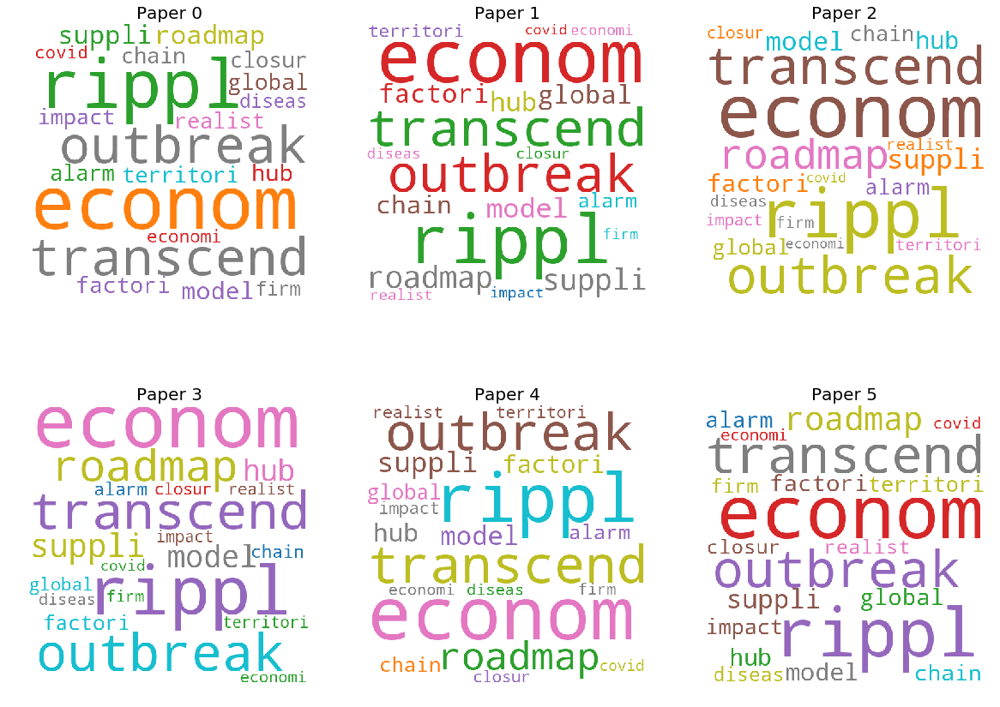

,title,doi,pmcid,pubmed_id,authors
0,Vaccines for epidemic infections and the role ...,10.1080/21645515.2017.1306615,PMC5718831,,"Plotkin, Stanley A."
1,Funding vaccines for emerging infectious diseases,10.1080/21645515.2017.1412024,PMC6067896,,"Wong, Gary; Qiu, Xiangguo"
2,Emergency Preparedness and the Development of ...,10.1016/j.cnur.2016.07.013,,2.78636e+07,"Kim, Deborah H."
3,Bending the epidemic curve: advancements and o...,10.1017/S095026881900058X,PMC6518771,3.09555e+07,"Desai, Angel N.; Madoff, Lawrence C."
4,"“What, me worry?” Businesses and AIDS at Davos",10.1016/S0140-6736(05)74792-9,,1.58114e+07,"Kimball, AM; Thant, Myo"
5,"Vaccines, inspiring innovation in health()",10.1016/j.vaccine.2018.05.035,PMC6238075,2.97892e+07,"Pagliusi, Sonia; Dennehy, Maureen; Kim, Hun"


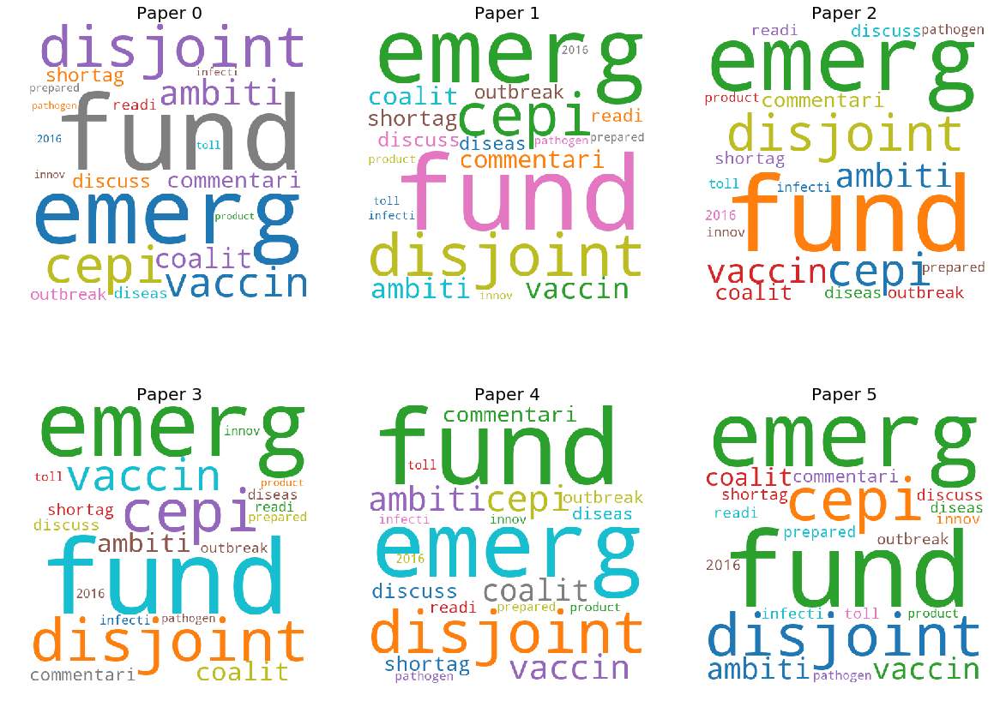

,title,doi,pmcid,pubmed_id,authors
0,Era of molecular diagnosis for pathogen identi...,10.1080/22221751.2020.1738905,,,"Ai, Jing-Wen; Zhang, Yi; Zhang, Hao-Cheng; Xu,..."
1,Cutting-Edge Infectious Disease Diagnostics wi...,10.1016/j.chom.2018.05.016,,2.99024e+07,"Chiu, Charles"
2,CRISPR in livestock: From editing to printing,10.1016/j.theriogenology.2020.01.063,,,"Menchaca, A.; dos Santos-Neto, P.C.; Mulet, A...."
3,A CRISPR toolbox to study virus–host interactions,10.1038/nrmicro.2017.29,PMC5800792,,"Puschnik, Andreas S.; Majzoub, Karim; Ooi, Yaw..."
4,CRISPR-Cas Targeting of Host Genes as an Antiv...,10.3390/v10010040,PMC5795453,2.93379e+07,"Chen, Shuliang; Yu, Xiao; Guo, Deyin"
5,Development and Evaluation of A CRISPR-based D...,10.1101/2020.02.22.20025460,,,Tieying Hou; Weiqi Zeng; Minling Yang; Wenjing...


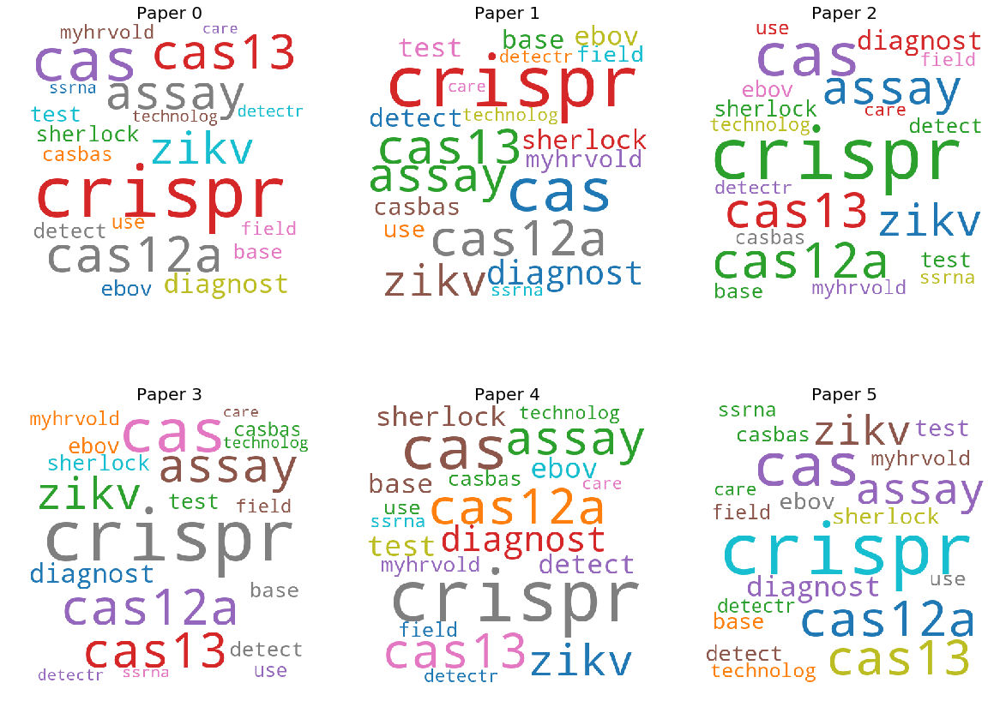

,title,doi,pmcid,pubmed_id,authors
0,Monitoring infectious diseases in the big data...,10.1007/s11434-014-0696-5,,,"Zou, Yuanqiang; Peng, Yousong; Deng, Lizong; J..."
1,CHAPTER 31 Translating Innovation in Diagnosti...,10.1016/B978-0-12-369420-1.00031-7,,,"Brown, Matthew P.; Lai-Goldman, Myla; Billings..."
2,Chapter 30 Molecular Diagnostics and Comparati...,10.1016/B978-0-12-374537-8.00030-4,,,"van Belkum, Alex"
3,New Approach for Phylogenetic Tree Recovery Ba...,10.1089/cmb.2013.0150,PMC4082356,,"Gamermann, Daniel; Montagud, Arnaud; Conejero,..."
4,Rapid point of care diagnostic tests for viral...,10.1016/S1473-3099(14)70827-8,,2.51893e+07,"Zumla, Alimuddin; Al-Tawfiq, Jaffar A; Enne, V..."
5,Molecular diagnostic techniques,10.1383/medc.33.3.26.61126,,,"Fawley, Warren N; Wilcox, Mark H"


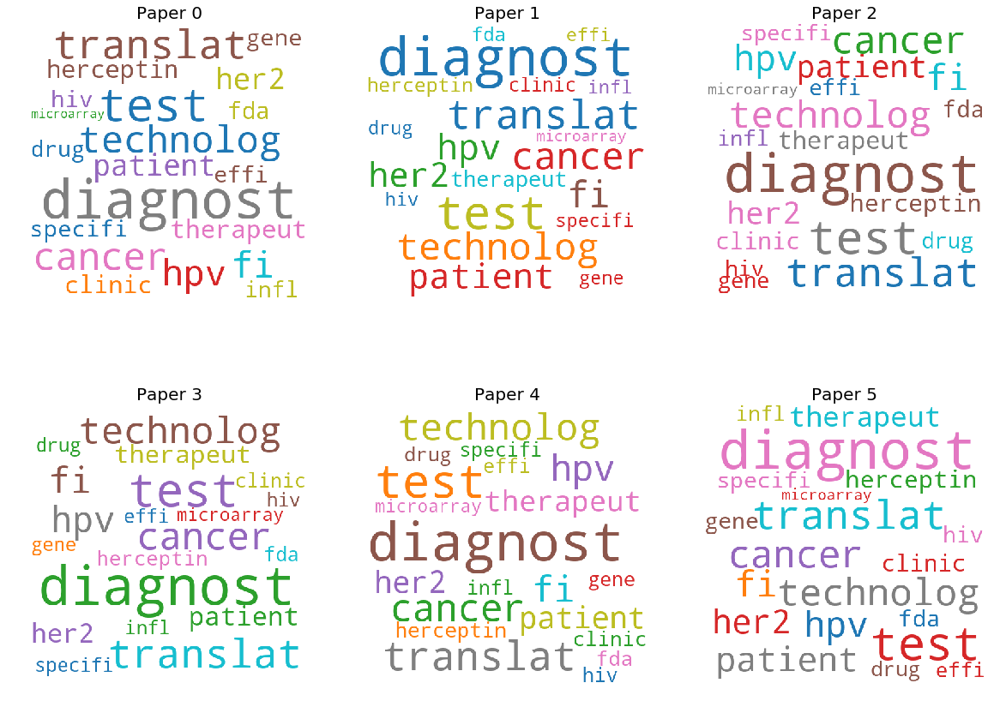

,title,doi,pmcid,pubmed_id,authors
0,Bioinformatics in China: A Personal Perspective,10.1371/journal.pcbi.1000020,PMC2291564,1.84372e+07,"Wei, Liping; Yu, Jun"
1,Building International Genomics Collaboration ...,10.3389/fpubh.2015.00264,PMC4670856,2.66974e+07,"Cui, Helen H.; Erkkila, Tracy; Chain, Patrick ..."
2,Vaccine Target Discovery,10.1016/B978-0-12-809633-8.20100-3,,,"Chong, Li C.; Khan, Asif M."
3,A systematic bioinformatics approach for selec...,10.1016/j.cellimm.2007.02.005,PMC2041846,,"Khan, Asif M.; Miotto, Olivo; Heiny, A.T.; Sal..."
4,Rapid metagenomic characterization of a case o...,10.1101/2020.03.02.968818,,,"Manning, J. E.; Bohl, J. A.; Lay, S.; Chea, S...."
5,"18 Omics, Bioinformatics, and Infectious Disea...",10.1016/B978-0-12-384890-1.00018-2,,,"Paszkiewicz, Konrad H.; Giezen, Mark van der"


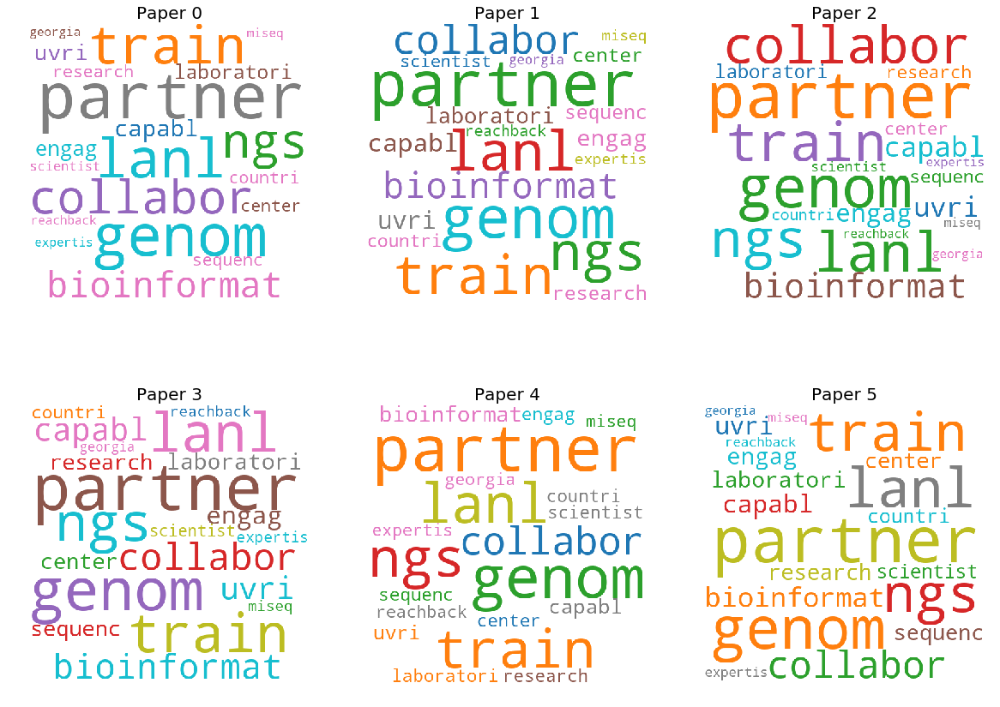

,title,doi,pmcid,pubmed_id,authors
0,Prediction and prevention of the next pandemic...,10.1016/S0140-6736(12)61684-5,PMC3712877,2.32005e+07,"Morse, Stephen S; Mazet, Jonna AK; Woolhouse, ..."
1,Chapter 3 Viral Biothreat Agents,10.1016/B978-0-12-369408-9.00003-2,,,"Anderson, Kevin"
2,Confronting the threat of bioterrorism: realit...,10.1016/S1473-3099(18)30298-6,,3.0341e+07,"Green, Manfred S; LeDuc, James; Cohen, Daniel;..."
3,Chapter 5 Advance detection technologies for s...,10.1016/B978-0-12-812026-2.00005-0,,,"Parida, M.M.; Dash, Paban Kumar; Shukla, Jyoti"
4,Detection of pathogens in water: from phylochi...,10.1016/j.copbio.2011.11.016,,2.2153e+07,"Aw, Tiong Gim; Rose, Joan B"
5,Epidemiologic data and pathogen genome sequenc...,10.1186/s13059-014-0538-4,PMC4282151,2.54181e+07,"Grad, Yonatan H; Lipsitch, Marc"


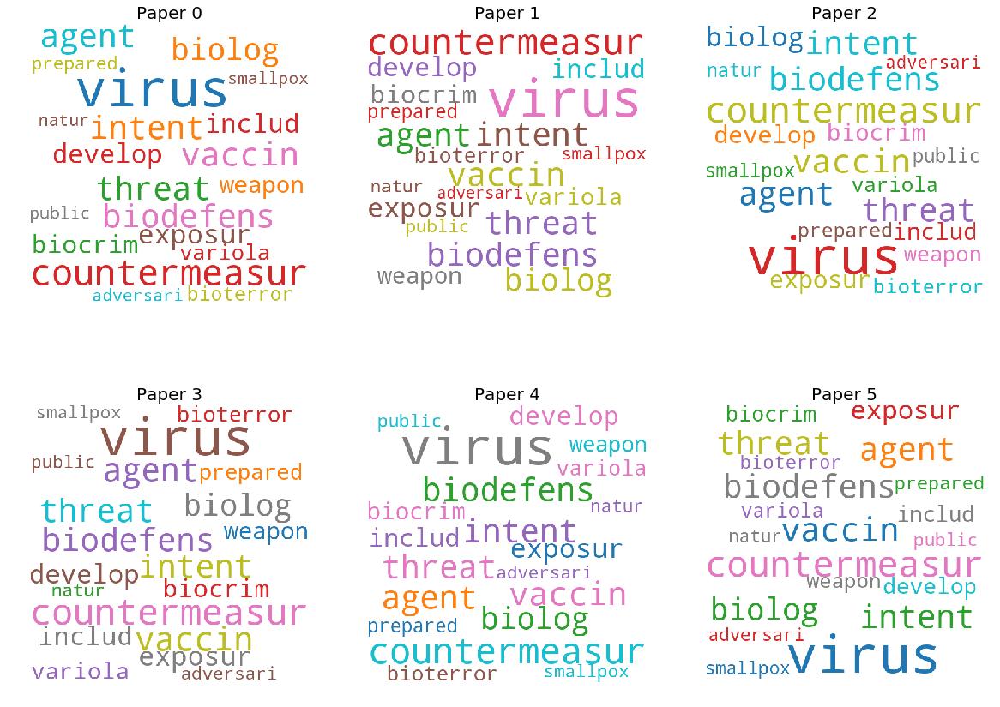

,title,doi,pmcid,pubmed_id,authors
0,Prediction and prevention of the next pandemic...,10.1016/S0140-6736(12)61684-5,PMC3712877,2.32005e+07,"Morse, Stephen S; Mazet, Jonna AK; Woolhouse, ..."
1,One Health proof of concept: Bringing a transd...,10.1016/j.prevetmed.2016.11.023,,2.80346e+07,"Kelly, Terra R.; Karesh, William B.; Johnson, ..."
2,Chapter 8 Zoonoses in Wildlife Integrating Eco...,10.1016/S0065-308X(08)00608-8,,1.92892e+07,"Mathews, Fiona"
3,An Ecological and Conservation Perspective on ...,10.3390/v3040379,PMC3185704,2.19947e+07,"Vandegrift, Kurt J.; Wale, Nina; Epstein, Jona..."
4,"Public Health Threat of New, Reemerging, and N...",10.3201/eid1601.081467,PMC2874344,2.0031e+07,"Cutler, Sally J.; Fooks, Anthony R.; van der P..."
5,Emerging henipaviruses and flying foxes – Cons...,10.1016/j.biocon.2006.04.007,,,"Breed, Andrew C.; Field, Hume E.; Epstein, Jon..."


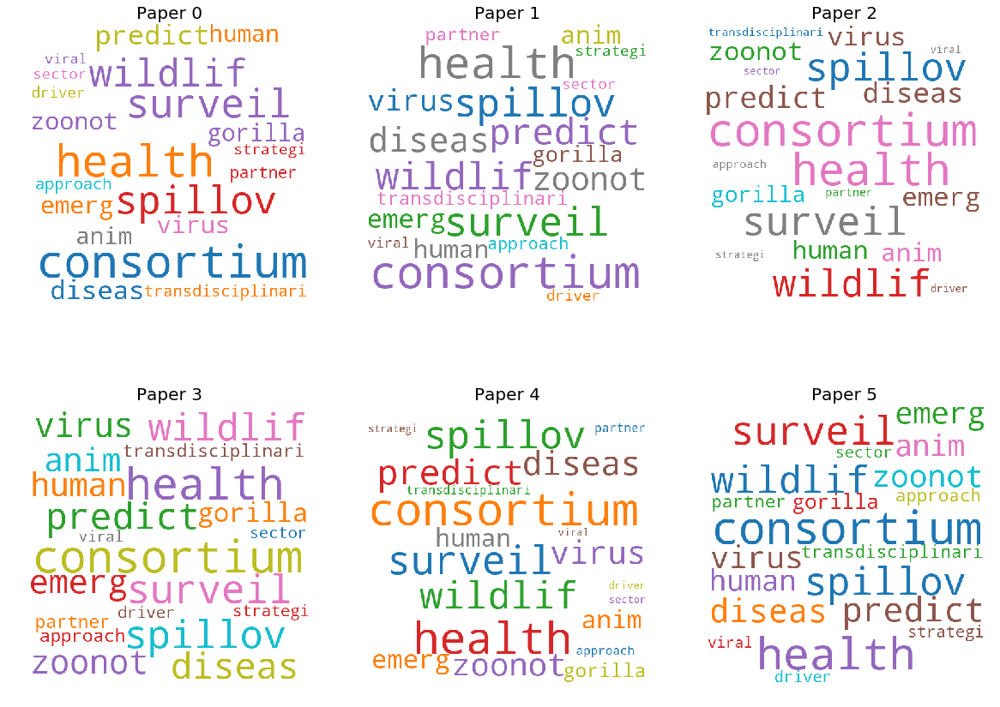

In [15]:
display_topics_results("What do we know about diagnostics and surveillance?")

#  What do we know about non-pharmaceutical interventions?

,title,doi,pmcid,pubmed_id,authors
0,Pandemic preparedness: perceptions of vulnerab...,10.1186/1471-2458-14-665,PMC4090173,2.49739e+07,"Hickey, Jason; Gagnon, Anita J; Jitthai, Nigoon"
1,Unraveling the complexities of disaster manage...,10.1016/j.socscimed.2012.07.040,,2.28987e+07,"O'Sullivan, Tracey L.; Kuziemsky, Craig E.; To..."
2,An optimal control theory approach to non-phar...,10.1186/1471-2334-10-32,PMC2850906,2.01705e+07,"Lin, Feng; Muthuraman, Kumar; Lawley, Mark"
3,Financing of international collective action f...,10.1016/S2214-109X(17)30203-6,,2.85289e+07,"Yamey, Gavin; Schäferhoff, Marco; Aars, Ole Kr..."
4,The impacts of simultaneous disease interventi...,10.1016/j.jtbi.2016.01.027,,,"Andrews, Michael A.; Bauch, Chris T."
5,Coronavirus disease 2019 (covid-19): a guide f...,10.1136/bmj.m800,,,"Razai, Mohammad S.; Doerholt, Katja; Ladhani, ..."


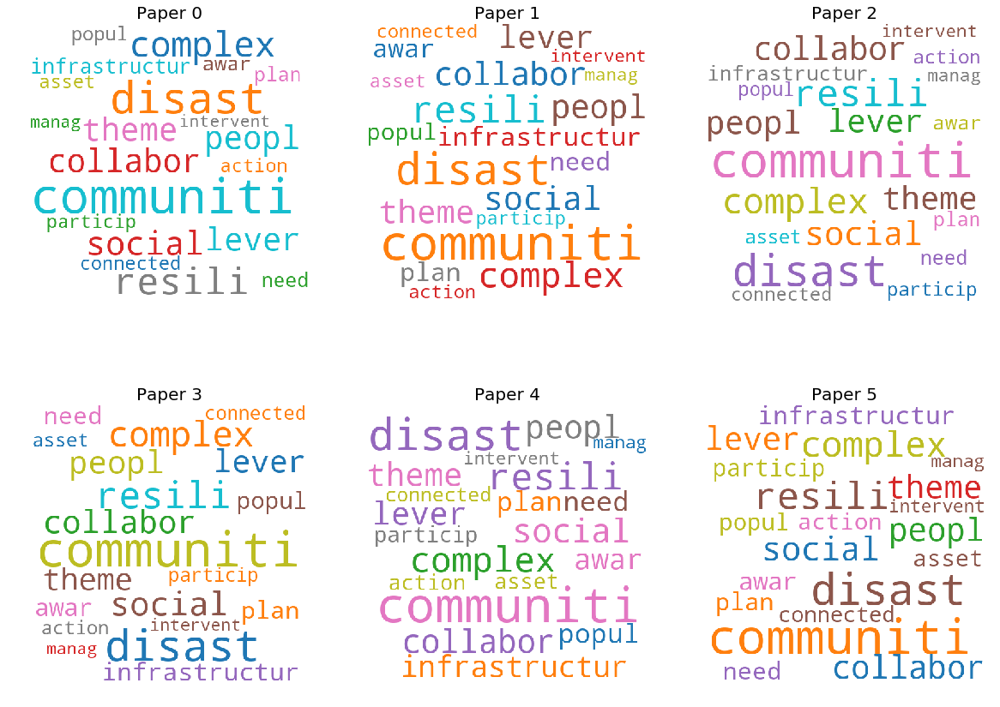

,title,doi,pmcid,pubmed_id,authors
0,Pandemic preparedness: perceptions of vulnerab...,10.1186/1471-2458-14-665,PMC4090173,2.49739e+07,"Hickey, Jason; Gagnon, Anita J; Jitthai, Nigoon"
1,An optimal control theory approach to non-phar...,10.1186/1471-2334-10-32,PMC2850906,2.01705e+07,"Lin, Feng; Muthuraman, Kumar; Lawley, Mark"
2,Predicting support for non-pharmaceutical inte...,10.1111/disa.12089,PMC4355939,,"Pillemer, Francesca Matthews; Blendon, Robert ..."
3,The impacts of simultaneous disease interventi...,10.1016/j.jtbi.2016.01.027,,,"Andrews, Michael A.; Bauch, Chris T."
4,Effect of non-pharmaceutical interventions for...,10.1101/2020.03.03.20029843,,,Shengjie Lai; Nick W Ruktanonchai; Liangcai Zh...
5,Gammaherpesviral Gene Expression and Virion Co...,10.1371/journal.ppat.1003882,PMC3894220,2.4454e+07,"Abernathy, Emma; Clyde, Karen; Yeasmin, Rukhsa..."


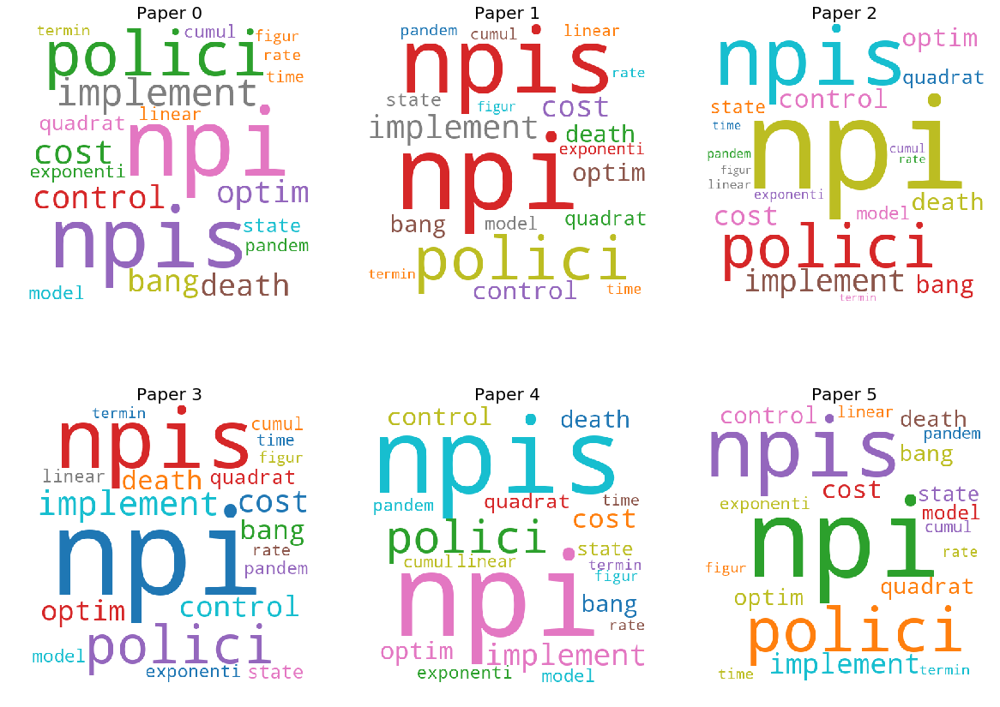

,title,doi,pmcid,pubmed_id,authors
0,Covid-19: school closures and bans on mass gat...,10.1136/bmj.m806,,3.21117e+07,"Moberly, T."
1,The effectiveness of full and partial travel b...,10.1101/2020.03.09.20032045,,,Valentina Costantino; David James Heslop; Chan...
2,Ban on gain-of-function studies ends,10.1016/S1473-3099(18)30006-9,,2.9413e+07,"Burki, Talha"
3,Coronavirus: why a permanent ban on wildlife t...,10.1038/d41586-020-00377-x,,,"Ribeiro, Joana; Bingre, Pedro; Strubbe, Dieder..."
4,Canada fury at WHO ban,10.1016/S0140-6736(03)13256-4,,1.27379e+07,"Kondro, Wayne"
5,China: clamp down on violations of wildlife tr...,10.1038/d41586-020-00378-w,,,"Zhou, Z. M.; Buesching, C. D.; Macdonald, D. W..."


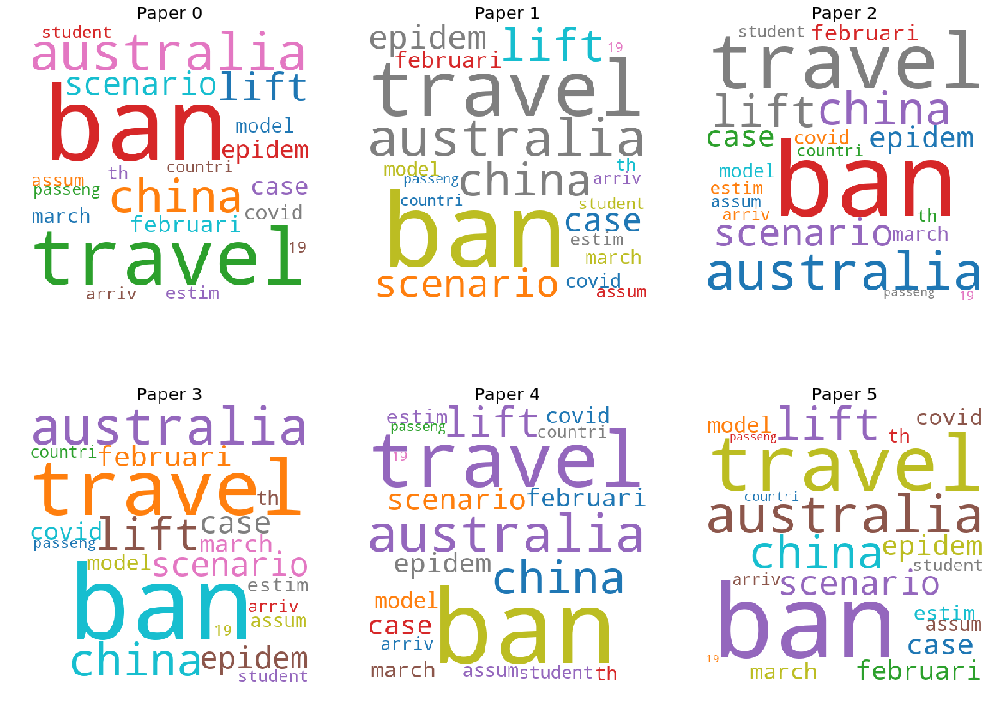

,title,doi,pmcid,pubmed_id,authors
0,Moving beyond hand hygiene monitoring as a mar...,10.1016/j.ajic.2019.06.014,,3.13584e+07,"Jeanes, Annette; Coen, Pietro G.; Drey, Nicola..."
1,Respiratory hygiene in emergency departments: ...,10.1016/j.ajic.2011.12.019,,2.25031e+07,"Martel, Julie; Bui-Xuan, Eva-Flore; Carreau, A..."
2,"The individual, environmental, and organizatio...",10.1016/j.ajic.2007.12.004,,1.87865e+07,"Nichol, Kathryn; Bigelow, Philip; O'Brien-Pall..."
3,Protecting health care workers from SARS and o...,10.1016/j.ajic.2004.11.003,,,"Moore, David; Gamage, Bruce; Bryce, Elizabeth;..."
4,An Intervention to Improve Compliance with Tra...,10.1016/j.jemermed.2010.02.034,,2.04522e+07,"May, Larissa; Lung, Derrick; Harter, Katherine"
5,The use of facemasks to prevent respiratory in...,10.11622/smedj.2014037,PMC4293989,,"Sim, Shin Wei; Moey, Kirm Seng Peter; Tan, Ngi..."


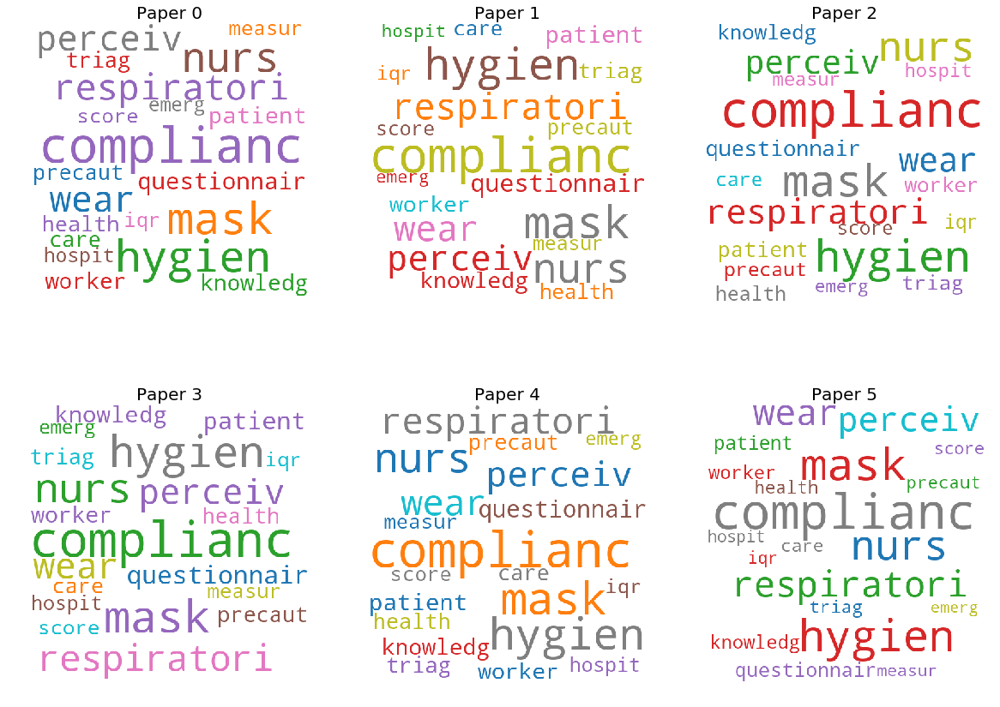

,title,doi,pmcid,pubmed_id,authors
0,Beware of asymptomatic transmission: Study on ...,10.1101/2020.01.28.923169,,,"Shao, P.; Shan, Y."
1,Development of a Nucleocapsid-Based Human Coro...,10.1128/CVI.00124-08,PMC2593164,,"Severance, Emily G.; Bossis, Ioannis; Dickerso..."
2,Viral infections in relation to age and the at...,10.1016/S0091-6749(03)81027-8,,,"Carper, H.T.; Murphy, D.D.; Steinke, J.W.; Sha..."
3,Medical Care for Undocumented Immigrants Natio...,10.1016/j.pop.2016.09.005,,2.81648e+07,"Beck, Teresa L.; Le, Thien-Kim; Henry-Okafor, ..."
4,Medical Care for Undocumented Immigrants Natio...,10.1016/j.cpha.2018.08.002,,,"Beck, Teresa L.; Le, Thien-Kim; Henry-Okafor, ..."
5,Necessity of a more standardized virological c...,10.1016/0197-4580(91)90119-5,,1.7919e+06,"van der Logt, Joseph T.M."


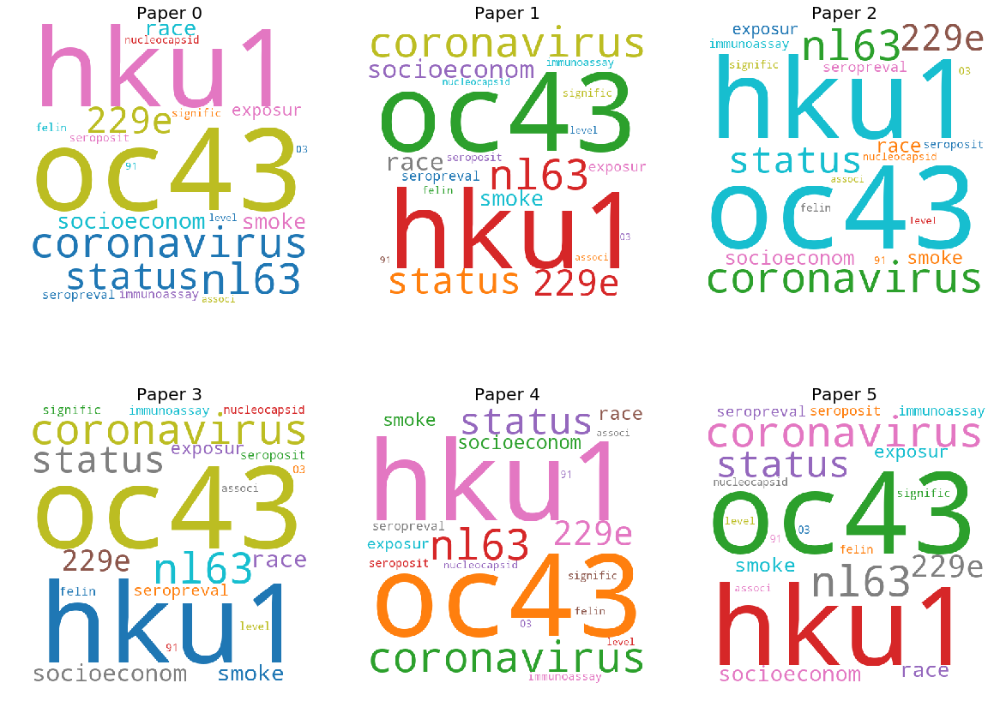

,title,doi,pmcid,pubmed_id,authors
0,An optimal control theory approach to non-phar...,10.1186/1471-2334-10-32,PMC2850906,2.01705e+07,"Lin, Feng; Muthuraman, Kumar; Lawley, Mark"
1,Predicting support for non-pharmaceutical inte...,10.1111/disa.12089,PMC4355939,,"Pillemer, Francesca Matthews; Blendon, Robert ..."
2,Pandemic preparedness: perceptions of vulnerab...,10.1186/1471-2458-14-665,PMC4090173,2.49739e+07,"Hickey, Jason; Gagnon, Anita J; Jitthai, Nigoon"
3,The impacts of simultaneous disease interventi...,10.1016/j.jtbi.2016.01.027,,,"Andrews, Michael A.; Bauch, Chris T."
4,Effect of non-pharmaceutical interventions for...,10.1101/2020.03.03.20029843,,,Shengjie Lai; Nick W Ruktanonchai; Liangcai Zh...
5,mHealth Technology Use and Implications in His...,10.2196/mhealth.8383,PMC6028762,2.99149e+07,"Anderson-Lewis, Charkarra; Darville, Gabrielle..."


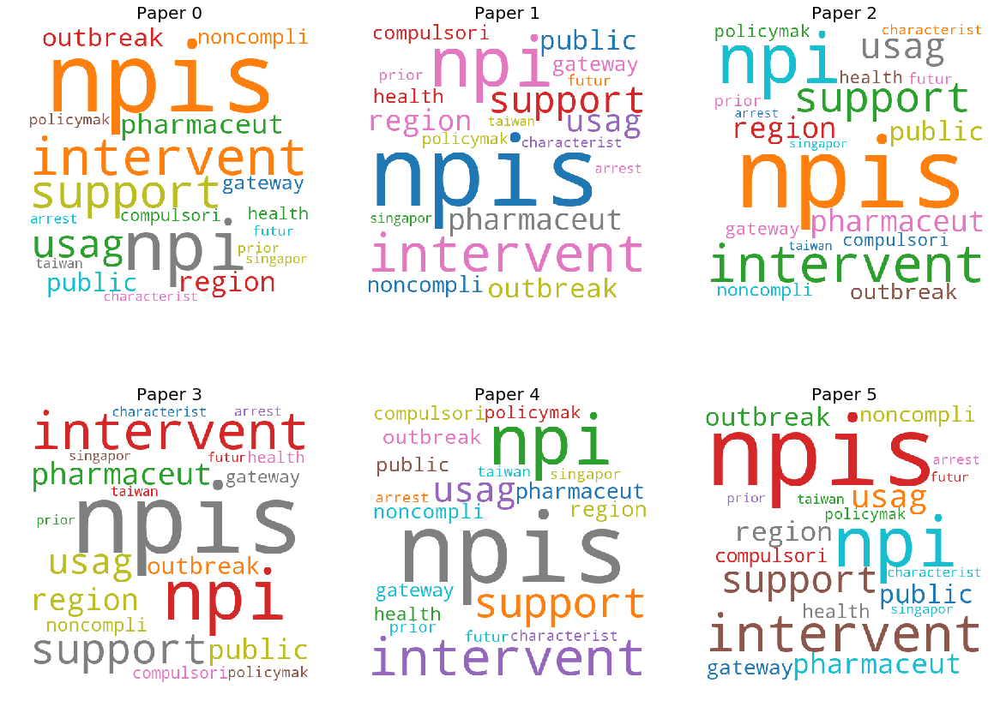

,title,doi,pmcid,pubmed_id,authors
0,Self-reported anticipated compliance with phys...,10.1186/1471-2458-10-138,PMC2847980,2.02334e+07,"Brown, Lawrence H; Aitken, Peter; Leggat, Pete..."
1,Imported malaria in the UK,10.1136/bmj.a135,PMC2453247,,"Zuckerman, Jane N"
2,Public health measures during an anticipated i...,,PMC3270909,2.23122e+07,"Taylor, Melanie; Raphael, Beverley; Barr, Marg..."
3,Reassuring and managing patients with concerns...,10.1186/1471-2458-10-451,PMC2919480,2.06782e+07,"Rubin, G James; Amlôt, Richard; Carter, Holly;..."
4,Knowledge about pandemic influenza and complia...,10.2471/BLT.08.060772,PMC2733278,,"Eastwood, Keith; Durrheim, David; Francis, J L..."
5,Public perceptions of non-pharmaceutical inter...,10.1186/1471-2458-14-589,PMC4063987,2.49204e+07,"Teasdale, Emma; Santer, Miriam; Geraghty, Adam..."


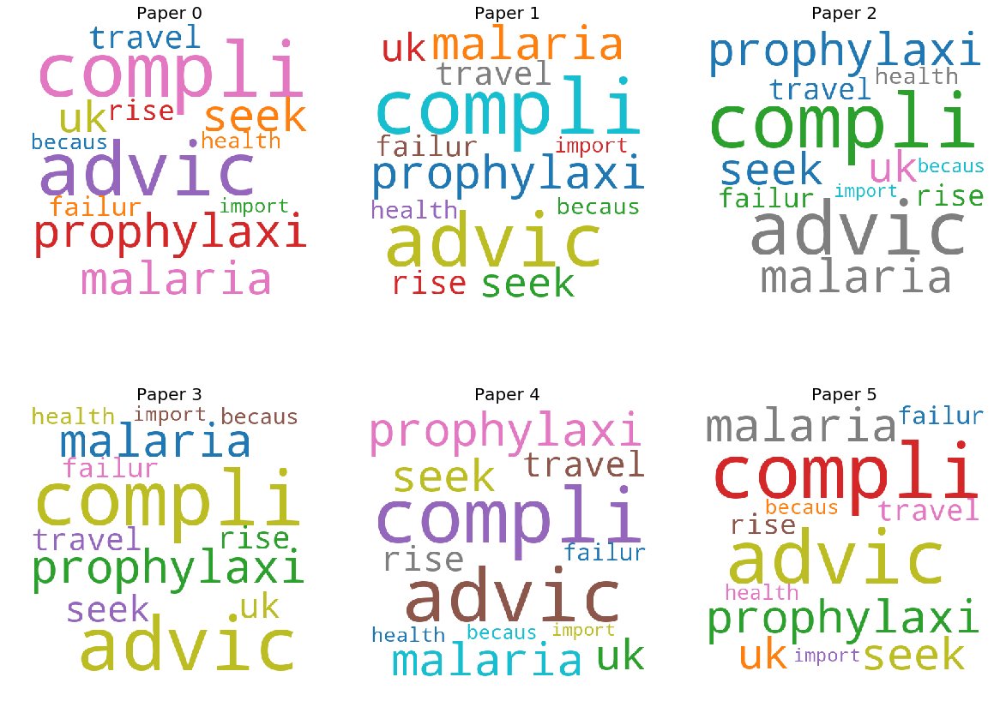

,title,doi,pmcid,pubmed_id,authors
0,Ethics of Clinical Science in a Public Health ...,10.1080/15265161.2013.813597,PMC4151792,2.39528e+07,"Edwards, Sarah J. L."
1,Macroeconomic Effect of Infectious Disease Out...,10.1016/B978-0-12-375678-7.00608-8,,,"Keogh-Brown, M.R."
2,The influenza A(H1N1) epidemic in Mexico. Less...,10.1186/1478-4505-7-21,PMC2765941,1.97857e+07,"Córdova-Villalobos, José A; Sarti, Elsa; Arzoz..."
3,Chapter 28 Surge Capacity,10.1016/B978-0-323-03253-7.50035-2,,,"Casani, Julie Ann P.; Romanosky, Albert J."
4,Chapter 10 Cold-Chain Systems in China and Val...,10.1016/B978-0-12-813830-4.00009-5,,,"Wang, Kelly Yujie; Yip, Tsz Leung"
5,Predictive and Reactive Distribution of Vaccin...,10.1155/2011/579597,PMC3447295,2.30747e+07,"Uribe-Sánchez, Andrés; Savachkin, Alex"


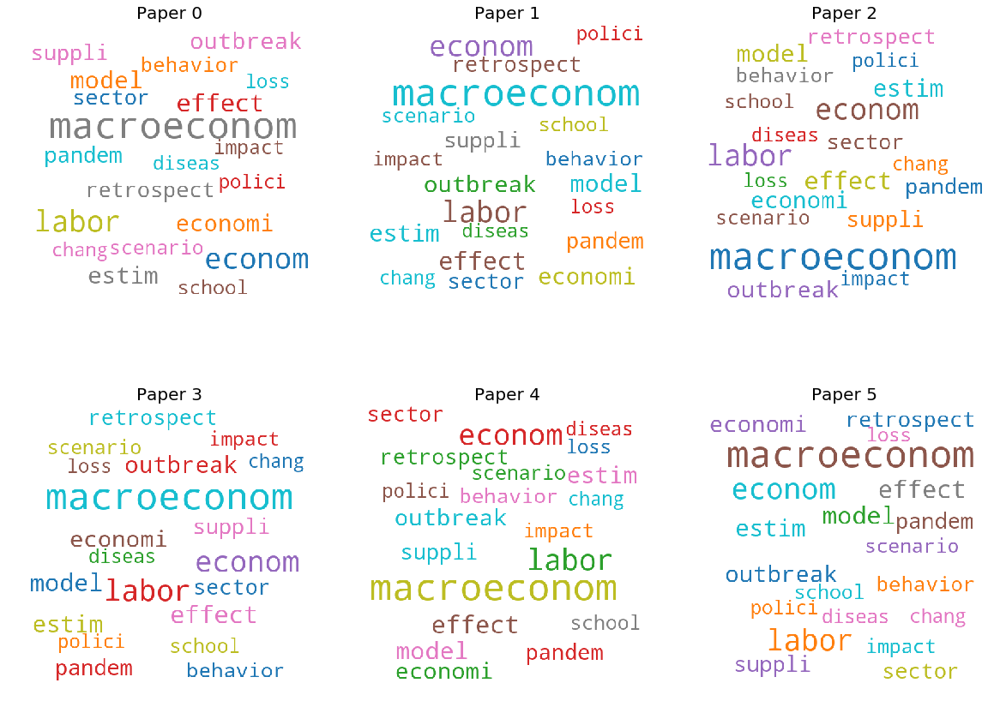

In [16]:
display_topics_results("What do we know about non-pharmaceutical interventions?")

# What has been published about medical care?

,title,doi,pmcid,pubmed_id,authors
0,Preventing infections in non-hospital settings...,,PMC2631702,1.12947e+07,"Nicolle, L. E."
1,Health care facility and community strategies ...,10.1016/j.annemergmed.2004.04.011,,1.53321e+07,"Hick, John L.; Hanfling, Dan; Burstein, Jonath..."
2,Isolation Facilities for Highly Infectious Dis...,10.1371/journal.pone.0100401,PMC4211666,2.53508e+07,"Schilling, Stefan; Fusco, Francesco Maria; De ..."
3,Long-Term Care Facilities and the Coronavirus ...,10.1016/j.jamda.2020.03.004,,,"Dosa, David; Jump, Robin L.P.; LaPlante, Kerry..."
4,National Preparedness Month: opportunities for...,10.1016/S0001-2092(15)00706-1,,,
5,Chapter 28 Surge Capacity,10.1016/B978-0-323-03253-7.50035-2,,,"Casani, Julie Ann P.; Romanosky, Albert J."


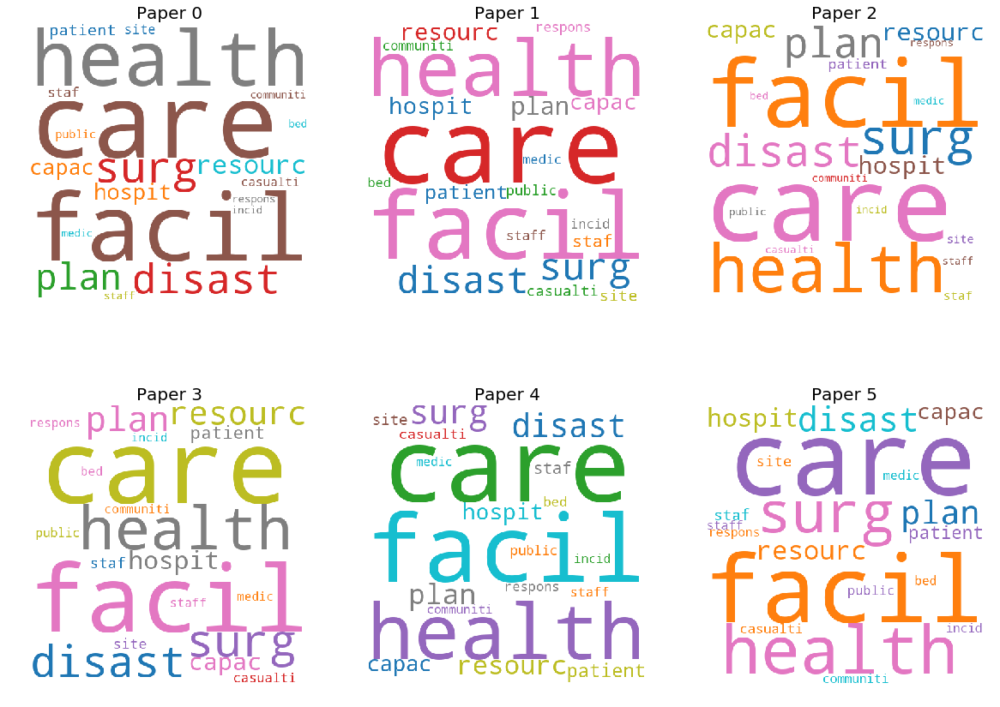

,title,doi,pmcid,pubmed_id,authors
0,Preparing for a Surge of Coronavirus Cases,10.1016/j.jcjq.2020.03.001,,,"Baker, David W."
1,Mapping infectious disease hospital surge thre...,10.1186/s12913-017-2552-1,PMC5584534,2.88702e+07,"Singh, Shweta R.; Coker, Richard; Vrijhoef, Hu..."
2,Chapter 28 Surge Capacity,10.1016/B978-0-323-03253-7.50035-2,,,"Casani, Julie Ann P.; Romanosky, Albert J."
3,Health care facility and community strategies ...,10.1016/j.annemergmed.2004.04.011,,1.53321e+07,"Hick, John L.; Hanfling, Dan; Burstein, Jonath..."
4,Can the Health-Care System Meet the Challenge ...,,PMC1936949,,"Levin, Peter J.; Gebbie, Eric N.; Qureshi, Kri..."
5,Intensive Care Unit Preparedness During Pandem...,10.1016/j.ccc.2019.06.001,,3.14456e+07,"Maves, Ryan C.; Jamros, Christina M.; Smith, A..."


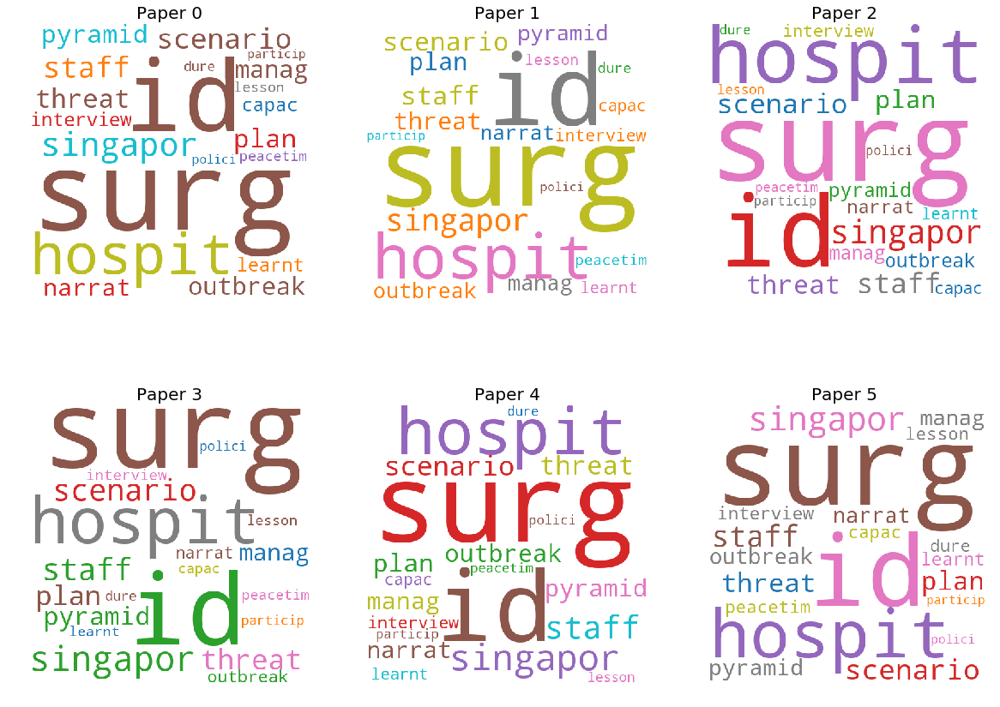

,title,doi,pmcid,pubmed_id,authors
0,The acute respiratory distress syndrome,10.1172/JCI60331,PMC3408735,,"Matthay, Michael A.; Ware, Lorraine B.; Zimmer..."
1,Dexamethasone treatment for the acute respirat...,10.1016/S2213-2600(19)30417-5,,,"Villar, Jesús; Ferrando, Carlos; Martínez, Dom..."
2,Acute Respiratory Distress Syndrome (ARDS) and...,10.1016/S1726-4901(09)70123-6,,1.57429e+07,"Jih, Thomas Kuen-Shan"
3,Role of nitric oxide in management of acute re...,10.4103/1817-1737.41914,PMC2700444,1.95619e+07,"Akmal, A. H.; Hasan, Mohd"
4,ACUTE RESPIRATORY DISTRESS SYNDROME: INSIGHTS ...,,PMC5655174,,"Kojicic, Marija; Festic, Emir; Gajic, Ognjen"
5,Early Upregulation of Acute Respiratory Distre...,10.1128/JVI.00127-09,PMC2704758,,"Rockx, Barry; Baas, Tracey; Zornetzer, Gregory..."


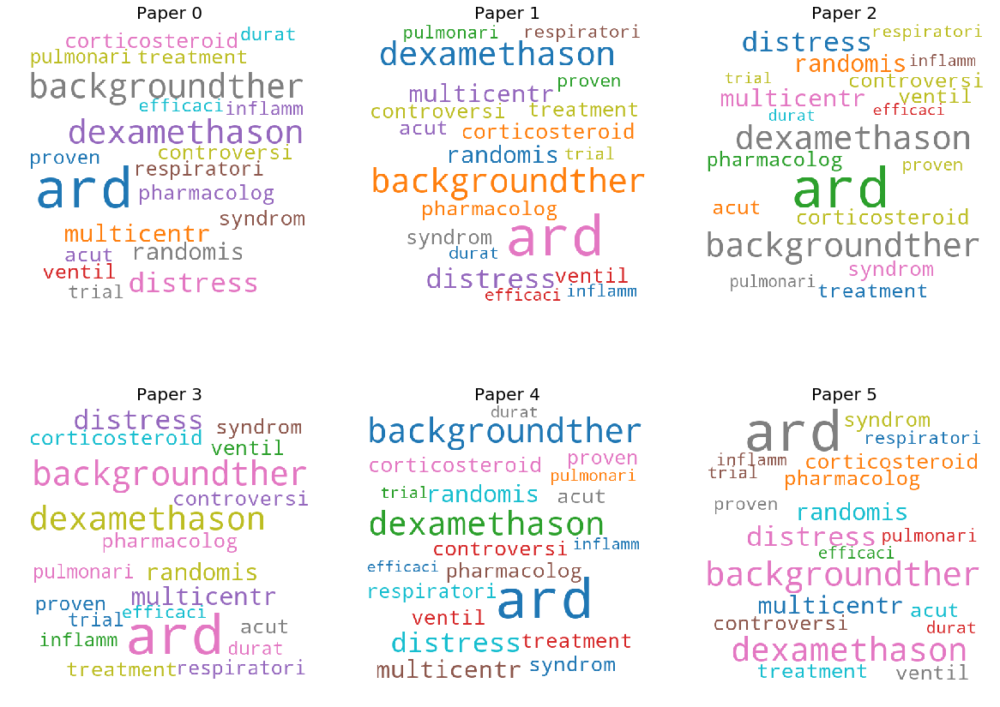

,title,doi,pmcid,pubmed_id,authors
0,The answer is blowing in the wind: an uncommon...,10.1136/bcr-2016-218079,PMC5372129,,"Einecke, Gunilla; Beutel, Gernot; Hoeper, Mari..."
1,Recommendations on extracorporeal life support...,10.3760/cma.j.issn.1001-0939.2020.0009,,3.20354e+07,"Chinese Society of Extracorporeal Life, Support"
2,Preparing for the Most Critically Ill Patients...,10.1001/jama.2020.2342,,3.20743e+07,"MacLaren, Graeme; Fisher, Dale; Brodie, Daniel"
3,Extracorporeal membrane oxygenation support in...,10.1097/CM9.0000000000000778,,3.21186e+07,"Li, Min; Gu, Si-Chao; Wu, Xiao-Jing; Xia, Jin-..."
4,The advent of ECMO and pumpless extracorporeal...,10.4103/0974-2700.82212,PMC3132365,2.17692e+07,"Hamid, I A; Hariharan, A S; Shankar, N R Ravi"
5,Extracorporeal membrane oxygenation for system...,10.5339/qmj.2017.swacelso.73,PMC5474641,,"Abdelaty, Mohamed; Fawzy, Ibrahim; Raza, Tasle..."


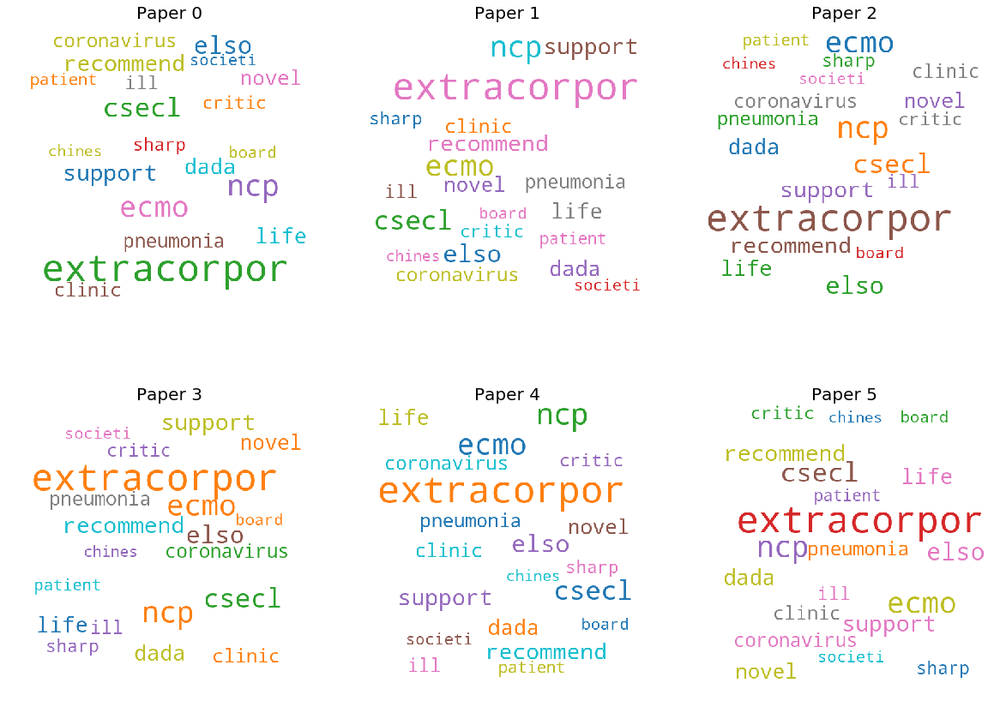

,title,doi,pmcid,pubmed_id,authors
0,Respiratory support for patients with COVID-19...,10.1016/S2213-2600(20)30110-7,,,"Ñamendys-Silva, Silvio A"
1,Influenza-associated pneumonia as reference to...,10.2807/1560-7917.ES.2020.25.11.2000258,,,"Tolksdorf, Kristin; Buda, Silke; Schuler, Ekke..."
2,Clinical characteristics of refractory COVID-1...,10.1093/cid/ciaa270,,,"Mo, Pingzheng; Xing, Yuanyuan; Xiao, Yu; Deng,..."
3,Clinical characteristics of refractory COVID-1...,,,,"Pingzheng Mo, Yuanyuan Xing Yu Xiao Liping Den..."
4,Airway management of COVID-19 patients with se...,10.3760/cma.j.issn.1673-0860.2020.04.001,,3.2101e+07,
5,Coronavirus Disease 2019 (COVID-19): A critica...,10.1016/j.accpm.2020.03.001,,,"Rello, Jordi; Tejada, Sofia; Userovici, Caroli..."


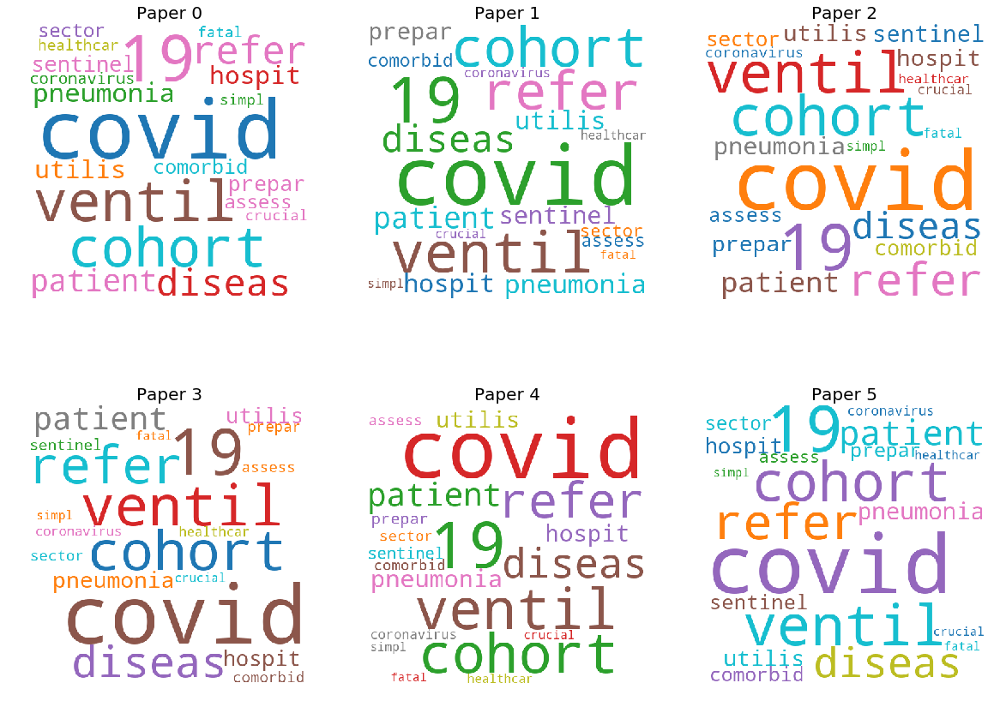

,title,doi,pmcid,pubmed_id,authors
0,Cardiac manifestations of patients with COVID-...,,,,"TAN, Zhaochong; FU, Linghua; WANG, Dandan; HON..."
1,Pediatric Mycoplasma pneumoniae Infection Pres...,10.5223/pghn.2017.20.2.124,PMC5517379,2.87301e+07,"Song, Won Jae; Kang, Ben; Lee, Hwa Pyung; Cho,..."
2,Evolution of Computed Tomography Manifestation...,10.3348/kjr.2020.0157,,,"Sun, Qiulian; Xu, Xinjian; Xie, Jicheng; Li, J..."
3,"COVID-19, A Clinical Syndrome Manifesting as H...",,,3.21531e+07,"Song, Young Goo; Shin, Hyoung Shik"
4,A report of clinical diagnosis and treatment o...,10.1002/jmv.25755,,,"Chen, Qing; Quan, Bin; Li, Xiaoning; Gao, Guan..."
5,Viral myocarditis and dilated cardiomyopathy: ...,10.1136/pmj.77.903.4,PMC1741887,,"Kearney, M; Cotton, J; Richardson, P; Shah, A"


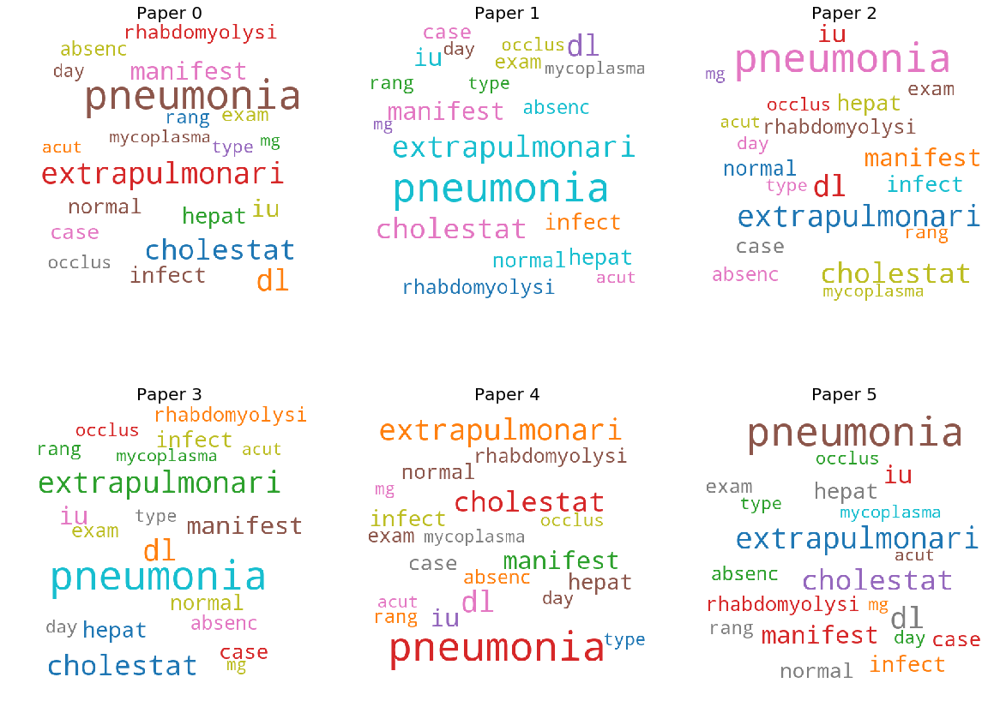

,title,doi,pmcid,pubmed_id,authors
0,Roles and contributions of pharmacists in regu...,10.1331/JAPhA.2010.09220,,2.02e+07,"Bhavsar, Tina R.; Kim, Hye-Joo; Yu, Yon"
1,Considerations for Use of Investigational Drug...,10.1177/2168479016680253,PMC5486404,,"Kirchoff, Matthew Carl; Pierson, Jerome F."
2,Emerging infectious disease laboratory and dia...,10.1080/21645515.2019.1634992,PMC6816404,3.12684e+07,"Roberts, Christine C."
3,Call for national dialogue: Adapting standards...,10.1016/j.colegn.2015.09.003,,,"Cusack, Lynette; Gebbie, Kristine"
4,Public Willingness to Take a Vaccine or Drug U...,10.1089/bsp.2009.0041,PMC2998968,,"Quinn, Sandra Crouse; Kumar, Supriya; Freimuth..."
5,Right-Sizing Technology in the Era of Consumer...,10.1016/j.clinmicnews.2017.07.001,,,"Deak, Eszter; Marlowe, Elizabeth M."


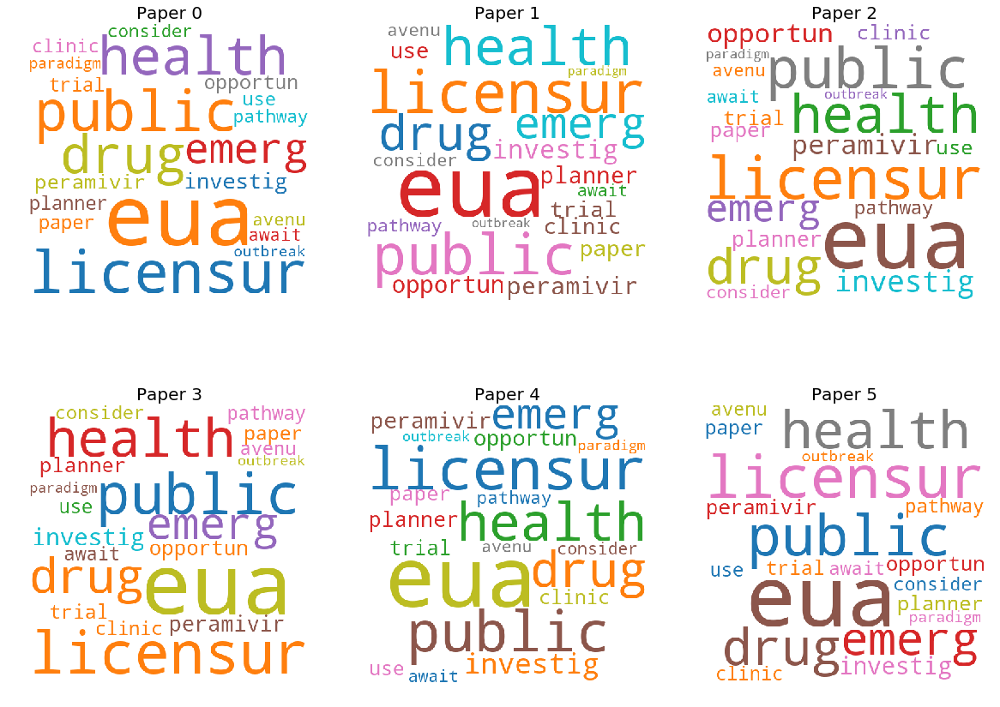

,title,doi,pmcid,pubmed_id,authors
0,Qualitative Analysis of Origins and Evolution ...,,PMC5849268,,"Hines, Stella E; Mueller, Nora; Oliver, Marc; ..."
1,Assessment of half-mask elastomeric respirator...,10.1016/j.ajic.2017.06.034,PMC6193495,,"Lawrence, Caryn; Harnish, Delbert A.; Sandoval..."
2,The Respiratory Protection Effectiveness Clini...,10.1186/s12879-016-1494-2,PMC4890247,2.72558e+07,"Radonovich, Lewis J.; Bessesen, Mary T.; Cummi..."
3,Effectiveness of N95 respirators versus surgic...,10.1503/cmaj.150835,PMC4868605,,"Smith, Jeffrey D.; MacDougall, Colin C.; Johns..."
4,The efficacy of medical masks and respirators ...,10.1111/irv.12474,PMC5705692,2.87997e+07,"MacIntyre, Chandini Raina; Chughtai, Abrar Ahm..."
5,Cost-effectiveness analysis of N95 respirators...,10.1186/s12879-017-2564-9,PMC5496227,2.86733e+07,"Mukerji, Shohini; MacIntyre, C. Raina; Seale, ..."


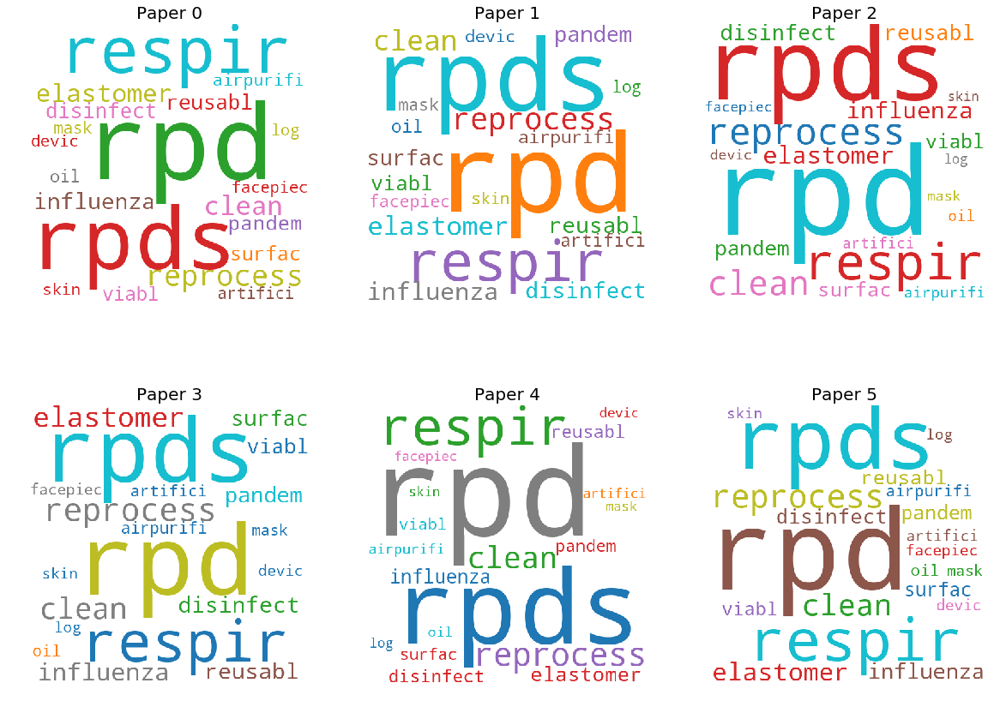

,title,doi,pmcid,pubmed_id,authors
0,From Isolation to Coordination: How Can Teleme...,10.1101/2020.02.20.20025957,,,Yunkai Zhai; Yichuan Wang; Minhao Zhang; Jody ...
1,Prerequisites for Effective Implementation of ...,10.4258/hir.2015.21.4.251,PMC4659882,2.6618e+07,"Lee, Hyeoi-Yun; Lee, Ji-San; Kim, Jeongeun"
2,Virtually Perfect? Telemedicine for Covid-19,10.1056/NEJMp2003539,,,"Hollander, Judd E.; Carr, Brendan G."
3,Telemedicine: Potential applications in epidem...,10.1016/j.eurtel.2015.08.002,,,"Ohannessian, R."
4,Cybercare 2.0: meeting the challenge of the gl...,10.1007/s12553-016-0132-8,PMC4901101,2.73588e+07,"Rosen, Joseph M.; Kun, Luis; Mosher, Robyn E.;..."
5,"Past, present and future: experiences and less...",,PMC3113223,2.16739e+07,"Elder, Laurent; Clarke, Michael"


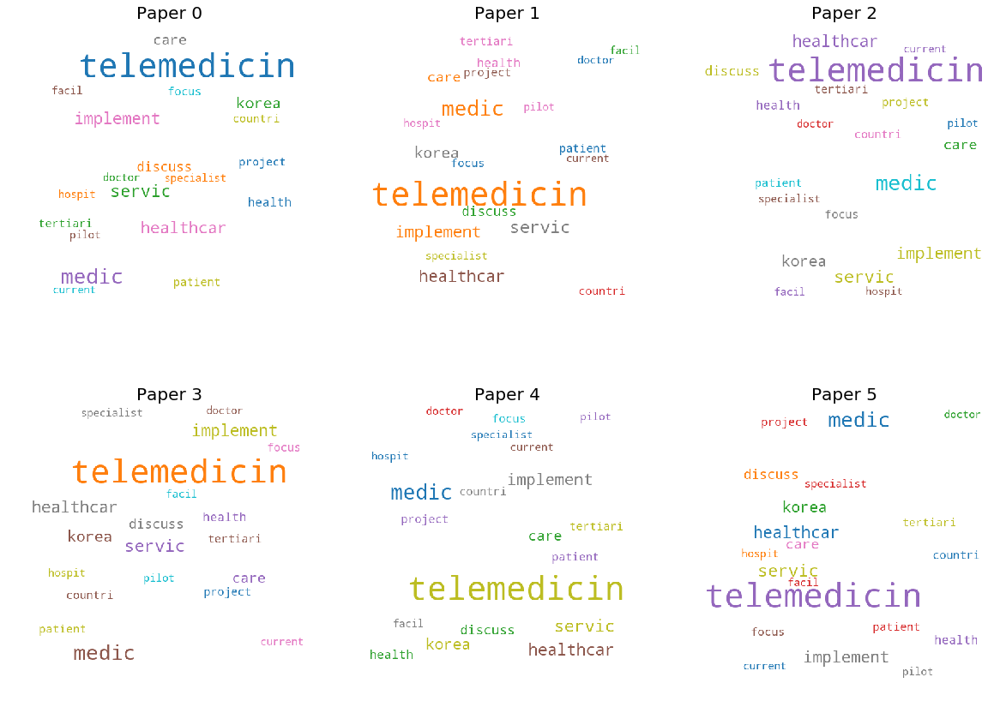

,title,doi,pmcid,pubmed_id,authors
0,A human behavior integrated hierarchical model...,10.1016/j.buildenv.2017.11.011,,,"Zhang, Nan; Huang, Hong; Su, Boni; Ma, Xun; Li..."
1,Infectious Disease Externalities,10.1016/B978-0-12-375678-7.00404-1,,,"Gersovitz, M."
2,At the epicenter of severe acute respiratory s...,10.1016/j.jtcvs.2004.03.002,,1.51737e+07,"Wan, Song; Yim, Anthony P.C"
3,4 The Public Health Response to HIV/AIDS: What...,10.1016/B978-012465271-2/50007-8,,,"Katz, Mitchell H."
4,Behavioural intentions in response to an influ...,10.1186/1471-2458-10-174,PMC2861057,2.03536e+07,"Kok, Gerjo; Jonkers, Ruud; Gelissen, Roger; Me..."
5,Scientists question China’s decision not to re...,,,,Nature


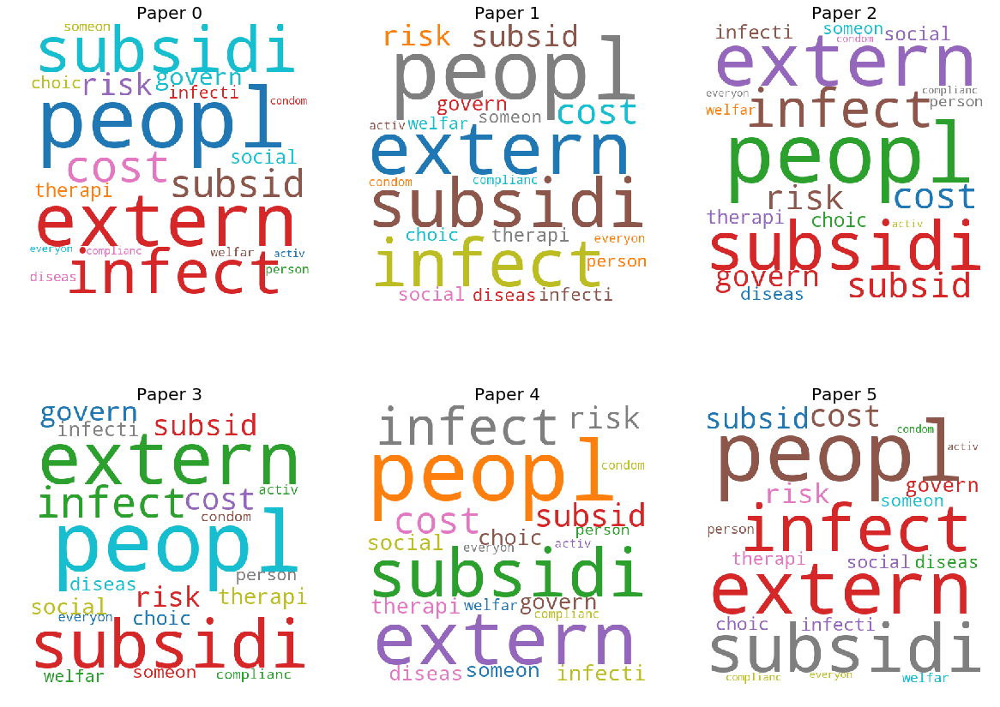

,title,doi,pmcid,pubmed_id,authors
0,Oral Presentation Abstracts,10.1016/j.cyto.2017.09.010,,,
1,Communication orale,10.1016/j.rmr.2010.10.013,,,
2,Oral presentations,10.1111/j.1469-0691.2011.03557.x,,,
3,Oral presentations,10.1177/1757177416663087,PMC5291341,,
4,Psychological intervention in oral patients in...,10.3760/cma.j.cn112144-20200213-00053,,3.20869e+07,"Qu, X.; Zhou, X. D."
5,73 Tropical Oral Health,10.1016/B978-0-7020-5101-2.00074-1,,,"Bedi, Raman; Scully, Crispian"


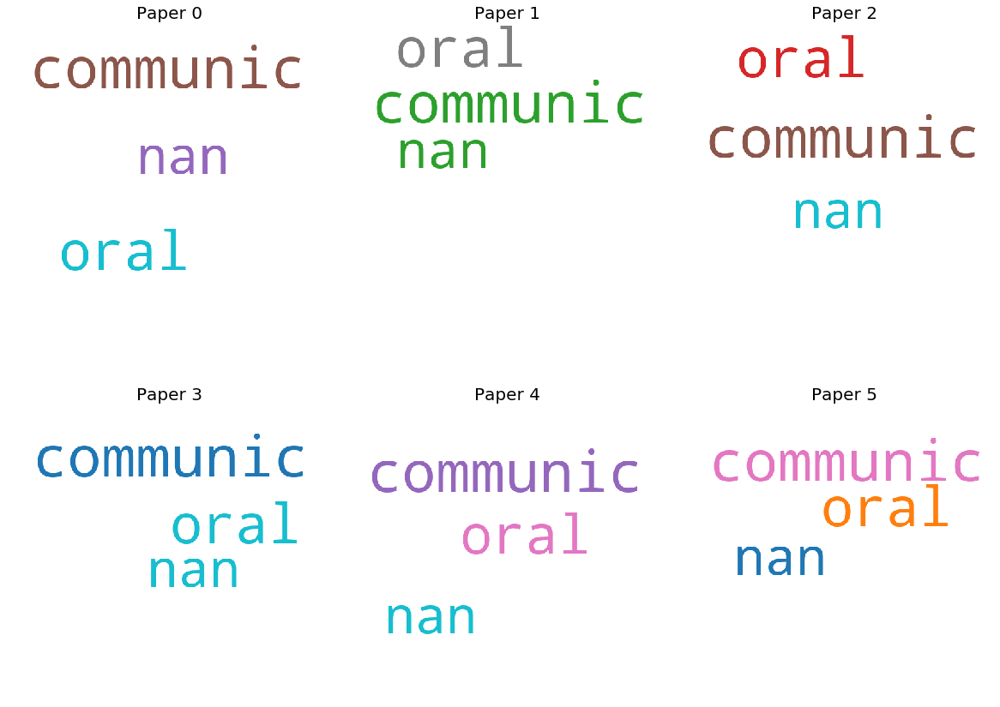

,title,doi,pmcid,pubmed_id,authors
0,Chapter 83 Artificial intelligence in medical ...,10.1016/B978-0-12-813467-2.00084-5,,,"Sloane, Elliot B.; J. Silva, Ricardo"
1,Chapter 18 Use of artificial intelligence in i...,10.1016/B978-0-12-817133-2.00018-5,,,"Agrebi, Said; Larbi, Anis"
2,Monitoring of risk perceptions and correlates ...,10.1186/1471-2334-10-114,PMC2885389,2.04624e+07,"de Zwart, Onno; Veldhuijzen, Irene K; Richardu..."
3,The Role of Augmented Intelligence (AI) in Det...,10.1007/s10916-020-1536-6,,,"Long, Justin B.; Ehrenfeld, Jesse M."
4,Comparative Analysis of the Effectiveness of T...,10.1371/journal.pone.0095911,PMC4008523,2.47877e+07,"Xu, Zhijing; Zu, Zhenghu; Zheng, Tao; Zhang, W..."
5,Cerebrovascular Accident in a Pediatric Patien...,10.1016/j.jemermed.2019.03.015,,3.1028e+07,"Javedani, Parisa P.; Zukowski, Melissa"


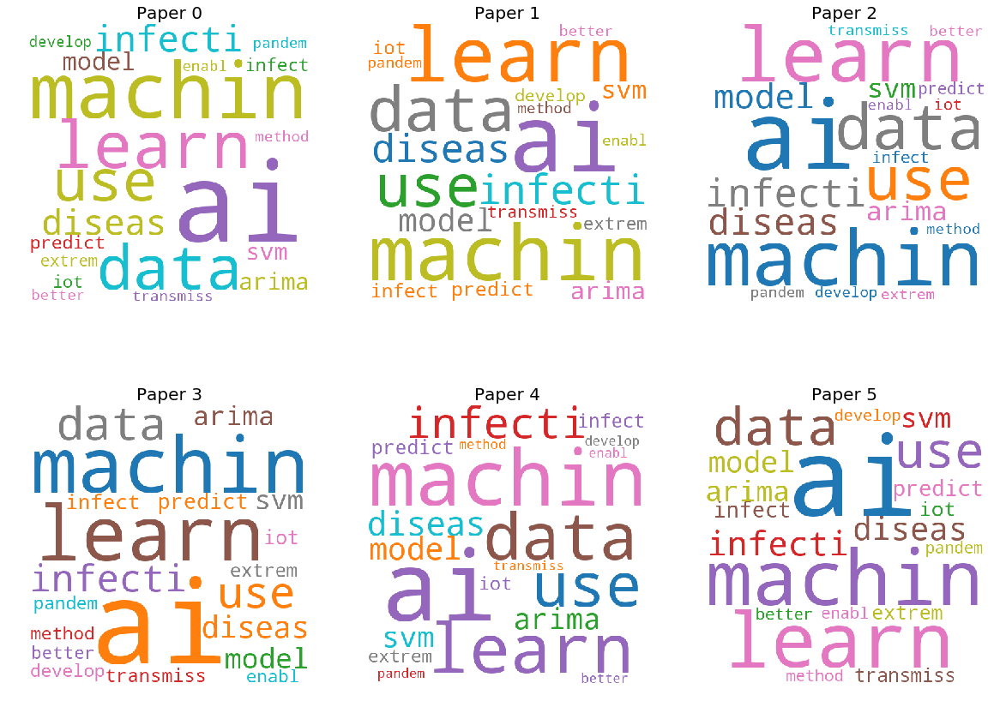

,title,doi,pmcid,pubmed_id,authors
0,Beyond Disaster Preparedness: Building a Resil...,10.3390/ijerph14121563,PMC5750981,2.9236e+07,"Madrigano, Jaime; Chandra, Anita; Costigan, Tr..."
1,Supporting the Health Care Workforce During th...,10.1001/jama.2020.3972,,,"Adams, James G.; Walls, Ron M."
2,Using Blended Learning In Training The Public ...,,PMC1525268,,"Moore, Gary S; Perlow, Audrey; Judge, Christin..."
3,The potential impact of the next influenza pan...,10.1186/1478-4491-3-7,PMC1215505,1.6093e+07,"Wilson, Nick; Baker, Michael; Crampton, Peter;..."
4,The intensive care unit work environment: Curr...,10.1016/j.jcrc.2008.03.038,,1.93273e+07,"Alameddine, Mohamad; Dainty, Katie N.; Deber, ..."
5,Workforce Integration of New Graduate Nurses: ...,,PMC3287948,,"Baumann, Andrea; Hunsberger, Mabel; Crea-Arsen..."


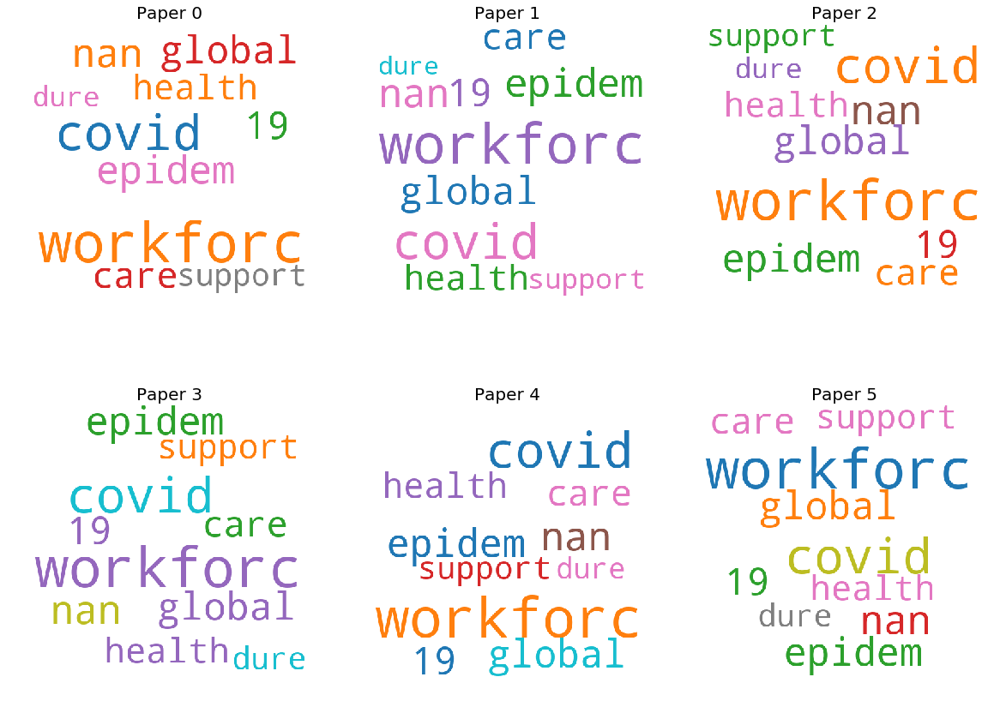

,title,doi,pmcid,pubmed_id,authors
0,13 Epidemiologic Principles,10.1016/B978-1-4557-4801-3.00013-8,,,"Osterholm, Michael T.; Hedberg, Craig W."
1,Modernising epidemic science: enabling patient...,10.1186/s12916-016-0760-x,PMC5165716,2.79892e+07,"Rojek, Amanda M.; Horby, Peter W."
2,Knowledge gaps in therapeutic and non-therapeu...,10.1016/S2213-2600(16)00007-2,,2.68686e+07,"Arabi, Yaseen M; Fowler, Rob; Bright, Rick A; ..."
3,The Ebola clinical trials: a precedent for res...,10.1136/medethics-2016-103474,PMC5749307,2.75732e+07,"Calain, Philippe"
4,Epidemiologic data and pathogen genome sequenc...,10.1186/s13059-014-0538-4,PMC4282151,2.54181e+07,"Grad, Yonatan H; Lipsitch, Marc"
5,Chapter 47 Issues and Challenges for Clinical ...,10.1016/B978-0-12-382167-6.00047-3,,,"Olopade, Christopher O.; Olugbile, Sope; Olopa..."


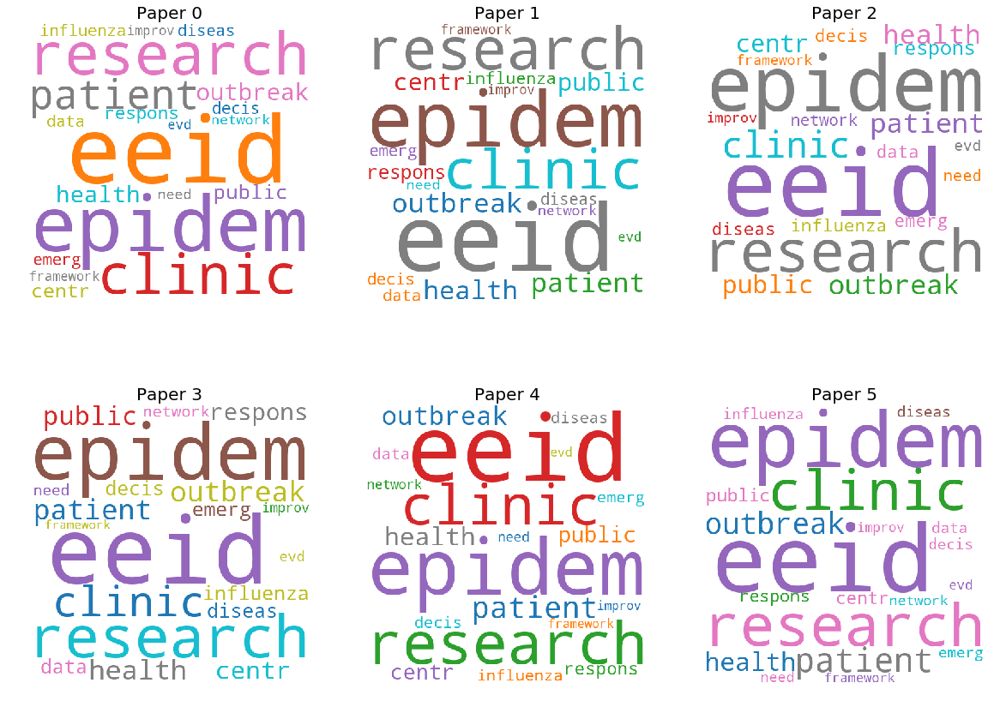

,title,doi,pmcid,pubmed_id,authors
0,A Real-Time Autonomous Dashboard for the Emerg...,10.2196/10666,PMC6284143,3.04671e+07,"Yoo, Junsang; Jung, Kwang Yul; Kim, Taerim; Le..."
1,Can we measure ‘Sensationalisim’ and ‘Spin’?,10.1016/j.jclinepi.2016.06.001,,2.73246e+07,"Tugwell, Peter; Knottnerus, J. André"
2,GOST: A generic ordinal sequential trial desig...,10.1371/journal.pntd.0005439,PMC5360336,2.82783e+07,"Whitehead, John; Horby, Peter"
3,A Versatile Sample Processing Workflow for Met...,10.1038/s41598-018-31496-1,PMC6117295,3.01666e+07,"Wylezich, Claudia; Papa, Anna; Beer, Martin; H..."
4,Integration of patient-reported outcomes in mu...,10.1016/j.cct.2013.02.006,,2.34156e+07,"Gnanasakthy, Ari; DeMuro, Carla; Boulton, Caro..."
5,Chapter 21 Testing of Adenoviral Vector Gene T...,10.1016/B978-012199504-1/50022-5,,,"Bauer, Steven R.; Pilaro, Anne M.; Weiss, Kare..."


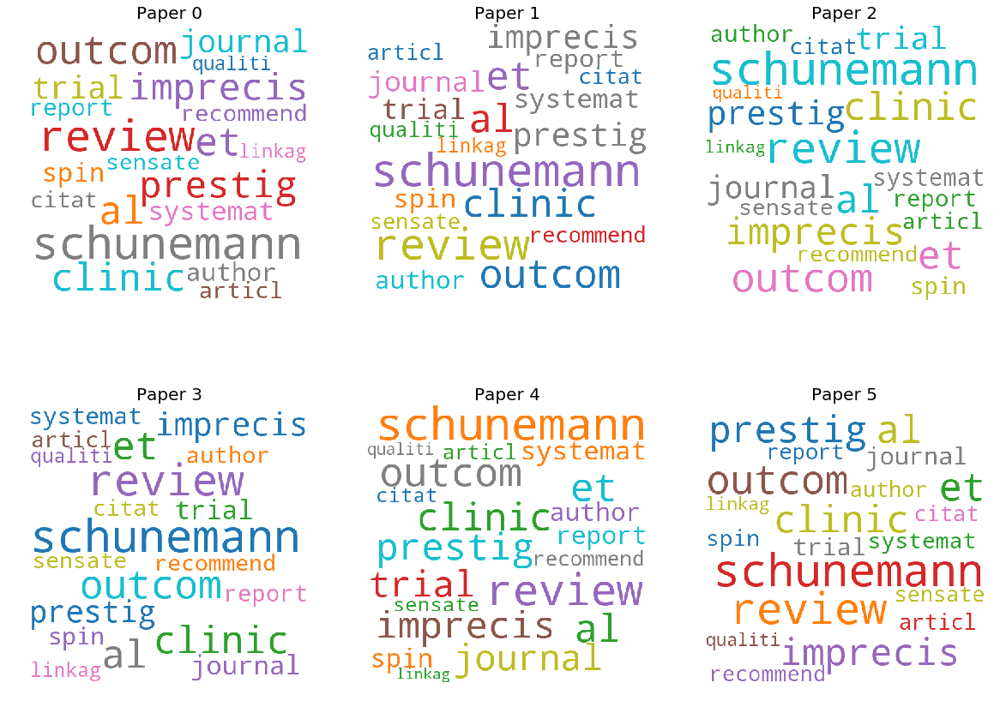

,title,doi,pmcid,pubmed_id,authors
0,Severe varicella-zoster virus pneumonia: a mul...,10.1186/s13054-017-1731-0,PMC5463395,2.85923e+07,"Mirouse, Adrien; Vignon, Philippe; Piron, Pres..."
1,Severe Acute Respiratory Syndrome: Clinical Ou...,10.3201/eid0909.030362,PMC3016795,1.45192e+07,"Tsui, Ping Tim; Kwok, Man Leung; Yuen, Hon; La..."
2,The successful use of extra-corporeal membrane...,10.1016/j.ijoa.2010.04.010,,2.07054e+07,"Robertson, L.C.; Allen, S.H.; Konamme, S.P.; C..."
3,Recently published papers: small pieces of the...,,PMC270692,1.27939e+07,"Ball, Jonathan"
4,Current concepts in SARS treatment,10.1007/s10156-003-0296-9,,,"Fujii, Takeshi; Iwamoto, Aikichi; Nakamura, Te..."
5,Treatment and vaccines for severe acute respir...,10.1016/S1473-3099(05)01307-1,,1.57666e+07,"Groneberg, David A; Poutanen, Susan M; Low, Do..."


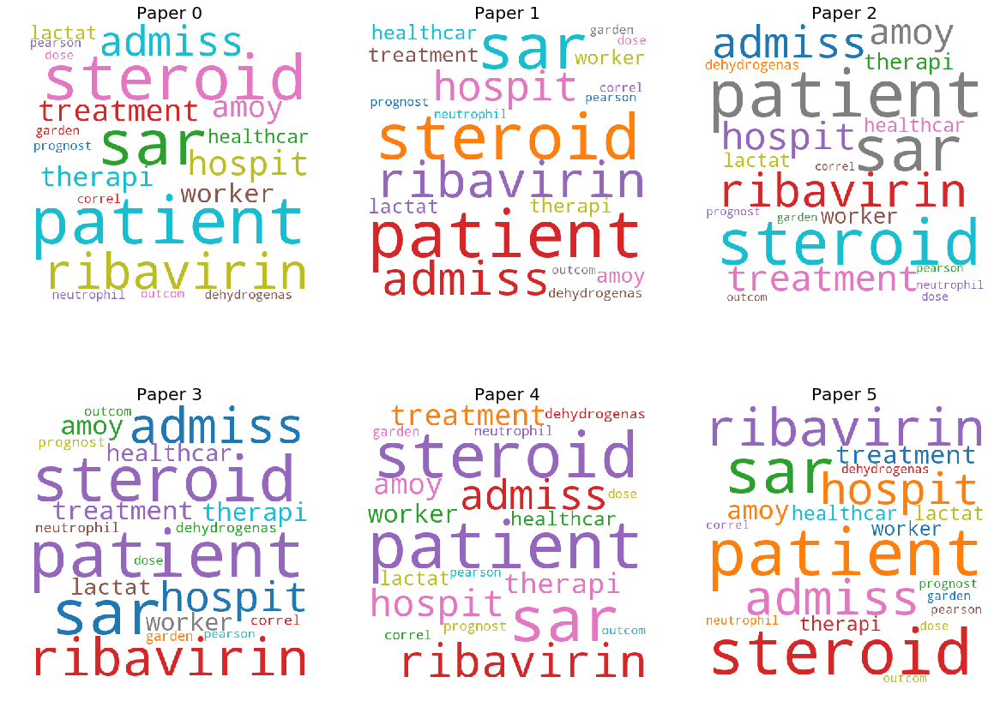

In [17]:
display_topics_results("What has been published about medical care?")

# What has been published about information sharing and inter-sectoral collaboration?

,title,doi,pmcid,pubmed_id,authors
0,Virus nomenclature below the species level: a ...,10.1007/s00705-012-1454-0,PMC3535543,,"Kuhn, Jens H.; Bao, Yiming; Bavari, Sina; Beck..."
1,"TAXONOMY, CLASSIFICATION AND NOMENCLATURE OF V...",10.1006/rwvi.1999.0277,,,"Fauquet, Claude M."
2,Recommendations of the coronavirus study group...,10.1016/0042-6822(90)90259-T,,2.18458e+06,"Cavanagh, D.; Brian, D.A.; Enjuanes, L.; Holme..."
3,Chapter 12 Style and Usage for Life Science,10.1016/B978-012373980-3.50016-2,,,
4,Mass Gatherings and Respiratory Disease Outbre...,10.1371/journal.pone.0160378,PMC4990208,2.75368e+07,"Rainey, Jeanette J.; Phelps, Tiffani; Shi, Jia..."
5,International Union of Pharmacology. LXXXIX. U...,10.1124/pr.113.007724,PMC3880466,,"Bachelerie, Francoise; Ben-Baruch, Adit; Burkh..."


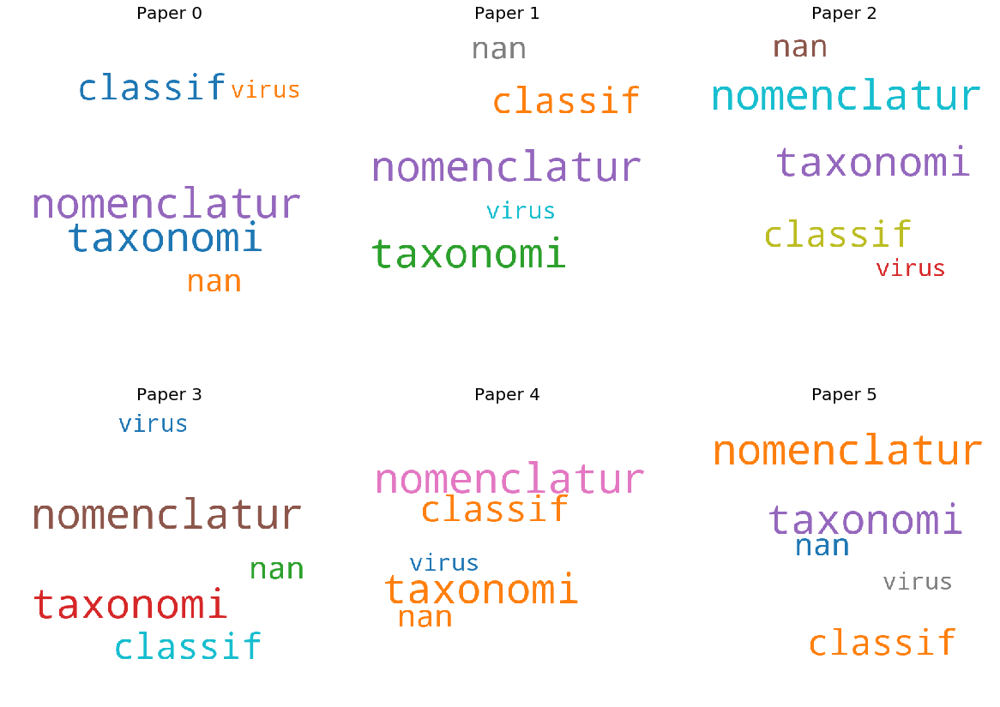

,title,doi,pmcid,pubmed_id,authors
0,Gap between tourism planning and implementatio...,10.1016/j.tourman.2005.11.009,,,"Lai, Kun; Li, Yiping; Feng, Xuegang"
1,Systems modeling in support of evidence-based ...,10.1016/j.ijheh.2005.01.011,,1.5882e+07,"Hoard, Marna; Homer, Jack; Manley, William; Fu..."
2,Preparing for and Responding to Pandemic Influ...,10.2105/AJPH.2009.162677,PMC4504380,,"Campbell, Vincent A.; Gilyard, Jamylle A.; Sin..."
3,Must I Respond if My Health is at Risk?,10.1016/j.jemermed.2018.04.021,,2.97735e+07,"Iserson, Kenneth V."
4,Considerations for Use of Investigational Drug...,10.1177/2168479016680253,PMC5486404,,"Kirchoff, Matthew Carl; Pierson, Jerome F."
5,Integrating Genome-based Informatics to Modern...,10.3201/eid/1811.120453,PMC3559169,2.30927e+07,"Aarestrup, Frank M.; Brown, Eric W.; Detter, C..."


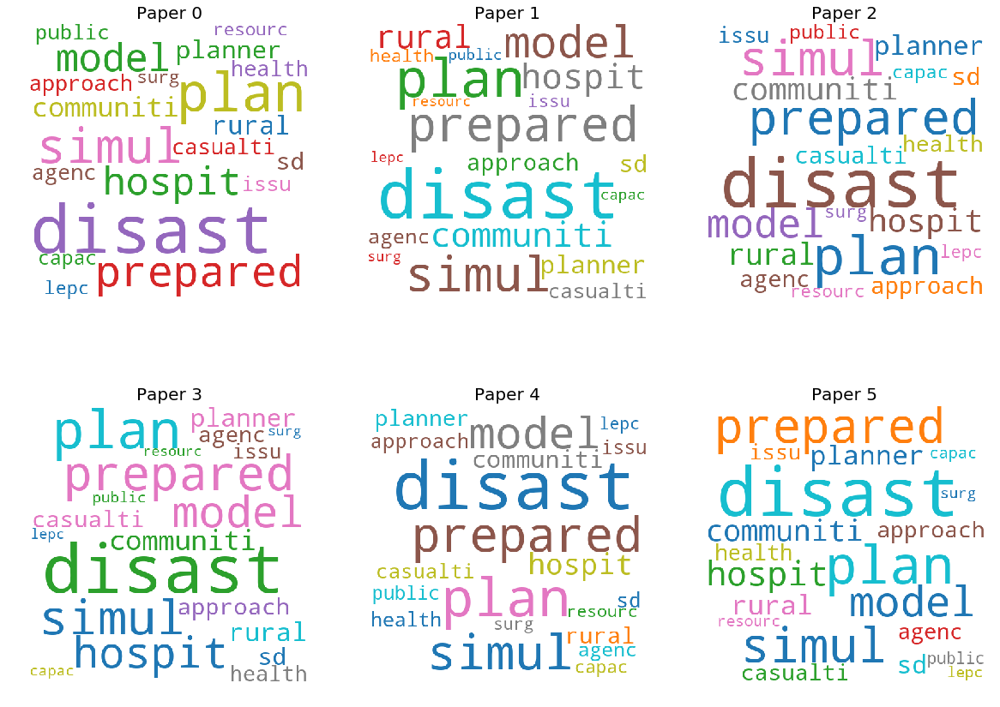

,title,doi,pmcid,pubmed_id,authors
0,Chapter 21 Disaster Mitigation,10.1016/B978-0-323-03253-7.50028-5,,,"Gougelet, Robert M."
1,Conceptualising the technical relationship of ...,10.1186/1472-6963-11-225,PMC3189394,2.19298e+07,"Häsler, Barbara; Howe, Keith S; Stärk, Kathari..."
2,Public Response to Community Mitigation Measur...,10.3201/eid1405.071437,PMC2600239,1.84394e+07,"Blendon, Robert J.; Koonin, Lisa M.; Benson, J..."
3,Chapter 27 Disaster Mitigation,10.1016/B978-0-323-28665-7.00027-3,,,"Gougelet, Robert M."
4,From Containment to Mitigation of COVID-19 in ...,10.1001/jama.2020.3882,,,"Parodi, Stephen M.; Liu, Vincent X."
5,"COVID-19: delay, mitigate, and communicate",10.1016/S2213-2600(20)30128-4,,,"The Lancet Respiratory Medicine,"


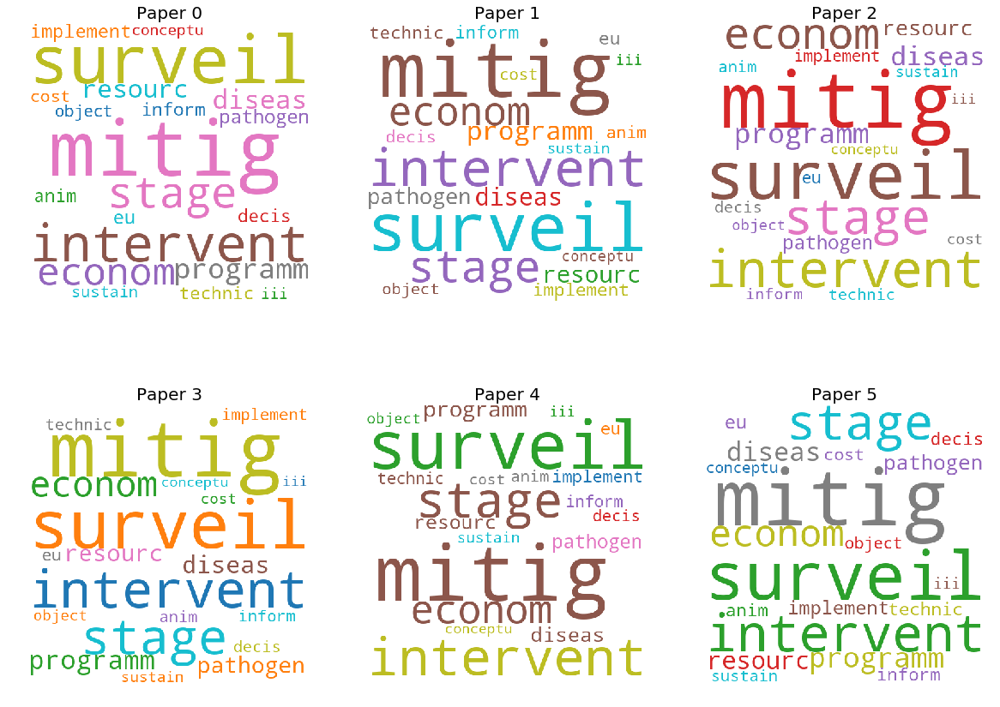

,title,doi,pmcid,pubmed_id,authors
0,The science commons in health research: struct...,10.1007/s10961-006-9016-9,PMC4982884,2.75704e+07,"Cook-Deegan, Robert"
1,The Next Influenza Pandemic: Will we be Ready ...,10.1016/j.jpeds.2005.04.066,,,"Woods, Charles R.; Abramson, Jon S."
2,Chapter 11 Response at the State and Local Level,10.1016/B978-0-12-802029-6.00011-6,,,"Ryan, Jeffrey R."
3,Consortia’s critical role in developing medica...,10.2217/fvl-2015-0011,PMC4912138,,"Everts, Maaike; Suto, Mark J; Painter, George ..."
4,Southeastern Center for Emerging Biologic Thre...,10.1089/bsp.2011.0040,PMC3316480,,"Morris, J. Glenn; Greenspan, Allison; Howell, ..."
5,Regionalization in Local Public Health Systems...,,PMC2430640,,"Stoto, Michael A."


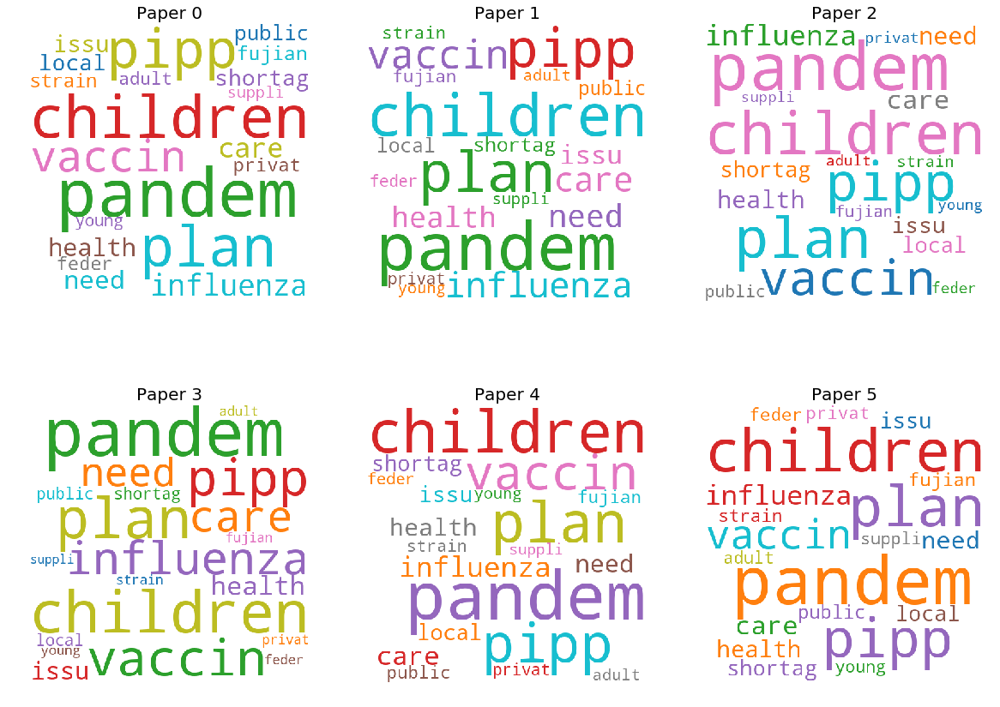

,title,doi,pmcid,pubmed_id,authors
0,The New International Health Regulations and t...,10.1371/journal.pmed.0030001,PMC1315361,1.63541e+07,"Wilson, Kumanan; McDougall, Christopher; Upshu..."
1,13 Public Health Law I Complications of Federa...,10.1016/B978-0-12-804275-5.00013-9,,,"Hunter, Nan D."
2,Pandemic Threats and the Need for New Emergenc...,,PMC2585432,,"Wilson, Kumanan"
3,Chapter 11 Response at the State and Local Level,10.1016/B978-0-12-802029-6.00011-6,,,"Ryan, Jeffrey R."
4,HHS/CDC Legal Response to SARS Outbreak,10.3201/eid1002.030721,PMC3322897,1.50307e+07,"Misrahi, James J.; Foster, Joseph A.; Shaw, Fr..."
5,Informing U.S. Federal Public Health Preparati...,10.5210/ojphi.v6i1.5122,PMC4050778,,"Hickey, Andrew; Wong, Diana; Hendricks, Janet;..."


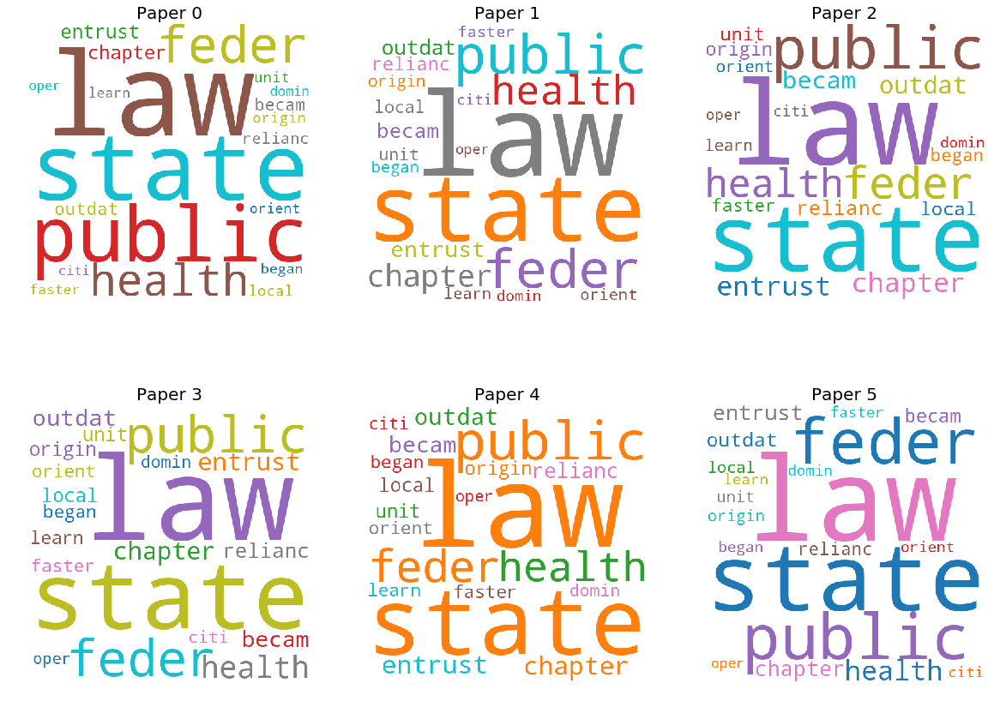

,title,doi,pmcid,pubmed_id,authors
0,Public health preparedness and response in the...,10.1016/S0140-6736(11)61263-4,,2.18901e+07,"Khan, Ali S"
1,Emergency Preparedness and Public Health Syste...,10.1016/j.amepre.2008.02.012,,1.84716e+07,"Kruk, Margaret E."
2,Public Health Preparedness Funding: Key Progra...,10.2105/AJPH.2017.303963,PMC5594397,,"Watson, Crystal R.; Watson, Matthew; Sell, Tar..."
3,Straining the System: Novel Coronavirus (COVID...,10.2105/AJPH.2020.305618,,3.20534e+07,"Smith, Nathaniel; Fraser, Michael"
4,Early response to the emergence of influenza A...,10.2471/BLT.13.125989,PMC3967572,,"Vong, Sirenda; O’Leary, Michael; Feng, Zijian"
5,A review of instruments assessing public healt...,,PMC1497752,,"Asch, Steven M.; Stoto, Michael; Mendes, Marc;..."


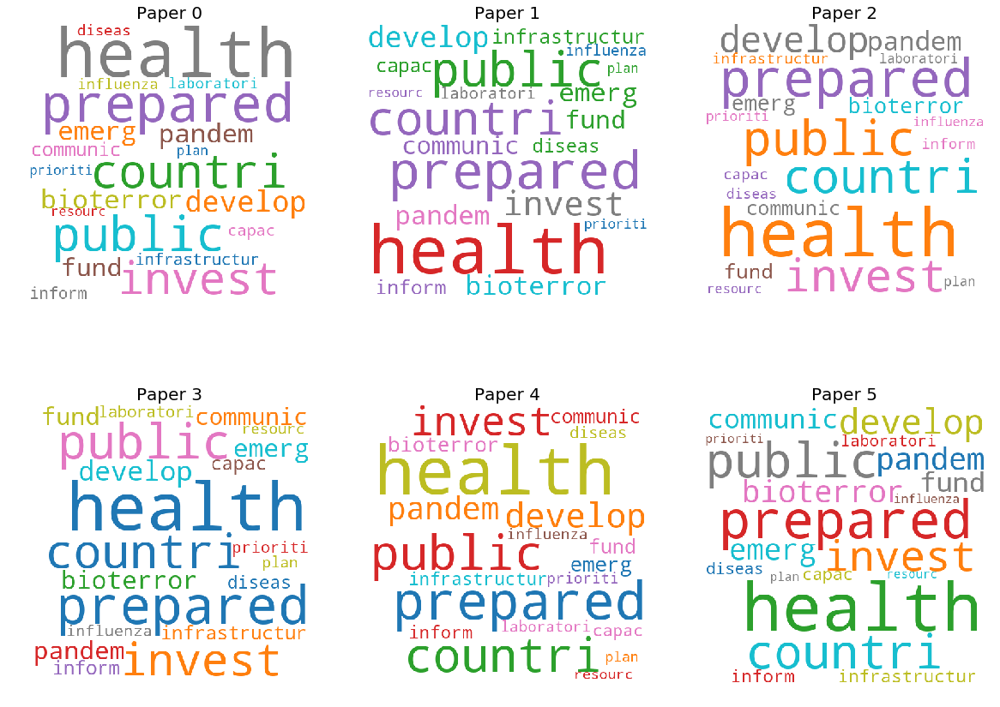

,title,doi,pmcid,pubmed_id,authors
0,A research agenda for aging in China in the 21...,10.1016/j.arr.2015.08.003,PMC5179143,2.63048e+07,"Fang, Evandro Fei; Scheibye-Knudsen, Morten; J..."
1,Emerging health care-associated infections in ...,,PMC2631705,1.12947e+07,"Strausbaugh, L. J."
2,Lessons from Severe Acute Respiratory Syndrome...,10.1016/j.arcmed.2005.03.040,,1.62166e+07,"Wenzel, Richard P.; Bearman, Gonzalo; Edmond, ..."
3,Fight or Flight: The Ethics of Emergency Physi...,10.1016/j.annemergmed.2007.07.024,,1.79505e+07,"Iserson, Kenneth V.; Heine, Carlton E.; Larkin..."
4,Risk of transmission of severe acute respirato...,10.1016/j.amjmed.2003.11.011,,1.50638e+07,"Chan, Louis Y; Wong, John T.W; Li, Philip K.T;..."
5,COVID-19 and the Risk to Health Care Workers: ...,10.7326/L20-0175,,,"Ng, Kangqi; Poon, Beng Hoong; Kiat Puar, Troy ..."


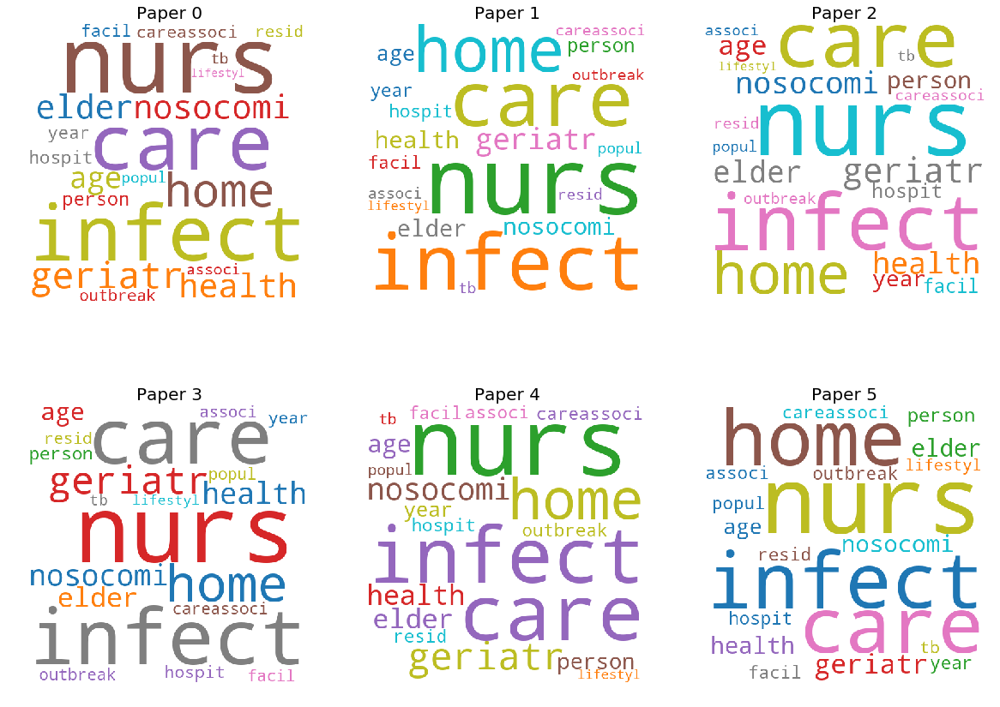

,title,doi,pmcid,pubmed_id,authors
0,Risk and outbreak communication: lessons from ...,10.2471/BLT.08.058149,PMC2733277,,"Abraham, Thomas"
1,Assessing Knowledge and Application of Emergen...,10.1017/dmp.2014.29,PMC4675457,,"Cope, James R.; Frost, Melinda; Richun, Li; Xi..."
2,Effective risk governance requires risk commun...,10.4178/epih.e2016055,PMC5177806,2.79191e+07,"Paek, Hye-Jin"
3,When even the 'best-laid' plans go wrong,10.1038/sj.embor.7400257,PMC1299213,,"McComas, Katherine"
4,2 Risk Analysis Framework Guidance for Wildlif...,10.1016/B978-0-323-55228-8.00002-3,,,"Travis, Dominic A.; Smith, Kristine"
5,Responding to global infectious disease outbre...,10.1016/j.socscimed.2006.08.004,,1.69788e+07,"Smith, Richard D."


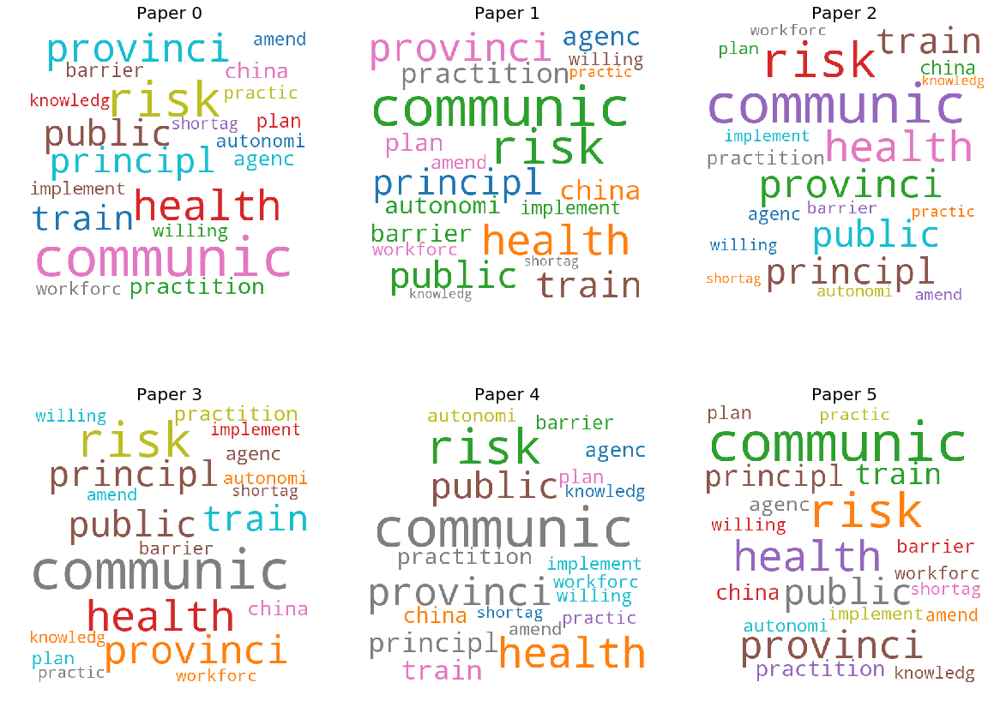

,title,doi,pmcid,pubmed_id,authors
0,Learning from recent outbreaks to strengthen r...,10.5365/wpsar.2018.9.5.013,PMC6902657,3.18322e+07,"O’Connor, Lauren J; Peters, Lisa; Aynsley, Rose"
1,Effective Health Risk Communication About Pand...,10.2105/AJPH.2009.162537,PMC4504362,,"Vaughan, Elaine; Tinker, Timothy"
2,Effective risk governance requires risk commun...,10.4178/epih.e2016055,PMC5177806,2.79191e+07,"Paek, Hye-Jin"
3,Risk communication and management in public he...,10.1016/j.puhe.2009.07.017,,1.97477e+07,"de Sa, J.; Mounier-Jack, S.; Coker, R."
4,Assessing Knowledge and Application of Emergen...,10.1017/dmp.2014.29,PMC4675457,,"Cope, James R.; Frost, Melinda; Richun, Li; Xi..."
5,Progress in public health risk communication i...,10.1186/s12889-019-6778-1,PMC6696672,,"Frost, Melinda; Li, Richun; Moolenaar, Ronald;..."


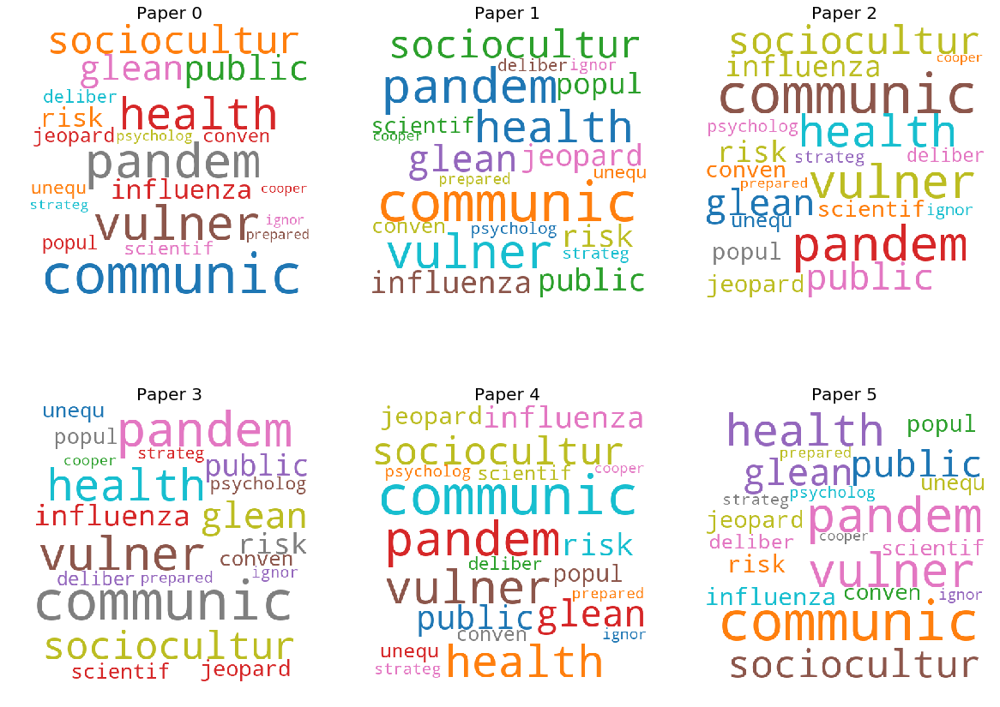

,title,doi,pmcid,pubmed_id,authors
0,From Containment to Mitigation of COVID-19 in ...,10.1001/jama.2020.3882,,,"Parodi, Stephen M.; Liu, Vincent X."
1,Pandemic Influenza Preparedness and Response A...,10.2105/AJPH.2008.154054,PMC4504387,,"Truman, Benedict I.; Tinker, Timothy; Vaughan,..."
2,Conceptualising the technical relationship of ...,10.1186/1472-6963-11-225,PMC3189394,2.19298e+07,"Häsler, Barbara; Howe, Keith S; Stärk, Kathari..."
3,Chapter 21 Disaster Mitigation,10.1016/B978-0-323-03253-7.50028-5,,,"Gougelet, Robert M."
4,"COVID-19: delay, mitigate, and communicate",10.1016/S2213-2600(20)30128-4,,,"The Lancet Respiratory Medicine,"
5,Public Response to Community Mitigation Measur...,10.3201/eid1405.071437,PMC2600239,1.84394e+07,"Blendon, Robert J.; Koonin, Lisa M.; Benson, J..."


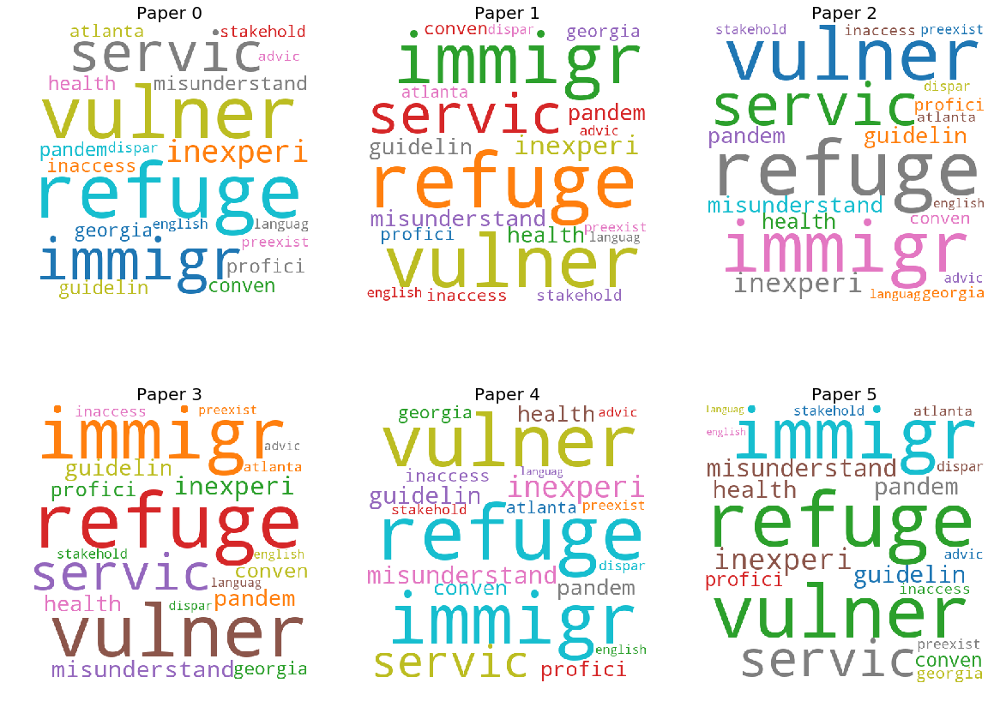

,title,doi,pmcid,pubmed_id,authors
0,"10 Mitigation, Prevention, and Preparedness",10.1016/B978-0-12-415802-3.00010-5,,,"Bullock, Jane A.; Haddow, George D.; Coppola, ..."
1,Chapter 27 Disaster Mitigation,10.1016/B978-0-323-28665-7.00027-3,,,"Gougelet, Robert M."
2,Protecting the world from infectious disease t...,10.1136/bmjgh-2019-001885,PMC6730581,3.1544e+07,"Shahpar, Cyrus; Lee, Christopher T; Wilkason, ..."
3,Linkages of acute care and emergency medical s...,10.1016/j.prehos.2004.03.001,,1.52957e+07,"O'Connor, Robert E; Lerner, E.Brooke; Allswede..."
4,A framework for stimulating economic investmen...,10.2471/BLT.17.199547,PMC5791777,2.94031e+07,"Schar, Daniel L; Yamey, Gavin Mark; Machalaba,..."
5,US Centers for Disease Control and Prevention ...,10.3201/eid2313.170946,PMC5711315,2.91557e+07,"Tappero, Jordan W.; Cassell, Cynthia H.; Bunne..."


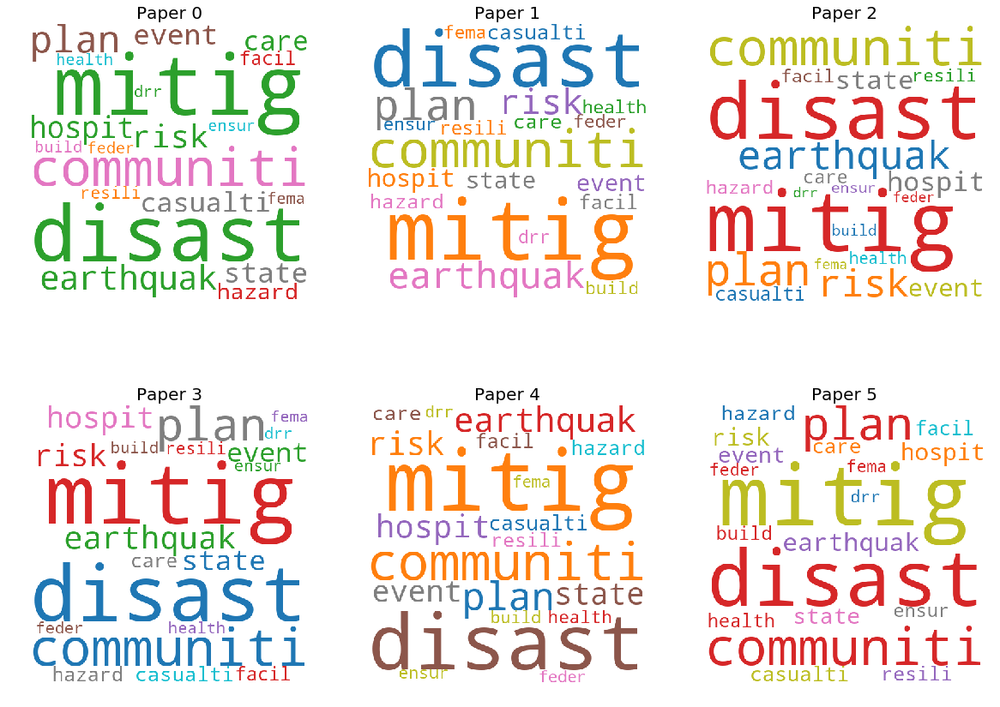

,title,doi,pmcid,pubmed_id,authors
0,New Insights into the Cell Biology of the Marg...,10.1016/S0074-7696(06)50005-1,,1.68611e+07,"Kraal, Georg; Mebius, Reina"
1,Skin cancer and surgical margins for basal cel...,10.7861/clinmedicine.6-6-622a,PMC4952783,,"Varma, Sandeep"
2,Will regional economic integration influence c...,10.1016/j.eneco.2018.06.010,,,"He, Weijun; Wang, Bo; Danish, ; Wang, Zhaohua"
3,Animal Models of Respiratory Syncytial Virus I...,10.1016/j.coviro.2015.06.003,PMC4699663,,"Sacco, Randy E.; Durbin, Russell K.; Durbin, J..."
4,Intervening to Reduce Inequalities in Infectio...,10.2105/AJPH.2007.120329,PMC2374832,,"Semenza, Jan C.; Giesecke, Johan"
5,Health Inequalities and Infectious Disease Epi...,10.1089/bsp.2014.0032,PMC4170985,,"Quinn, Sandra Crouse; Kumar, Supriya"


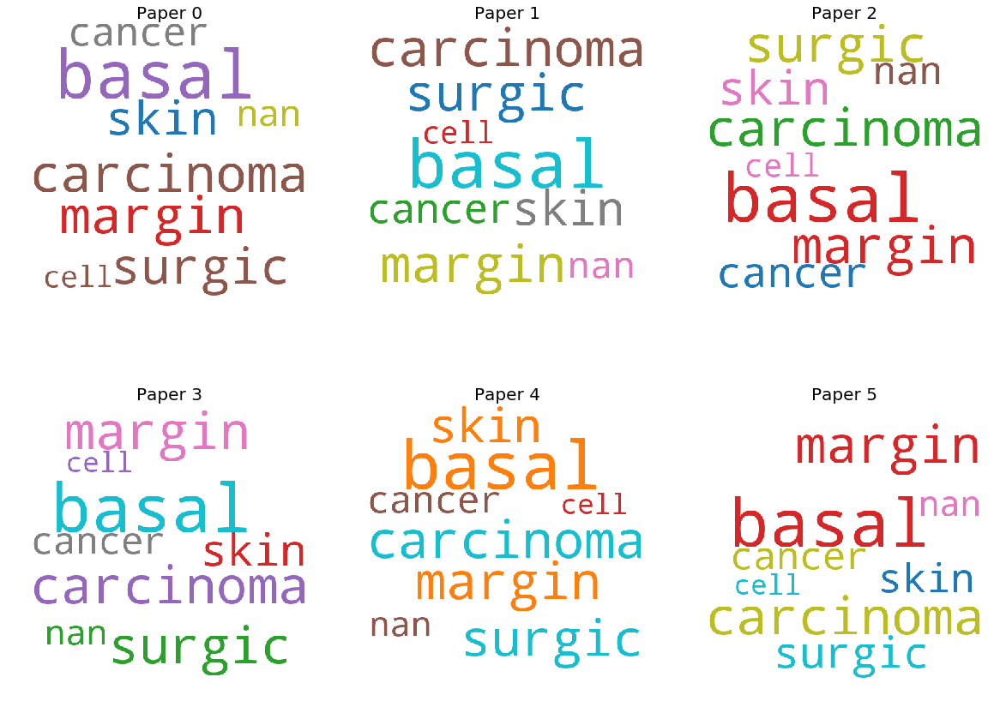

,title,doi,pmcid,pubmed_id,authors
0,"NTD policy priorities: Science, values, and ag...",10.1371/journal.pntd.0005431,PMC5436631,2.85451e+07,"Iltis, Ana S.; Matthews, Kirstin R. W."
1,Public Health Systems Research: Setting a Nati...,10.2105/AJPH.2004.046037,PMC1470524,,"Lenaway, Dennis; Halverson, Paul; Sotnikov, Se..."
2,Health Inequalities and Infectious Disease Epi...,10.1089/bsp.2014.0032,PMC4170985,,"Quinn, Sandra Crouse; Kumar, Supriya"
3,Leveraging the Laboratory Response Network Mod...,10.1089/bsp.2014.0039,PMC4171117,,"Mangal, Chris N.; Maryogo-Robinson, Lucy"
4,Global health in the European Union – a review...,10.3402/gha.v7.23610,PMC3925807,2.45603e+07,"Aluttis, Christoph; Krafft, Thomas; Brand, Helmut"
5,Urgent research agenda for the novel coronavir...,10.3760/cma.j.issn.0254-6450.2020.02.001,,3.20267e+07,"Strategy; Policy Working Group for, Ncip Epide..."


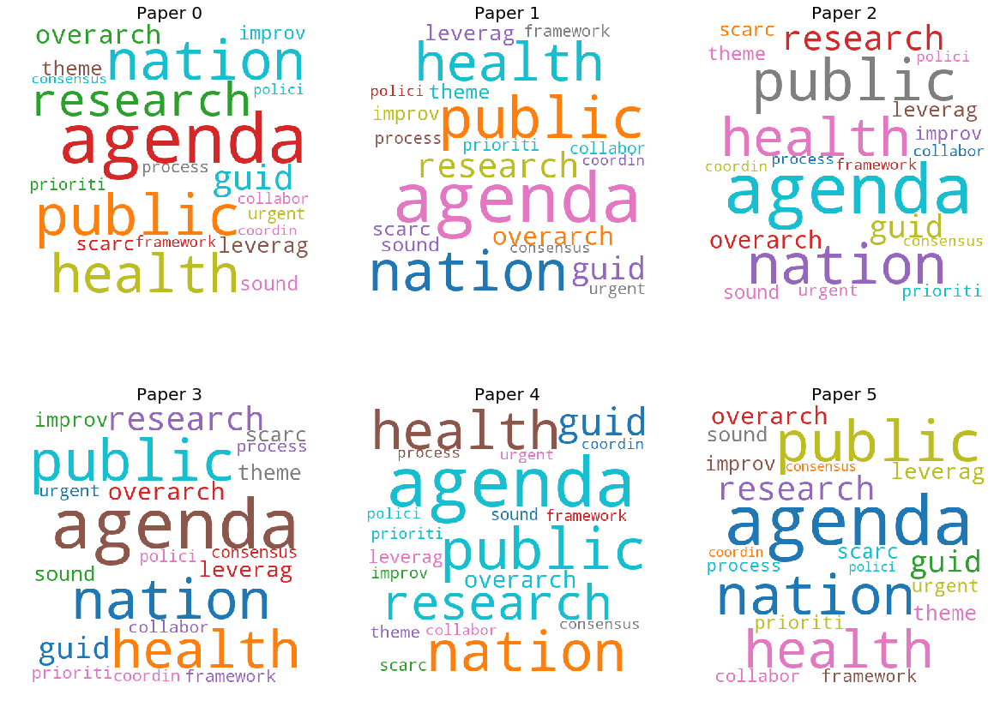

,title,doi,pmcid,pubmed_id,authors
0,Cancer patients in SARS-CoV-2 infection: a nat...,10.1016/S1470-2045(20)30096-6,,3.20665e+07,"Liang, Wenhua; Guan, Weijie; Chen, Ruchong; Wa..."
1,COVID-19 – the role of mass gatherings,10.1016/j.tmaid.2020.101617,,,"Ebrahim, Shahul H.; Memish, Ziad A."
2,COVID-19: what is next for public health?,10.1016/S0140-6736(20)30374-3,,3.20613e+07,"Heymann, David L; Shindo, Nahoko"
3,COVID-19 Update – March 2020,,,,"Learning, JAMA JN"
4,Straining the System: Novel Coronavirus (COVID...,10.2105/AJPH.2020.305618,,3.20534e+07,"Smith, Nathaniel; Fraser, Michael"
5,COVID-19 Update – March 2020 | Global Health |...,,,,JAMA


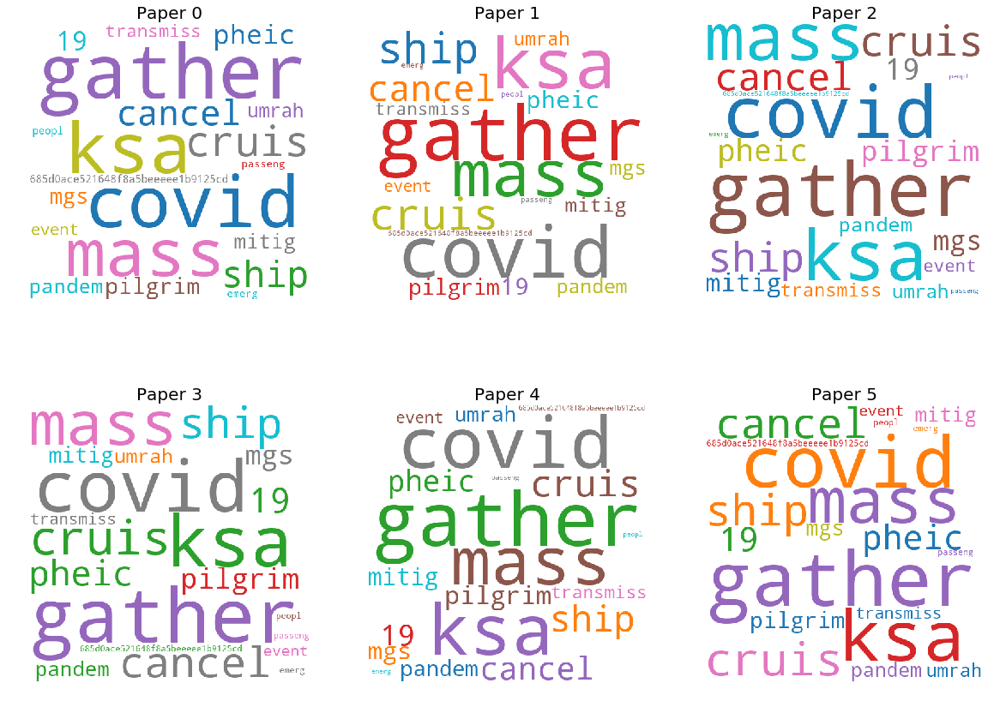

,title,doi,pmcid,pubmed_id,authors
0,"A Snapshot of Influenza Surveillance, Vaccine ...",10.5001/omj.2018.54,PMC6047181,,"Al Awaidy, Salah; Althaqafi, Abdulhakim; Dbaib..."
1,Annual influenza vaccination: coverage and att...,10.1111/j.1750-2659.2010.00158.x,PMC4942009,2.13066e+07,"Ward, Kirsten; Seale, Holly; Zwar, Nicholas; L..."
2,Evolution of information-driven HIV/AIDS polic...,10.1093/ije/dyq217,PMC2992621,2.1113e+07,"Sun, Xinhua; Lu, Fan; Wu, Zunyou; Poundstone, ..."
3,Mandating influenza vaccinations for health ca...,10.1186/s12913-016-1772-0,PMC5041441,2.76829e+07,"Jackson-Lee, Angela; Barr, Neil G.; Randall, G..."
4,Major Infection Events Over 5 Years: How Is Me...,10.2196/jmir.2146,PMC3713905,2.38564e+07,"Kostkova, Patty; Fowler, David; Wiseman, Sue; ..."
5,What is ahead for health policy and technology...,10.1016/j.hlpt.2020.02.003,,,"Singer, Donald R.J.; Redekop, Ken"


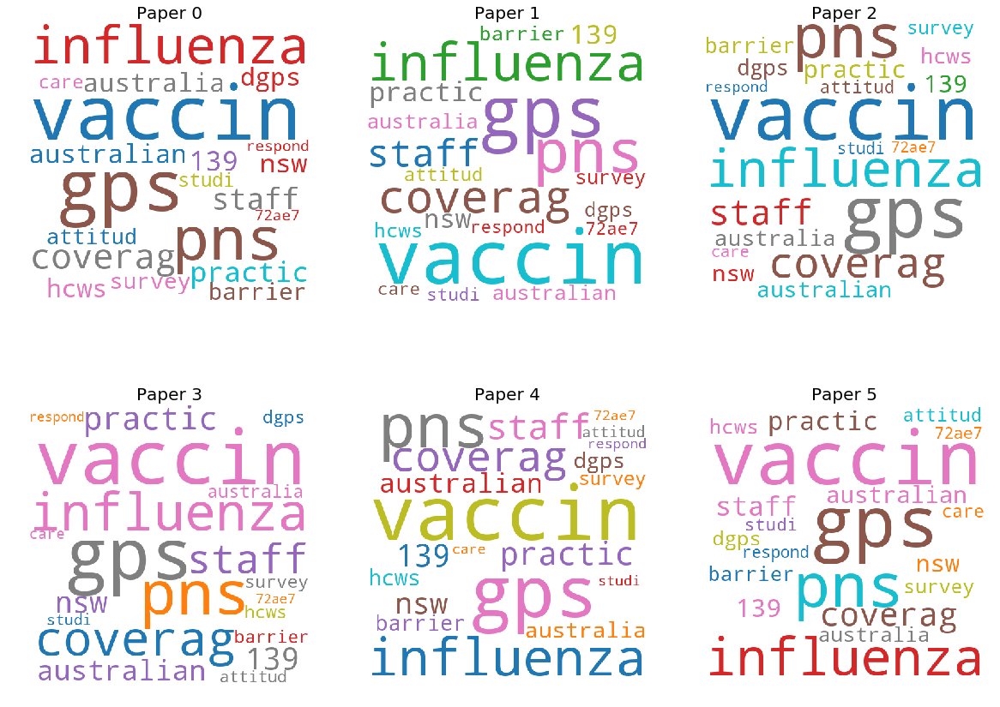

In [18]:
display_topics_results("What has been published about information sharing and inter-sectoral collaboration?")

# What has been published about ethical and social science considerations?

,title,doi,pmcid,pubmed_id,authors
0,A report of clinical diagnosis and treatment o...,10.1002/jmv.25755,,,"Chen, Qing; Quan, Bin; Li, Xiaoning; Gao, Guan..."
1,The SARS-CoV-2 Vaccine Pipeline: an Overview,10.1007/s40475-020-00201-6,,,"Chen, Wen-Hsiang; Strych, Ulrich; Hotez, Peter..."
2,THREE NOTICEABLE ISSUES ON NOVEL CORONAVIRUS: ...,10.33546/bnj.1058,,,"Tuyen, Le Thi Thanh"
3,Science in the fight against the novel coronav...,10.1097/CM9.0000000000000777,,3.21186e+07,"Wang, Jian-Wei; Cao, Bin; Wang, Chen"
4,[Advances in the research of mechanism of pulm...,10.3760/cma.j.cn501120-20200307-00132,,,"Wang, J.; Wang, B. J.; Yang, J. C.; Wang, M. Y..."
5,Consensus on standardized diagnosis and treatm...,,,,"FANG, Zhong; HE, Baorong; HAO, Dingjun; LI, Fe..."


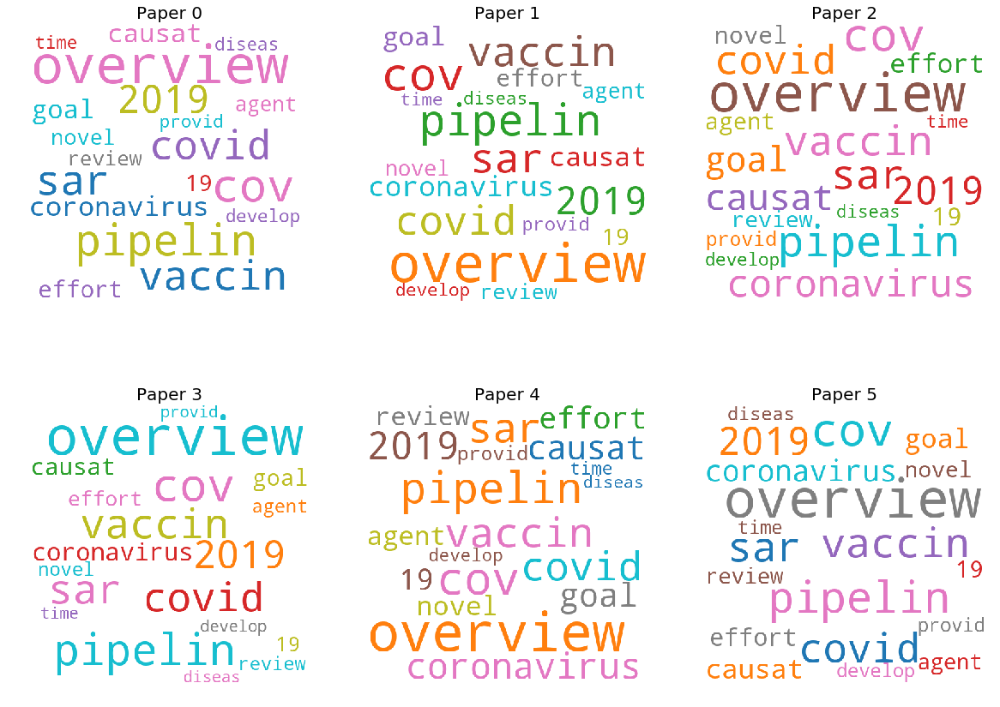

,title,doi,pmcid,pubmed_id,authors
0,Ethics-sensitivity of the Ghana national integ...,10.1186/s12910-015-0025-9,PMC4427965,2.59474e+07,"Laar, Amos; DeBruin, Debra"
1,Key Ethical Issues Discussed at CDC-Sponsored ...,10.15171/ijhpm.2016.55,PMC5088725,2.78014e+07,"Lor, Aun; Thomas, James C.; Barrett, Drue H.; ..."
2,"Chapter 20 Ethics, Legality, and Education in ...",10.1016/B978-0-12-416595-3.00023-2,,,"Thirumalaikolundusubramanian, Ponniah; Meenaks..."
3,Conducting Research in Disease Outbreaks,10.1371/journal.pntd.0000335,PMC2669128,1.93992e+07,"Macklin, Ruth; Cowan, Ethan"
4,Herbal medicine research and global health: an...,10.2471/BLT.07.042820,PMC2649468,,"Tilburt, Jon C; Kaptchuk, Ted J"
5,Ethics and SARS: lessons from Toronto,,PMC286332,,"Singer, Peter A; Benatar, Solomon R; Bernstein..."


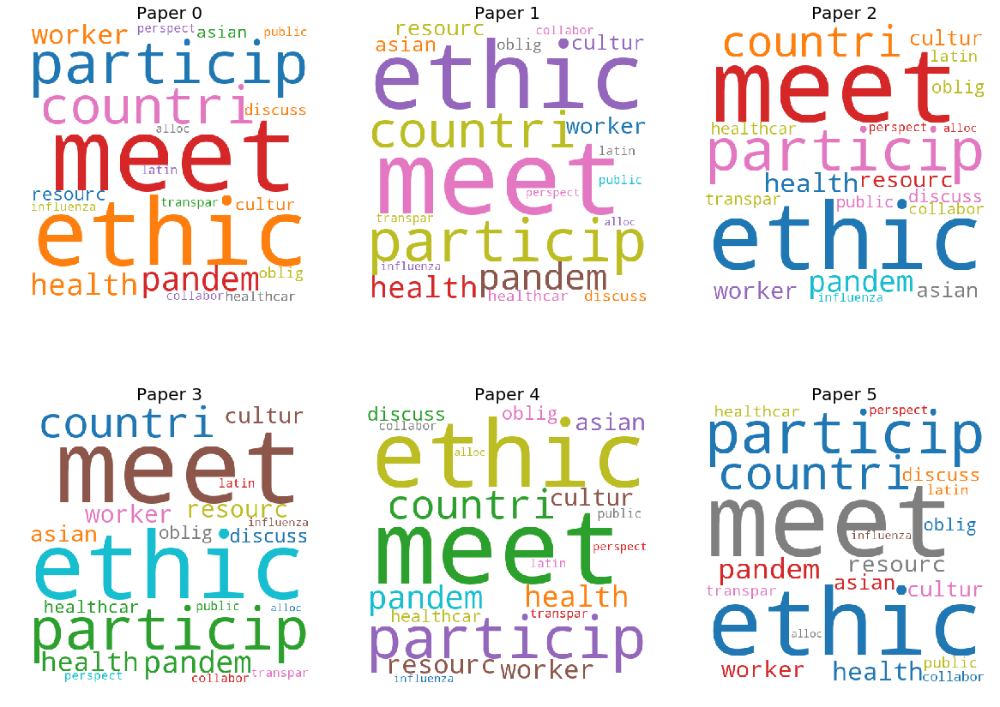

,title,doi,pmcid,pubmed_id,authors
0,Capacity building in health care professions w...,10.1186/s12909-019-1513-2,PMC6417223,3.08715e+07,"Sheikh, Javaid I.; Cheema, Sohaila; Chaabna, K..."
1,Regionalization in Local Public Health Systems...,,PMC2430640,,"Stoto, Michael A."
2,Assessing health systems in Guinea for prevent...,10.1016/j.onehlt.2019.100093,PMC6479159,3.10494e+07,"Standley, Claire J.; Carlin, Ellen P.; Sorrell..."
3,Building and Sustaining a Regional Health Rese...,,PMC4375250,,"MONTOYA, Jaime C."
4,Optimal Decision Model for Sustainable Hospita...,10.3390/ijerph13070630,PMC4962171,2.7348e+07,"Juan, Yi-Kai; Cheng, Yu-Ching; Perng, Yeng-Hor..."
5,"Chapter 20 Ethics, Legality, and Education in ...",10.1016/B978-0-12-416595-3.00023-2,,,"Thirumalaikolundusubramanian, Ponniah; Meenaks..."


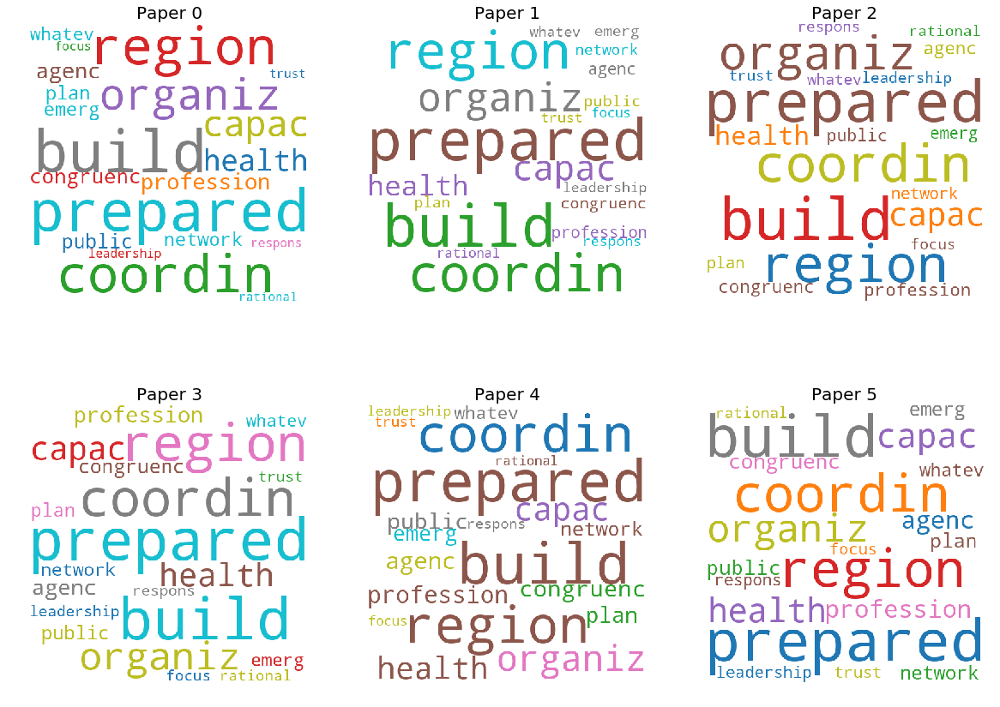

,title,doi,pmcid,pubmed_id,authors
0,A disconnected policy network: The UK's respon...,10.1016/j.socscimed.2020.112851,,,"Georgalakis, James"
1,Factors that enable effective One Health colla...,10.1371/journal.pone.0224660,PMC6892547,3.18006e+07,"Errecaborde, Kaylee Myhre; Macy, Katelyn Wuebb..."
2,Scientific Collaborations: How Do We Measure t...,10.3389/fpubh.2016.00009,PMC4753292,2.69133e+07,"Fair, Jeanne M.; Stokes, Martha Mangum; Pennin..."
3,Complexity theory and geographies of health: a...,10.1016/j.socscimed.2004.11.002,,1.58206e+07,"Gatrell, Anthony C."
4,Is there really such a thing as “one health”? ...,10.1016/j.socscimed.2014.06.018,,,"Wolf, Meike"
5,Using Problem-based Learning for Pandemic Prep...,10.1016/S1607-551X(08)70093-7,,1.83643e+07,"Marshall, Carrie S.; Yamada, Seiji; Inada, Meg..."


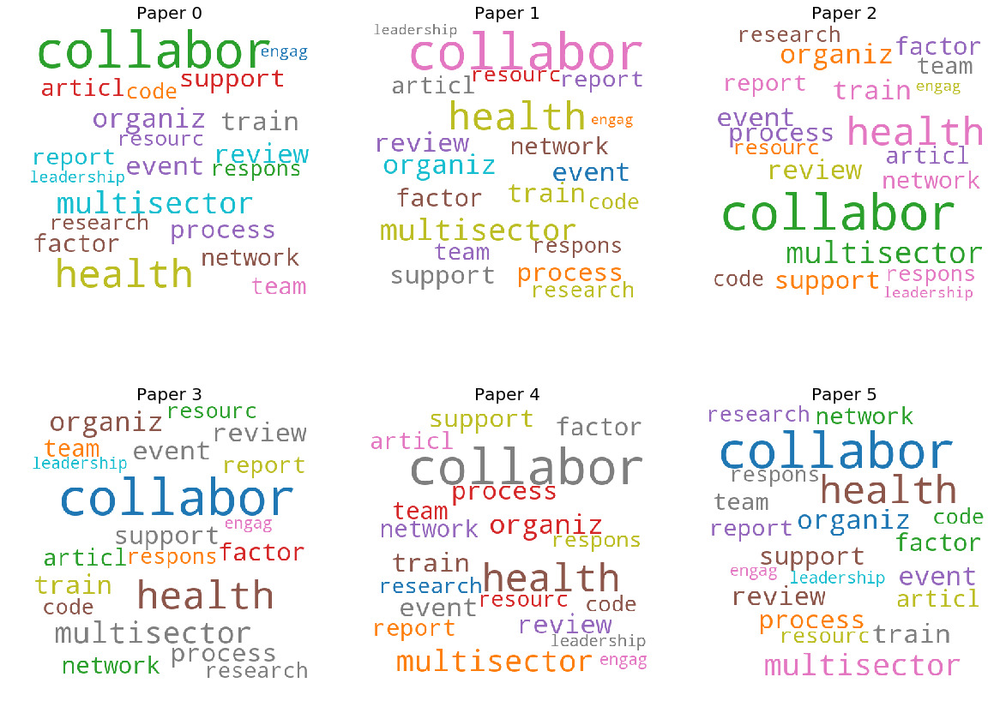

,title,doi,pmcid,pubmed_id,authors
0,The use of equine influenza pseudotypes for se...,,PMC3601075,2.35152e+07,"Scott, Simon; Molesti, Eleonora; Temperton, Ni..."
1,Nonpharmaceutical Interventions for Pandemic I...,10.3201/eid1201.051371,PMC3291415,1.64947e+07,
2,Non-pharmaceutical public health interventions...,10.1186/1471-2458-7-208,PMC2040158,1.76974e+07,"Aledort, Julia E; Lurie, Nicole; Wasserman, Je..."
3,Single-radial-haemolysis test for diagnosing f...,,PMC2490953,,"George, Samuel; Pavri, Khorshed"
4,Reflections on Pandemic (H1N1) 2009 and the In...,10.1371/journal.pmed.1000346,PMC2950129,2.09572e+07,"Leung, Gabriel M.; Nicoll, Angus"
5,"Chapter 82 Chemical, Biological, Radiological,...",10.1016/B978-0-323-28665-7.00082-0,,,"Race, Jeffrey D.; Nichols, Carey; Blumenthal, ..."


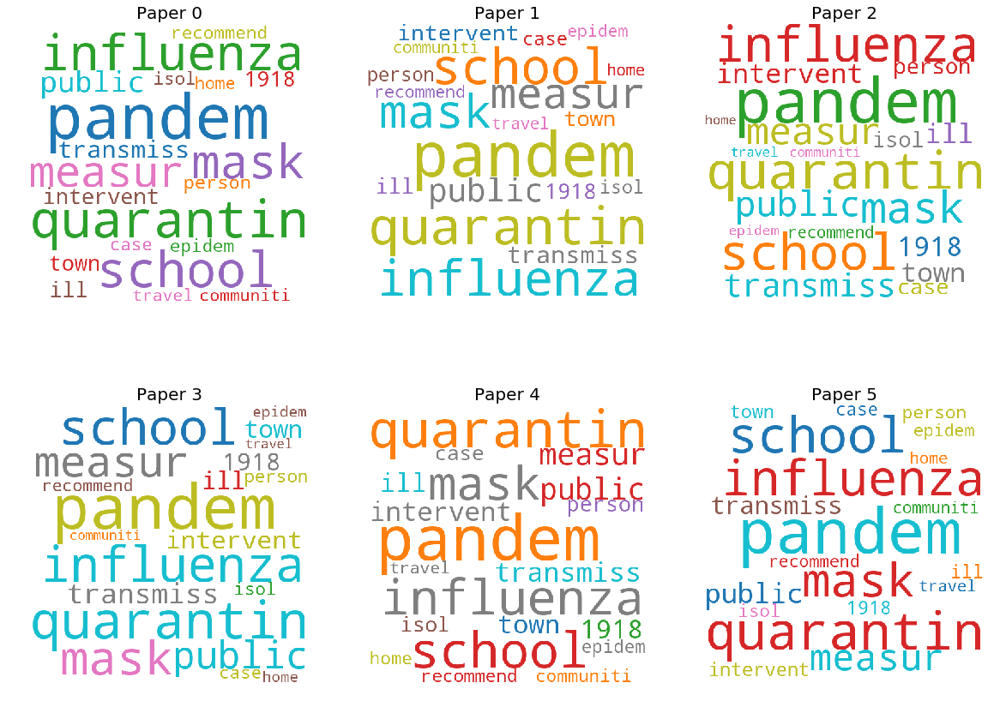

,title,doi,pmcid,pubmed_id,authors
0,Immediate Psychological Responses and Associat...,10.3390/ijerph17051729,,,"Wang, Cuiyan; Pan, Riyu; Wan, Xiaoyang; Tan, Y..."
1,The Emotional Impact Of Coronavirus 2019-Ncov ...,10.1016/j.psychres.2020.112915,,,"Lima, Carlos Kennedy Tavares; Carvalho, Polian..."
2,Preparing for a Surge of Coronavirus Cases,10.1016/j.jcjq.2020.03.001,,,"Baker, David W."
3,Mental Health Care Measures in Response to the...,10.30773/pi.2020.0058,PMC7047003,3.20935e+07,"Park, Seon-Cheol; Park, Yong Chon"
4,Online mental health services in China during ...,10.1016/S2215-0366(20)30077-8,,,"Liu, Shuai; Yang, Lulu; Zhang, Chenxi; Xiang, ..."
5,Update: Public Health Response to the Coronavi...,10.15585/mmwr.mm6908e1,,3.21062e+07,"Jernigan, D. B."


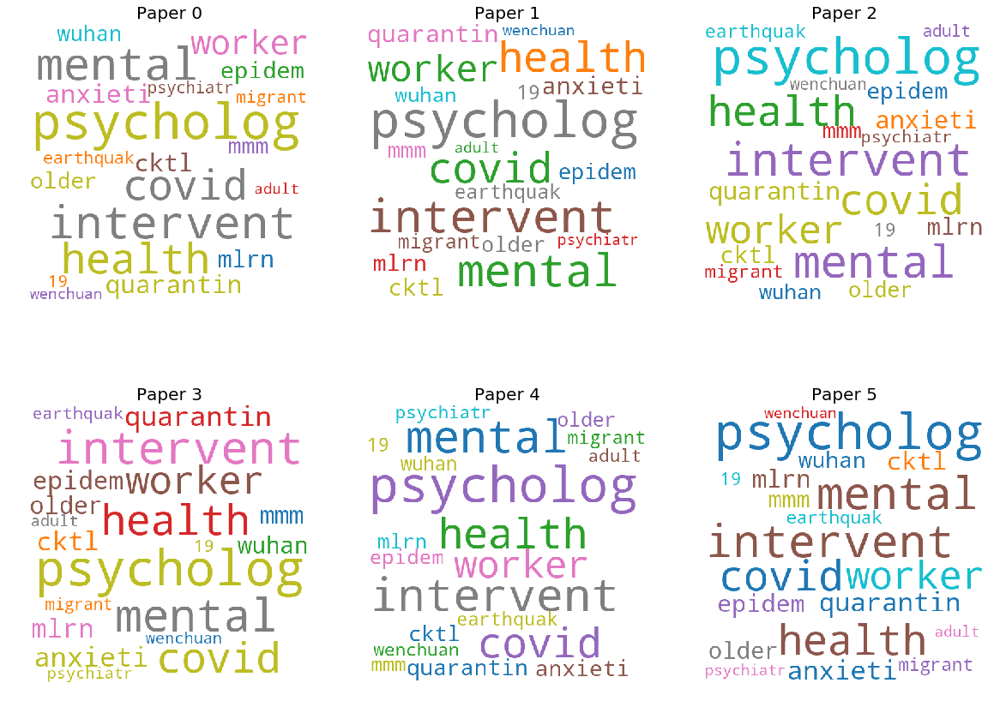

,title,doi,pmcid,pubmed_id,authors
0,Fear can be more harmful than the severe acute...,10.12998/wjcc.v8.i4.652,PMC7052559,3.2149e+07,"Ren, Shi-Yan; Gao, Rong-Ding; Chen, Ye-Lin"
1,Social Media's Initial Reaction to Information...,,PMC4869079,,"Fung, Isaac Chun-Hai; Fu, King-Wa; Chan, Chung..."
2,In Case You Haven't Heard…,10.1002/adaw.32661,,,
3,Scientists ‘strongly condemn’ rumors and consp...,,,,"Cohen, Jon"
4,How to fight an infodemic,10.1016/S0140-6736(20)30461-X,,3.21135e+07,"Zarocostas, John"
5,What does “crisis” education look like?,10.1080/10382046.2020.1730095,,,"Kidman, Gillian; Chang, Chew-Hung"


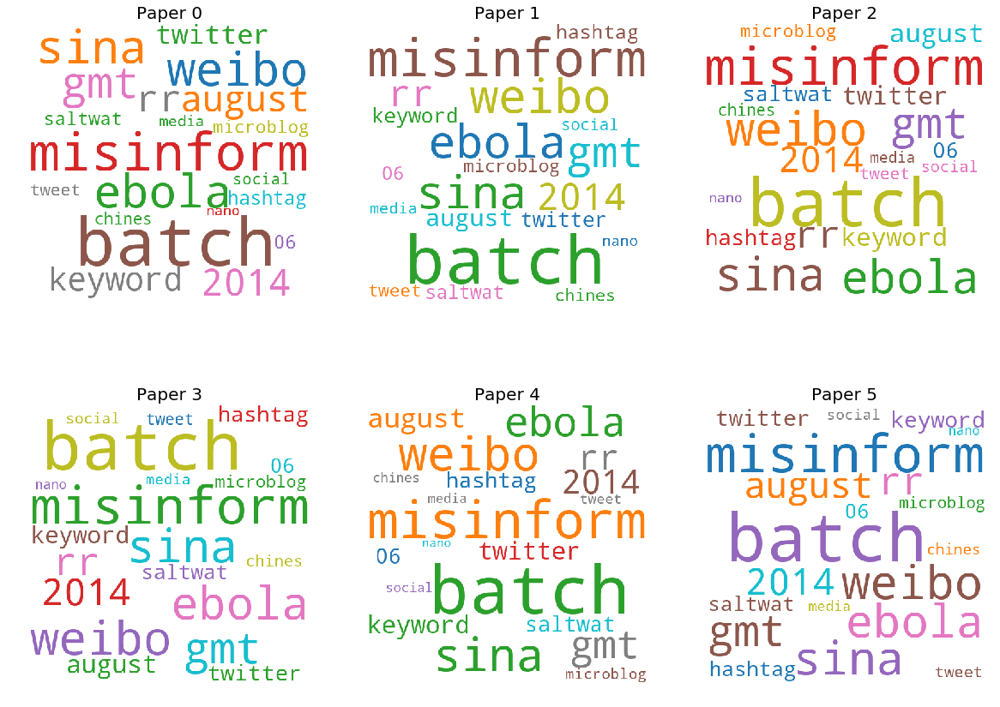

In [19]:
display_topics_results("What has been published about ethical and social science considerations?")

# Search friendly widget
it is not working in preview version, there are som results below.

In [20]:
def search():
    def document_change(event):
        if not (event['type'] == 'change' and event['name'] == 'value'):
            return
        render_tab(result_tab, results.iloc[doc_select.index])

    def render_tab(tab, r):
        paper_info = widgets.VBox([widgets.Label(f"{x} : {r[x]}") for x in dict(r) if x != "word_vector"])
        keywords = widgets.Output()
        with keywords:
            plt.show(show_word_cloud(r.word_vector ))
        similiar_doc = widgets.Label("TODO")
        tab.children = [paper_info, keywords, similiar_doc]
        tab.set_title(0, "Paper info")
        tab.set_title(1, "Keywords")
        tab.set_title(2, "Similiar documents")

    def run_search(b):
        global results
        if not search_text.value:
            print("text cant be empty")
        else:
            search_widgets.layout.display = 'none'
            search_in_progress.layout.display = None
            results = get_related_documents(search_text.value, number_of_ducuments.value)
            doc_select.options = [x for x in results.title]
            search_in_progress.layout.display = 'none'
            result_widgets.layout.display = None

    search_text = widgets.Text(
        value='potential risks factors Neonates and pregnant women',
        placeholder='Search text',
        description='Search for',
        disabled=False
    )

    number_of_ducuments = widgets.IntText(
        value=5,
        description='Any:',
        disabled=False
    )

    run_button = widgets.Button(
        description='Search',
        disabled=False,
        button_style='',
        tooltip='Search',
        icon='check'
    )
    run_button.on_click(run_search)
    search_widgets = widgets.VBox([search_text, number_of_ducuments, run_button])

    search_in_progress = widgets.Label("searching...")
    search_in_progress.layout.display = 'none'
    
    doc_select = widgets.Select(
        options=[],
        description='Results',
        disabled=False
    )
    doc_select.layout.width = "90%"
    doc_select.observe(document_change)
    result_tab = widgets.Tab()
    result_widgets = widgets.VBox([doc_select, result_tab])
    result_widgets.layout.display = 'none'
    return widgets.VBox([search_widgets, search_in_progress, result_widgets])
search()

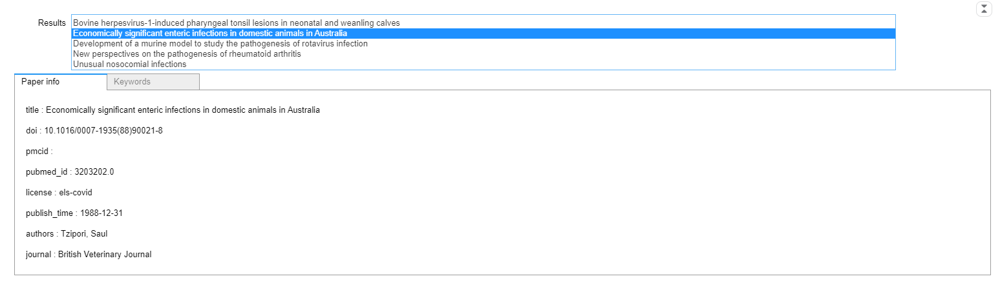

In [21]:
Image('/kaggle/input/search-results/1.PNG')

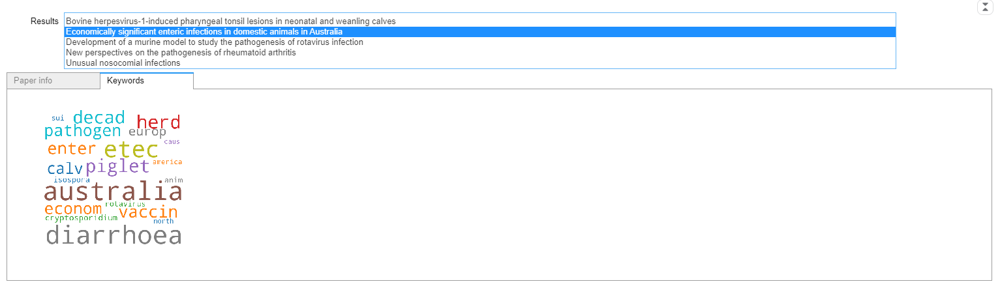

In [22]:
Image('/kaggle/input/search-results/2.PNG')